## Experiment 11
- Summing masks for each frame

In [1]:
import os 
os.chdir('../../')

In [2]:
# -*- coding: utf-8 -*-
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import math
import time
import importlib
import os
import argparse
import copy
import datetime
import random
import sys
import json

import torch
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as init
import torch.utils.model_zoo as model_zoo
from torchvision import models
import torch.multiprocessing as mp
from torchvision import transforms

# My libs
from core.utils import Stack, ToTorchFormatTensor
import xarray as xr

from ssh_scripts.plot_maps import plot
from cartopy import crs as ccrs

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
%matplotlib inline
plt.rcParams ['figure.figsize']  = 25, 10
plt.rcParams ['axes.labelsize']  = 14
plt.rcParams ['xtick.labelsize'] = 12
plt.rcParams ['ytick.labelsize'] = 12
plt.rcParams ['text.color']      = 'black'
plt.rcParams ['axes.labelcolor'] = 'black'
plt.rcParams ['xtick.color']     = 'black'
plt.rcParams ['ytick.color']     = 'black'
# plt.style.use('fivethirtyeight')


In [5]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [6]:
experiment = 11
path = f'Experiments/Experiment{experiment}/'
video = path + 'examples/'
mask = path + 'ssh_examples/'
ckpt = 'checkpoints/sttn.pth'
model = 'sttn'

In [7]:

w, h = 192, 192
# w, h = 432, 240
ref_length = 10
neighbor_stride = 5
default_fps = 24

_to_tensors = transforms.Compose([
    Stack(),
    ToTorchFormatTensor()])


# sample reference frames from the whole video 
def get_ref_index(neighbor_ids, length):
    ref_index = []
    for i in range(0, length, ref_length):
        if not i in neighbor_ids:
            ref_index.append(i)
    return ref_index


# read frame-wise masks 
def read_mask(mpath):
    masks = []
    mnames = os.listdir(mpath)
    mnames.sort()
    for m in mnames: 
        if 'ipynb' not in m:
            m = Image.open(os.path.join(mpath, m))
            m = m.resize((w, h), Image.NEAREST)
            m = np.array(m.convert('L'))
            m = np.array(m > 0).astype(np.uint8)
#             m = cv2.dilate(m, cv2.getStructuringElement(
#                 cv2.MORPH_CROSS, (3, 3)), iterations=4)
            masks.append(Image.fromarray(m*255))
    return masks


#  read frames from video 
def read_frame_from_videos(vname):
    frames = []
    vidcap = cv2.VideoCapture(vname)
    success, image = vidcap.read()
    count = 0
    while success:
        image = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        frames.append(image.resize((w,h)))
        success, image = vidcap.read()
        count += 1
    return frames       
#New
def get_ssh_gt():
    dataset_path = '/mnt/groupadiag302/Transformers/Project_UEH_data/datasets/' #'../datasets/'
    ref_path = dataset_path + 'ref.nc'
    xgt = xr.open_dataset(ref_path)
    gt = xgt['ssh'].values
    gt = gt[:,5:197,5:197]
    
    maxx = gt.max()
    minn = gt.min()
    transformed_ssh = (gt-minn)/(maxx-minn) # à revoir
    # transformed_ssh =  transformed_ssh[..., np.newaxis]
    transformed_ssh = np.stack((transformed_ssh,)*3, axis=1)

    # ssh_frames = [Image.fromarray(cv2.cvtColor(transformed_ssh[i], cv2.COLOR_BGR2RGB)) for i in range(len(transformed_ssh))]
    
    return gt, torch.tensor(transformed_ssh), [transformed_ssh[i].transpose(1,2,0)*255 for i in range(len(transformed_ssh))],(maxx,minn), gt

def get_ssh_masks():
    pass


In [8]:
# set up models 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
net = importlib.import_module('model.' + model)
model = net.InpaintGenerator().to(device)
model_path = ckpt
data = torch.load(ckpt, map_location=device)
model.load_state_dict(data['netG'])
print('loading from: {}'.format(ckpt))
model.eval()

loading from: checkpoints/sttn.pth


InpaintGenerator(
  (transformer): Sequential(
    (0): TransformerBlock(
      (attention): MultiHeadedAttention(
        (query_embedding): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
        (value_embedding): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
        (key_embedding): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
        (output_linear): Sequential(
          (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): LeakyReLU(negative_slope=0.2, inplace=True)
        )
        (attention): Attention()
      )
      (feed_forward): FeedForward(
        (conv): Sequential(
          (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2), dilation=(2, 2))
          (1): LeakyReLU(negative_slope=0.2, inplace=True)
          (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (3): LeakyReLU(negative_slope=0.2, inplace=True)
        )
      )
    )
    (1): TransformerBlock(
     

In [9]:
gt, feats, frames, maxmin, gt = get_ssh_gt()
print('frames shape :', frames[0].shape)
feats = feats.unsqueeze(0)*2-1

frames shape : (192, 192, 3)


In [10]:
masks = read_mask(mask)

len_video = min(len(masks),len(frames))
frames = frames[:len_video]
masks  = masks[:len_video]
gt     = gt[:len_video] 
feats  = feats[:,:len_video]
video_length = len(frames)

frames = [np.array(f).astype(np.uint8) for f in frames]

binary_masks = [np.expand_dims((np.array(m) != 0).astype(np.uint8), 2) for m in masks]
masks = _to_tensors(masks).unsqueeze(0)
feats, masks = feats.to(device, dtype=torch.float), masks.to(device, dtype=torch.float)
comp_frames = [None]*video_length
comp_frames_ssh = [None]*video_length

In [11]:
masks.size()

torch.Size([1, 365, 1, 192, 192])

In [12]:
def add_neighboring_masks(masks, window=1):
    masks_resumed = masks*1
    window = 1
    for i in range(len_video):
        for w_ in range(-window, window+1):
            if len_video-1>=i+w_ >=0 :
                masks_resumed[0][i] *= masks[0][i+w_]
    return masks_resumed

In [13]:
masks = add_neighboring_masks(masks, window=1)

In [14]:
## Encoding 365 frames into 365 vectors of 256 channels and 48x48 size

In [15]:
with torch.no_grad():
    feats = model.encoder((feats*(1-masks).float()).view(video_length, 3, h, w))
    _, c, feat_h, feat_w = feats.size()
    feats = feats.view(1, video_length, c, feat_h, feat_w)

In [16]:
print('loading videos and masks from: {}'.format(video))
print('feats output :',feats.shape)

loading videos and masks from: Experiments/Experiment11/examples/
feats output : torch.Size([1, 365, 256, 48, 48])


In [17]:
gt_reshaped = gt[:,:,:,np.newaxis]
maxx, minn = maxmin

In [18]:
for f in range(0, video_length, neighbor_stride):
    neighbor_ids = [i for i in range(max(0, f-neighbor_stride), min(video_length, f+neighbor_stride+1))]
    ref_ids = get_ref_index(neighbor_ids, video_length)
    print('stride :',f)
    print('neighbord ids :',neighbor_ids)
    print('reference ids :',ref_ids)   
    print(' ')

stride : 0
neighbord ids : [0, 1, 2, 3, 4, 5]
reference ids : [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360]
 
stride : 5
neighbord ids : [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
reference ids : [20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360]
 
stride : 10
neighbord ids : [5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
reference ids : [0, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360]
 
stride : 15
neighbord ids : [10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
reference ids : [0, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360]
 
s

In [19]:
# completing holes by spatial-temporal transformers
capture_hist = []
for f in range(0, video_length, neighbor_stride):
    neighbor_ids = [i for i in range(max(0, f-neighbor_stride), min(video_length, f+neighbor_stride+1))]
    ref_ids = get_ref_index(neighbor_ids, video_length)
    with torch.no_grad():
        pred_feat = model.infer(
            feats[0, neighbor_ids+ref_ids, :, :, :], masks[0, neighbor_ids+ref_ids, :, :, :])
        pred_img = torch.tanh(model.decoder(
            pred_feat[:len(neighbor_ids), :, :, :])).detach()
        capture_hist.append(pred_img)
        pred_img = (pred_img + 1) / 2
        pred_img_cpu = pred_img.cpu()
        pred_img = pred_img_cpu.permute(0, 2, 3, 1).numpy()*255
        pred_ssh = pred_img_cpu.permute(0, 2, 3, 1).numpy().mean(axis=3) # make it gray
        pred_ssh = pred_ssh[:,:,:,np.newaxis]
        pred_ssh = pred_ssh*(maxx-minn) + minn
        
        for i in range(len(neighbor_ids)):
            idx = neighbor_ids[i]
            img = np.array(pred_img[i]).astype(
                np.uint8)*binary_masks[idx] + frames[idx] * (1-binary_masks[idx])
            img_ssh = pred_ssh[i]*binary_masks[idx] + gt_reshaped[idx] * (1-binary_masks[idx])
            
            if comp_frames[idx] is None:
                comp_frames[idx] = img
            else:
                comp_frames[idx] = comp_frames[idx].astype(
                    np.float32)*0.5 + img.astype(np.float32)*0.5
                
                
            if comp_frames_ssh[idx] is None:
                comp_frames_ssh[idx] = img_ssh
            else:
                comp_frames_ssh[idx] = comp_frames_ssh[idx].astype(
                    np.float32)*0.5 + img_ssh.astype(np.float32)*0.5

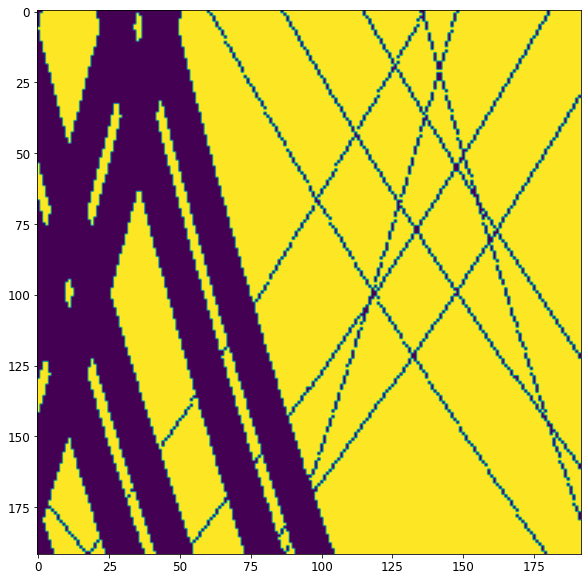

In [28]:
plt.imshow(masks[0][4][0].cpu().detach().numpy())

In [20]:
prediction_ssh = np.stack(comp_frames_ssh, axis=0)
prediction_ssh = prediction_ssh.reshape(video_length, h,w)

In [30]:
cv2.imwrite('prediction10.png',255*prediction_ssh[10])
cv2.imwrite('prediction_frame10.png',comp_frames[10])

True

In [21]:
nrmse=np.zeros(video_length)

for i in range(0,video_length):
    GT           = gt[i,:,:]
    pred         = prediction_ssh[i,:,:]
    nrmse[i]      =  np.sqrt(((GT-pred)**2).mean())/np.nanstd(GT)
    

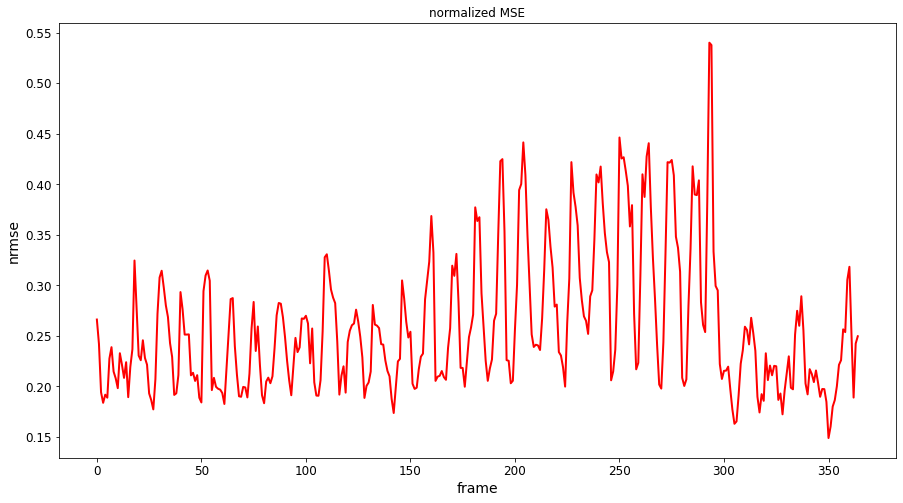

In [22]:
# plot nRMSE time series
N=len(nrmse)
plt.figure(figsize=(15,8))
plt.plot(range(N),nrmse,linestyle='solid',color='red',linewidth=2,label=r"$STTN$")
plt.title('normalized MSE')
plt.xlabel('frame')
plt.ylabel('nrmse')
plt.show()

In [23]:
nrmse.mean(), nrmse.std()

(0.26027050489060455, 0.06894659193338303)

In [19]:
# stationnary masks ->

# cacher des frames 

# utiliser nos masques sur des videos youtube ->

# reconsistuer une seule image dans une video avec nos masques

# prendre du recul et decider une stratégie

# métrique : PSD 

In [70]:
writer = cv2.VideoWriter(path+f"ssh_result_experiment{experiment}.mp4", cv2.VideoWriter_fourcc(*"mp4v"), default_fps, (w, h))
for f in range(video_length):
    comp = np.array(comp_frames[f]).astype(
        np.uint8)*binary_masks[f] + frames[f] * (1-binary_masks[f])
    writer.write(cv2.cvtColor(np.array(comp).astype(np.uint8), cv2.COLOR_BGR2RGB))
writer.release()
print('Finish in {}'.format(path+f"ssh_result_experiment{experiment}.mp4"))

Finish in Experiments/Experiment7/ssh_result_experiment7.mp4


- Lancer le modele sur nos données avec les masques de l'auteur
- enlever les frames avec un masque tres grand
- fine tuner sur differentes videos avec nos masques 
- documenter et rédiger les différentes experiences

## Visualize results

In [38]:
dataset_path = '../datasets/'
lon = xr.open_dataset(dataset_path + "ref.nc").lon.values[5:197]
lat = xr.open_dataset(dataset_path + "ref.nc").lat.values[5:197]
extent = [np.min(lon),np.max(lon),np.min(lat),np.max(lat)]

In [47]:
nrmse.argsort()

array([350, 351, 305, 306, 328, 142, 317,  27, 304, 352,  61,  80,   3,
        50, 349, 319, 353,  26, 326, 141, 128,  49,   5, 362,  72,  15,
       316, 346,  69,  68, 106, 105,  79,  93, 307,  37,   4, 116, 340,
       318, 327,  25,  38,  60, 119,   2, 329,  55,  59, 333, 348, 347,
       303, 152,  58, 270,  10, 332, 153,  71,  70,  57, 176, 224, 143,
       354, 281, 129, 269, 151, 339, 198,  83, 345, 130, 104, 343,  81,
        47, 162, 187, 199,  92, 246, 107, 321, 167, 282,  28, 299,   9,
        13,  56, 280,  82, 166, 163,  84, 140, 164, 117,  45, 323,  48,
        39,  67, 342,  73, 330,  46,   8, 131, 247, 165, 139, 300, 301,
       344, 258,  62, 154, 341, 188, 175, 174, 223,  94,  16, 302, 118,
       325, 324, 322,  78, 355,  12,  24, 298, 308, 102, 259,  14, 177,
       144,  91, 186, 197, 138,  21, 356, 196, 189, 145,   6,  23, 127,
        36, 155, 331,  20, 222, 156, 320,  11,  96, 221,  76, 315, 309,
       212, 248,  17,  85, 168,  97,   7, 209,  66, 211, 268, 21

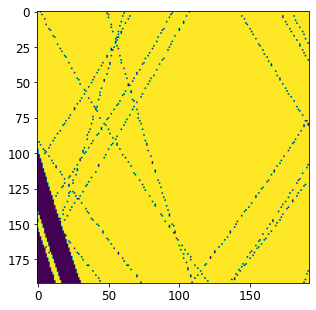

In [48]:

plt.figure(figsize=(5,5))

plt.imshow(masks[0][250][0].cpu())

---------- frame 0--------------


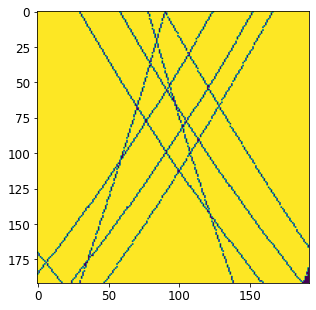

---------- frame 1--------------


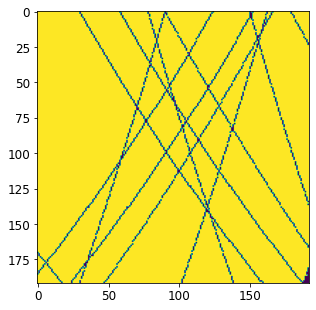

---------- frame 2--------------


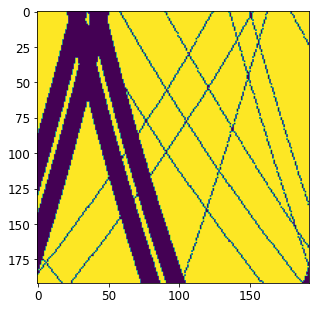

---------- frame 3--------------


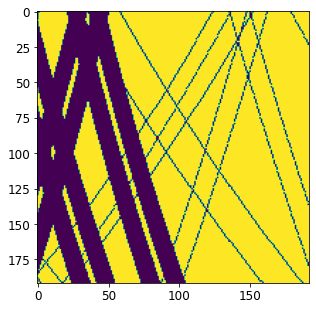

---------- frame 4--------------


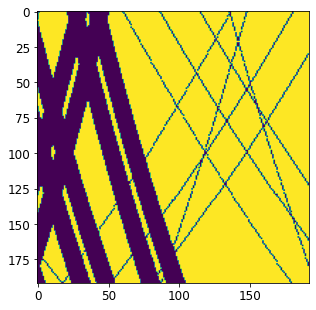

---------- frame 5--------------


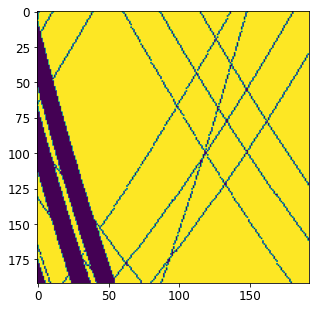

---------- frame 6--------------


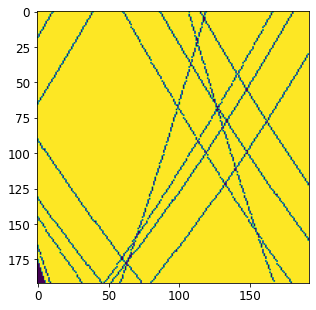

---------- frame 7--------------


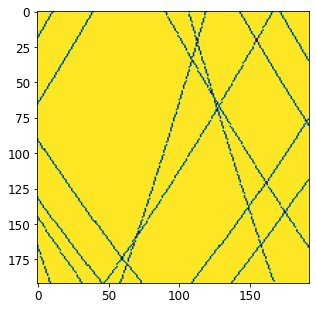

---------- frame 8--------------


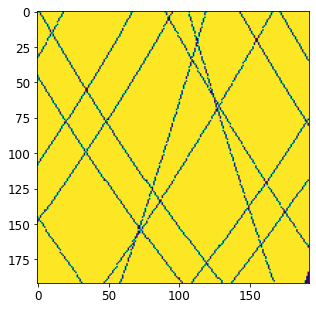

---------- frame 9--------------


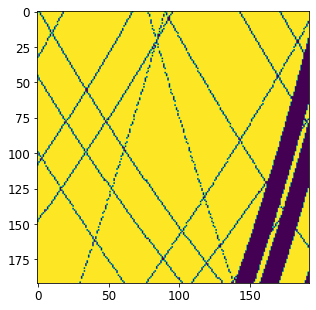

---------- frame 10--------------


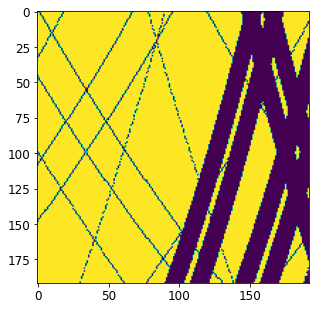

---------- frame 11--------------


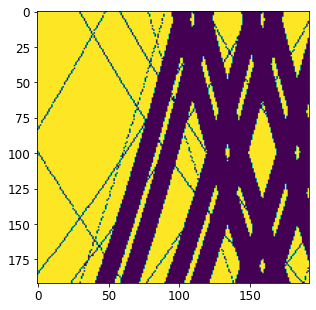

---------- frame 12--------------


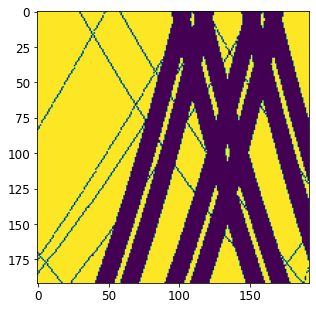

---------- frame 13--------------


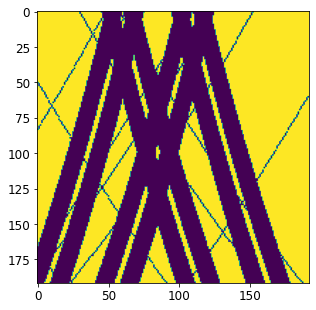

---------- frame 14--------------


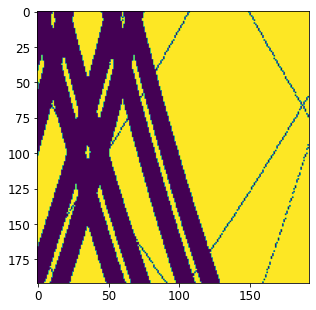

---------- frame 15--------------


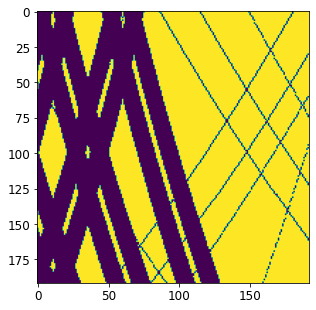

---------- frame 16--------------


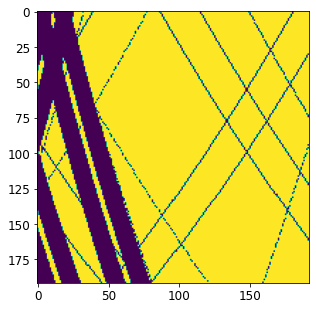

---------- frame 17--------------


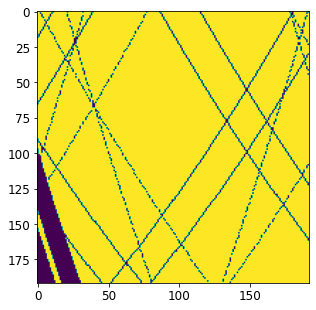

---------- frame 18--------------


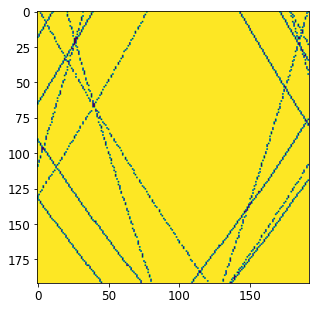

---------- frame 19--------------


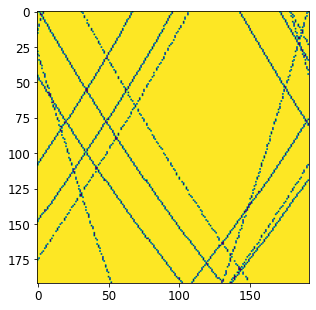

---------- frame 20--------------


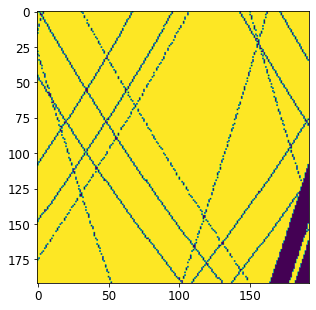

---------- frame 21--------------


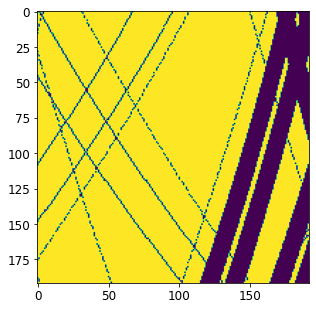

---------- frame 22--------------


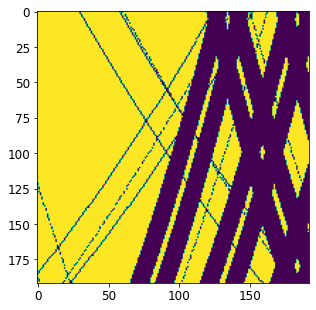

---------- frame 23--------------


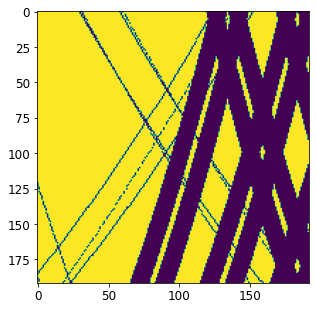

---------- frame 24--------------


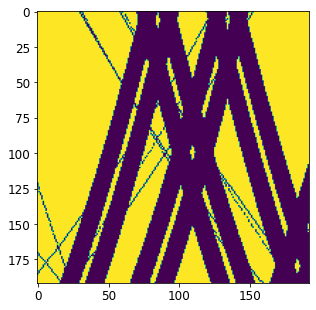

---------- frame 25--------------


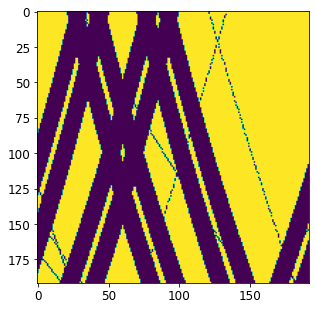

---------- frame 26--------------


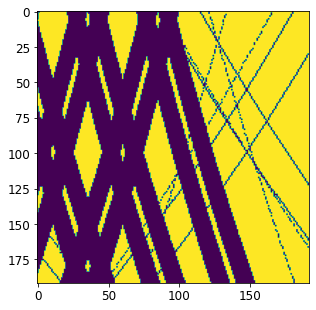

---------- frame 27--------------


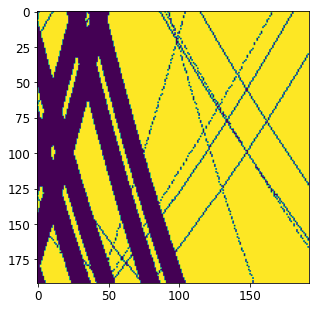

---------- frame 28--------------


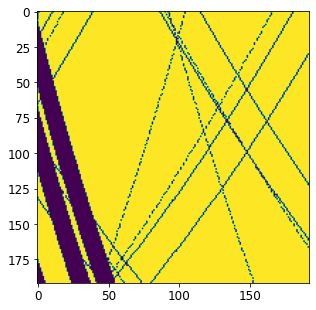

---------- frame 29--------------


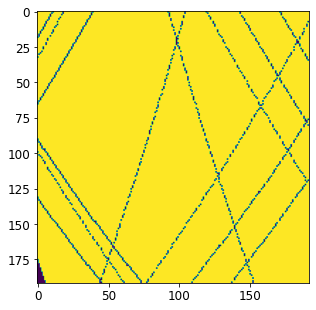

---------- frame 30--------------


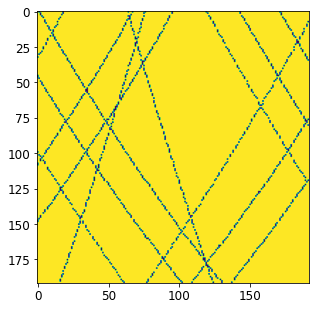

---------- frame 31--------------


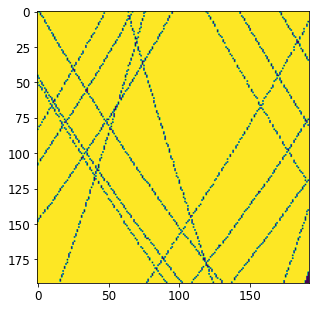

---------- frame 32--------------


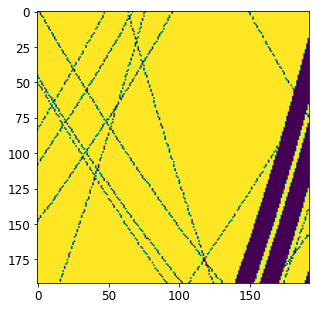

---------- frame 33--------------


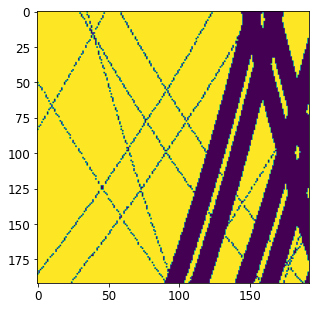

---------- frame 34--------------


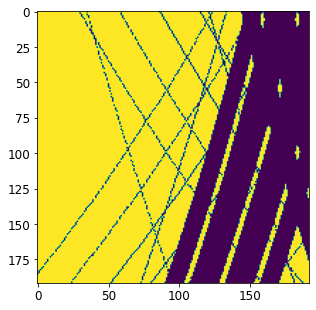

---------- frame 35--------------


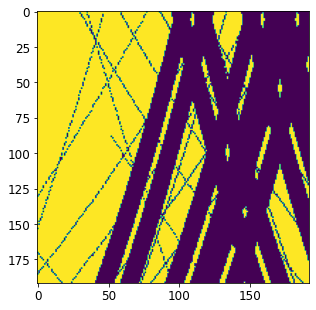

---------- frame 36--------------


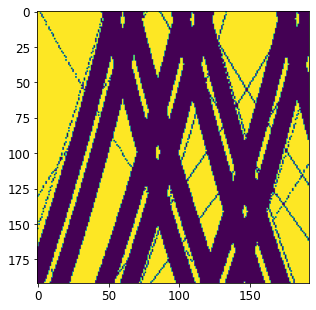

---------- frame 37--------------


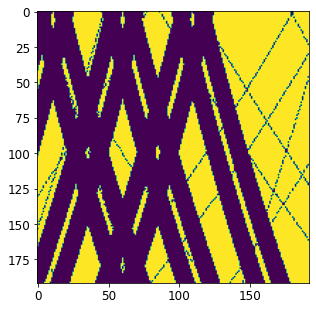

---------- frame 38--------------


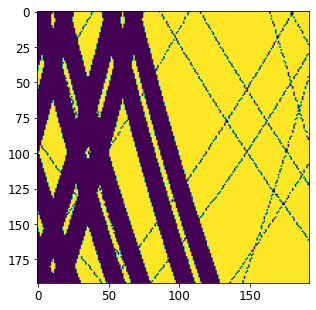

---------- frame 39--------------


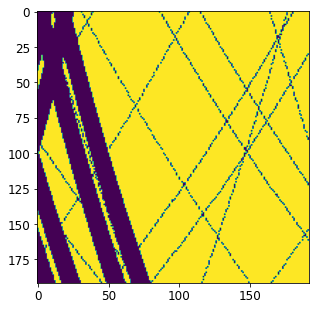

---------- frame 40--------------


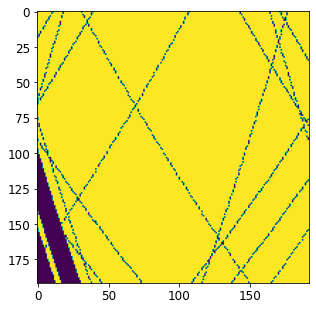

---------- frame 41--------------


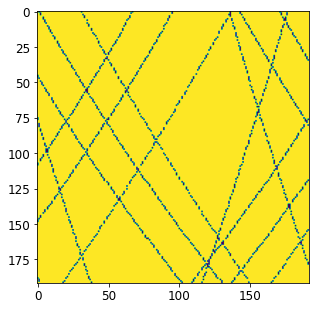

---------- frame 42--------------


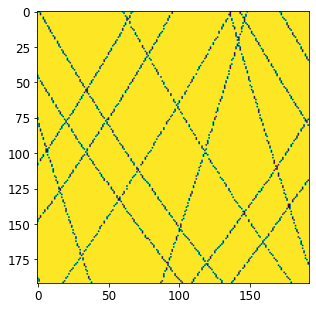

---------- frame 43--------------


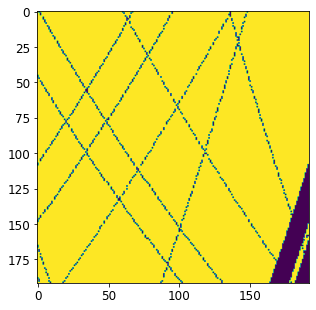

---------- frame 44--------------


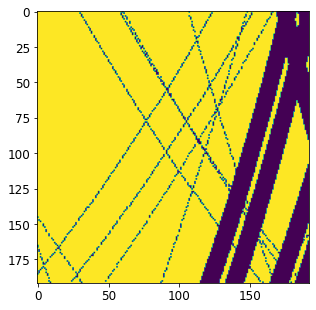

---------- frame 45--------------


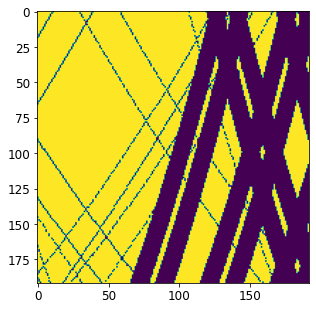

---------- frame 46--------------


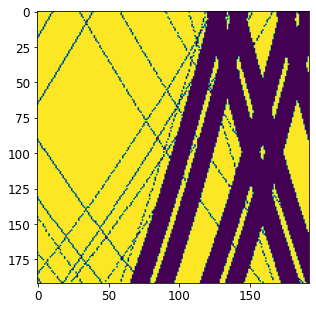

---------- frame 47--------------


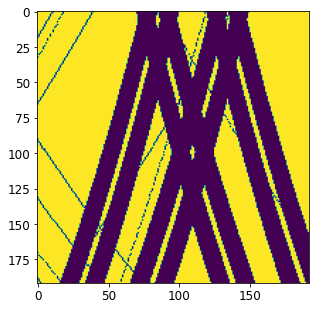

---------- frame 48--------------


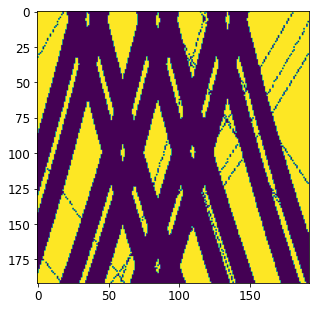

---------- frame 49--------------


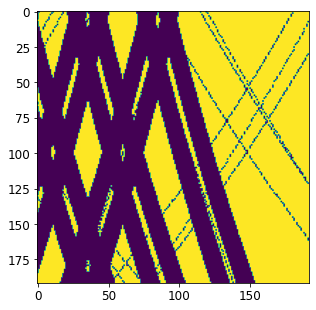

---------- frame 50--------------


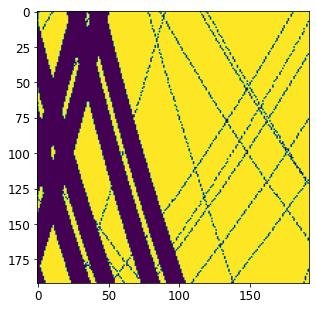

---------- frame 51--------------


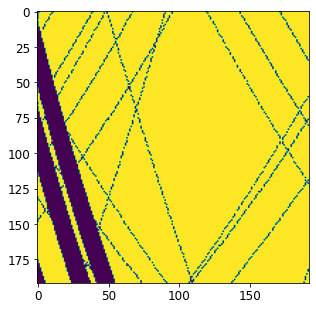

---------- frame 52--------------


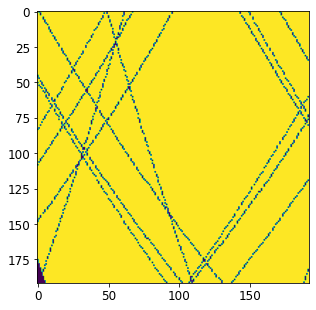

---------- frame 53--------------


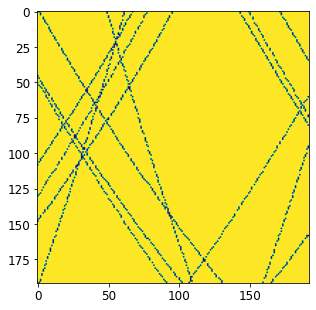

---------- frame 54--------------


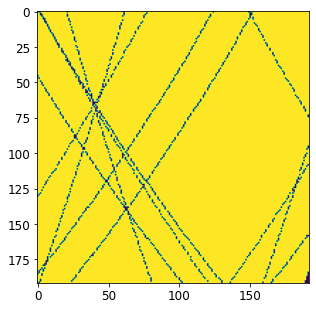

---------- frame 55--------------


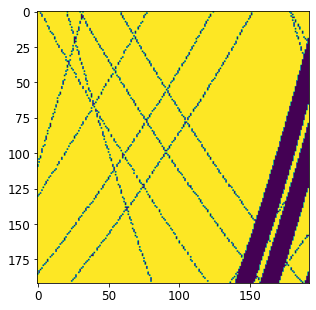

---------- frame 56--------------


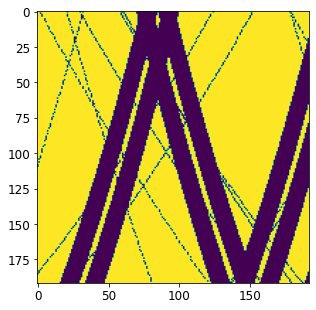

---------- frame 57--------------


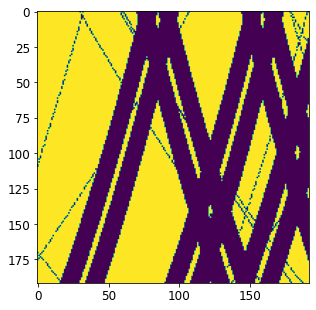

---------- frame 58--------------


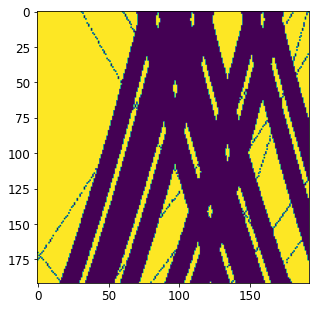

---------- frame 59--------------


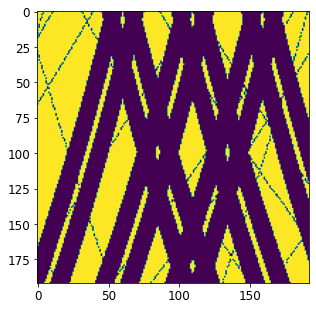

---------- frame 60--------------


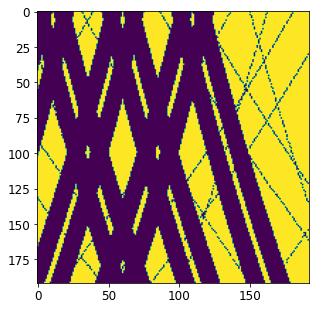

---------- frame 61--------------


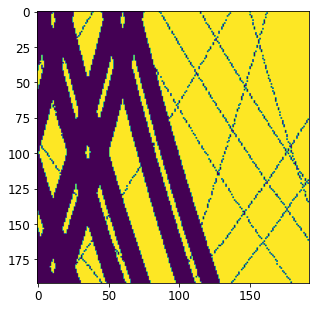

---------- frame 62--------------


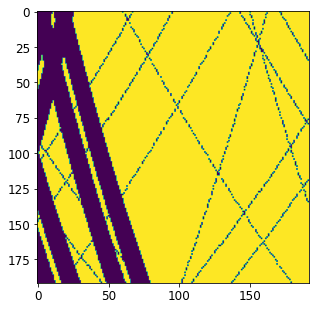

---------- frame 63--------------


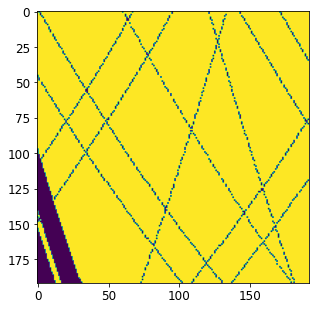

---------- frame 64--------------


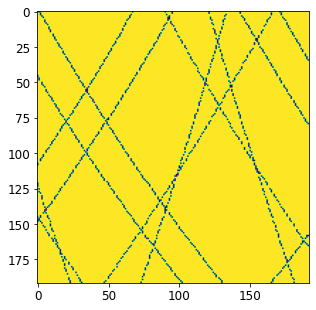

---------- frame 65--------------


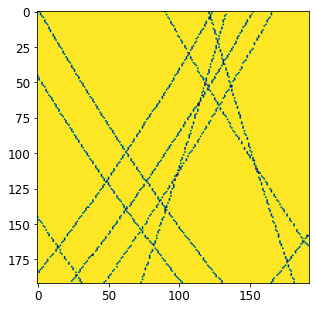

---------- frame 66--------------


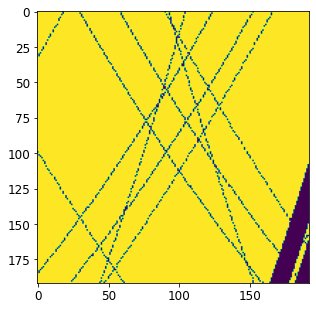

---------- frame 67--------------


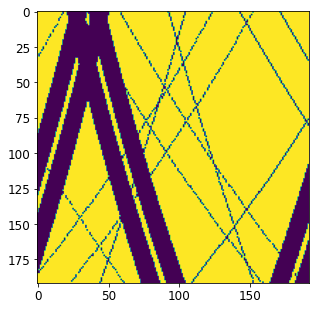

---------- frame 68--------------


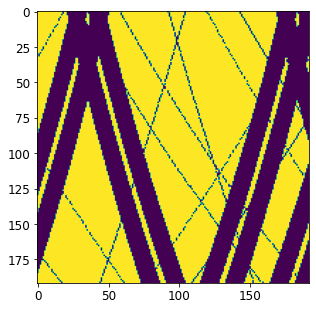

---------- frame 69--------------


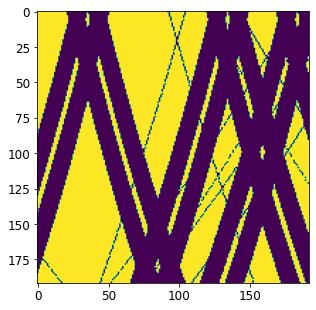

---------- frame 70--------------


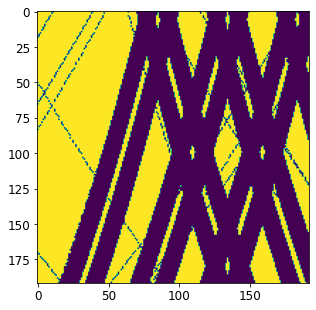

---------- frame 71--------------


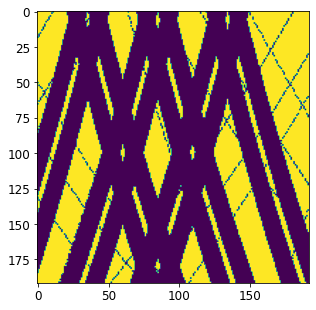

---------- frame 72--------------


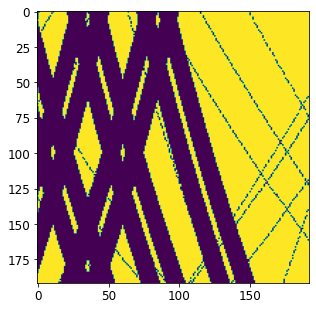

---------- frame 73--------------


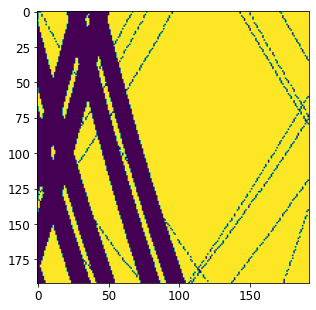

---------- frame 74--------------


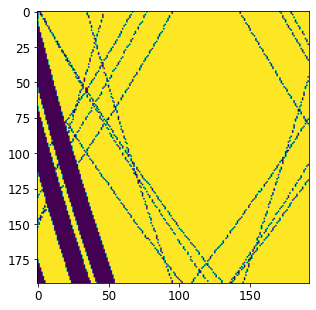

---------- frame 75--------------


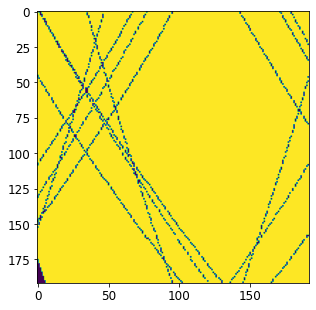

---------- frame 76--------------


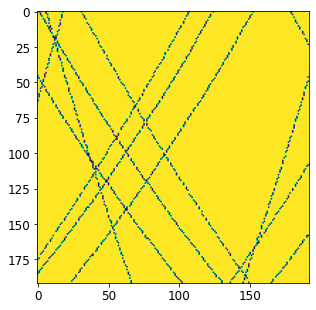

---------- frame 77--------------


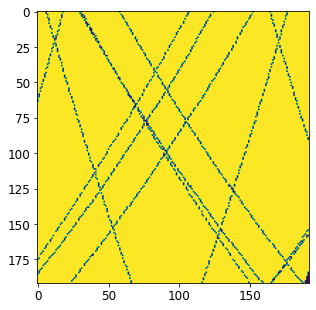

---------- frame 78--------------


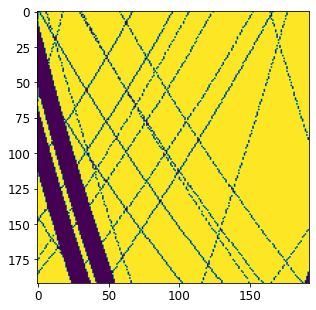

---------- frame 79--------------


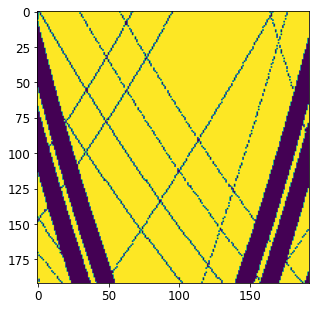

---------- frame 80--------------


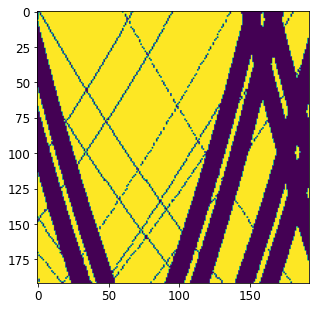

---------- frame 81--------------


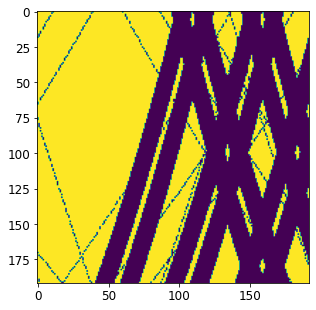

---------- frame 82--------------


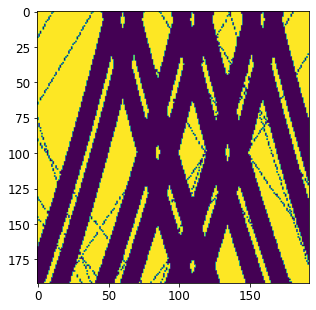

---------- frame 83--------------


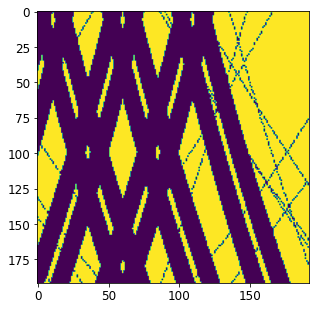

---------- frame 84--------------


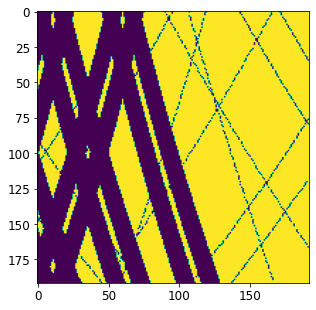

---------- frame 85--------------


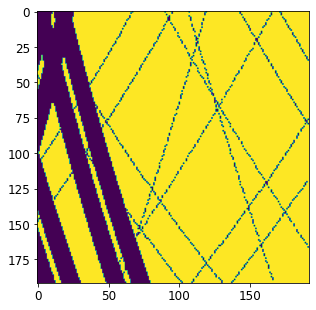

---------- frame 86--------------


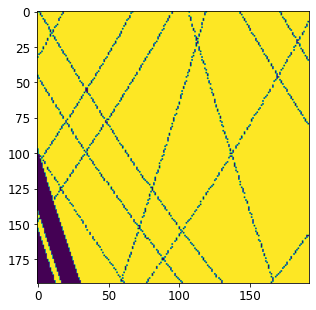

---------- frame 87--------------


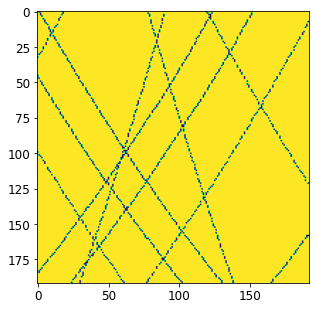

---------- frame 88--------------


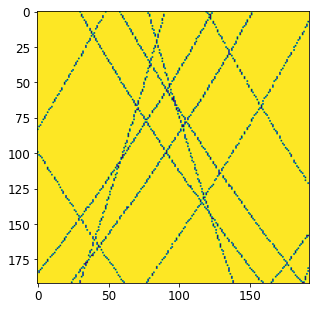

---------- frame 89--------------


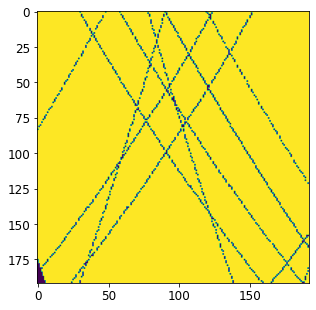

---------- frame 90--------------


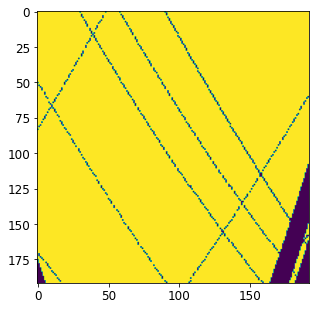

---------- frame 91--------------


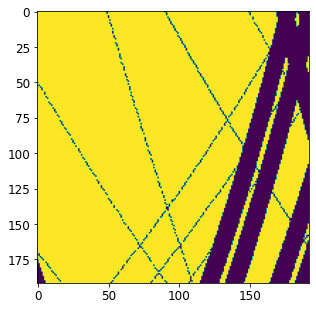

---------- frame 92--------------


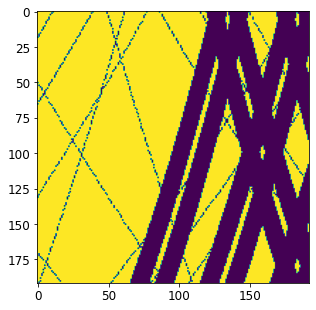

---------- frame 93--------------


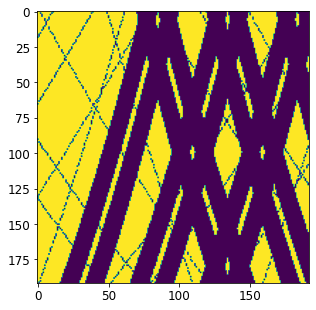

---------- frame 94--------------


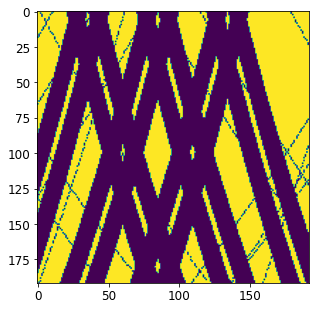

---------- frame 95--------------


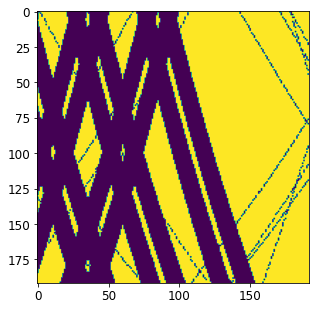

---------- frame 96--------------


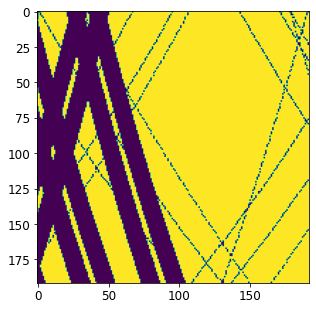

---------- frame 97--------------


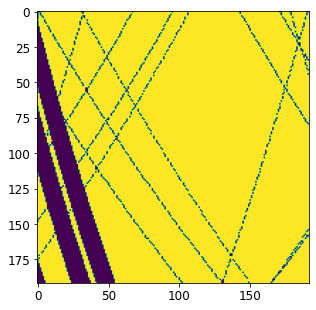

---------- frame 98--------------


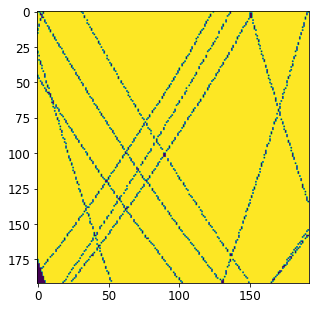

---------- frame 99--------------


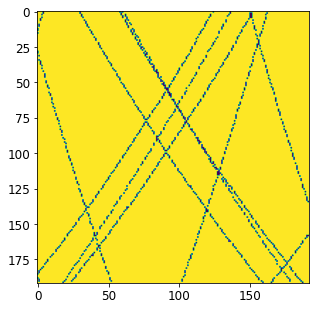

---------- frame 100--------------


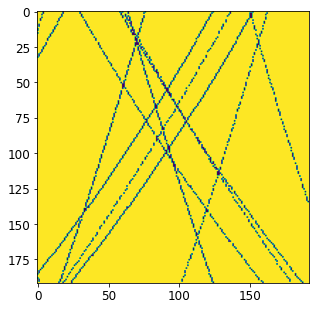

---------- frame 101--------------


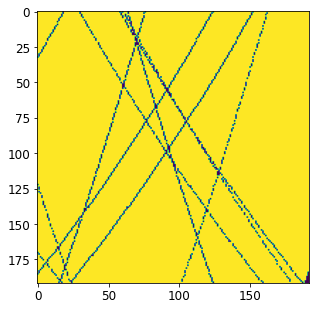

---------- frame 102--------------


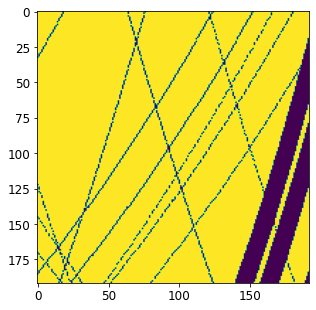

---------- frame 103--------------


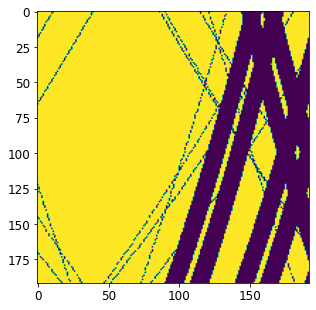

---------- frame 104--------------


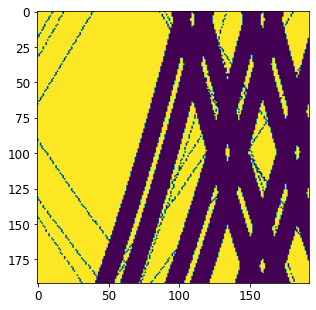

---------- frame 105--------------


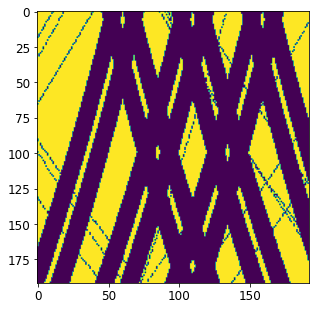

---------- frame 106--------------


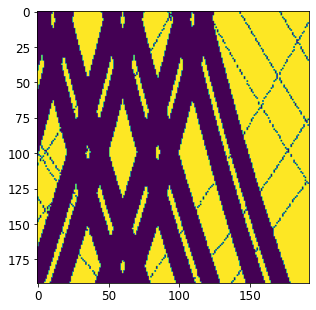

---------- frame 107--------------


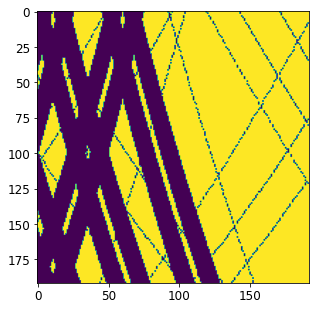

---------- frame 108--------------


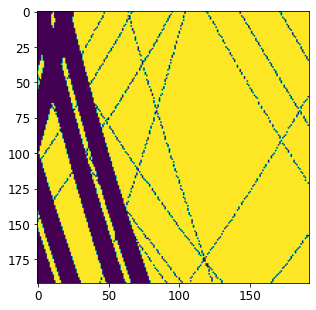

---------- frame 109--------------


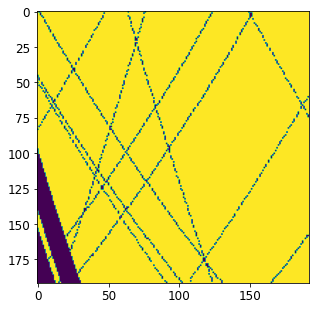

---------- frame 110--------------


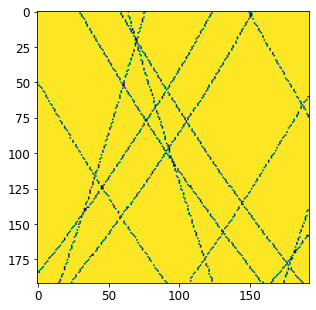

---------- frame 111--------------


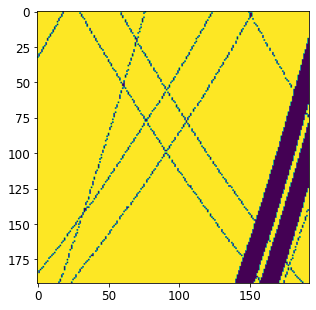

---------- frame 112--------------


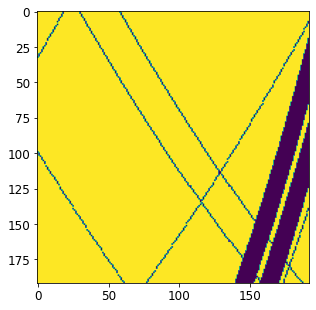

---------- frame 113--------------


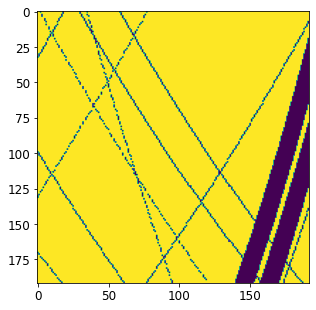

---------- frame 114--------------


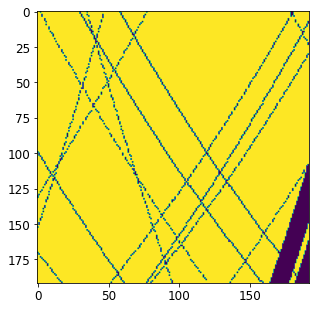

---------- frame 115--------------


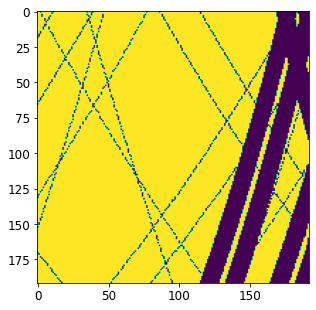

---------- frame 116--------------


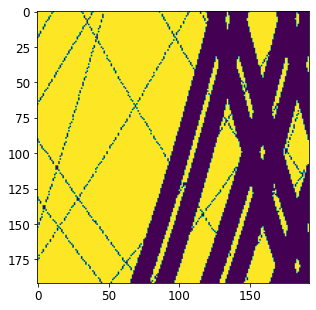

---------- frame 117--------------


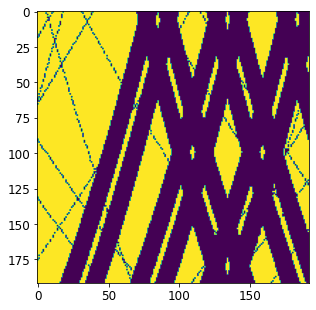

---------- frame 118--------------


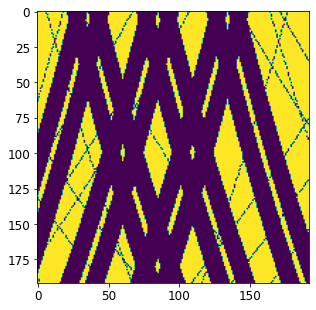

---------- frame 119--------------


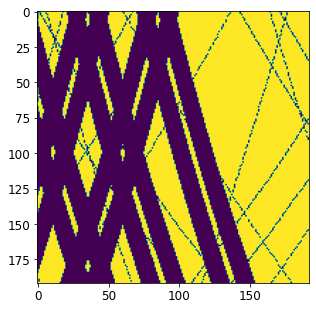

---------- frame 120--------------


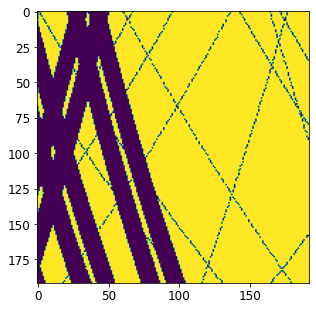

---------- frame 121--------------


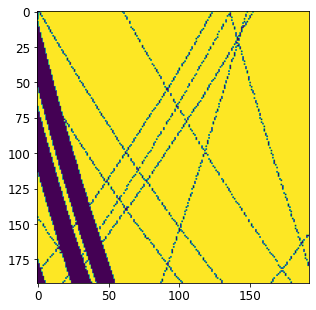

---------- frame 122--------------


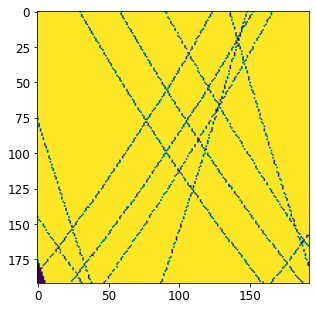

---------- frame 123--------------


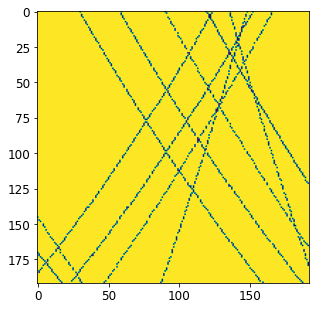

---------- frame 124--------------


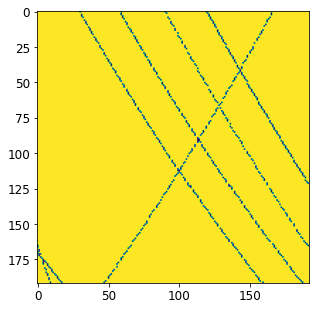

---------- frame 125--------------


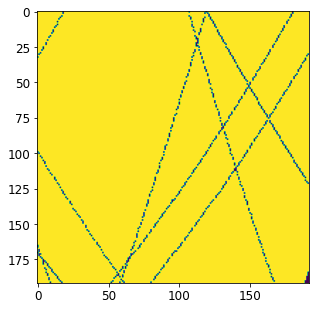

---------- frame 126--------------


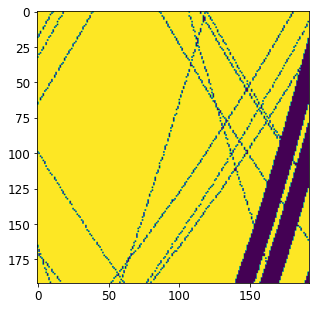

---------- frame 127--------------


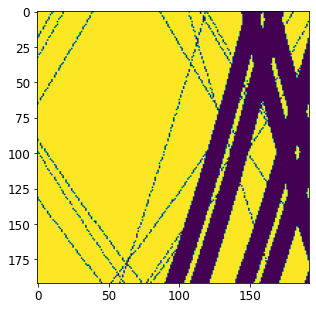

---------- frame 128--------------


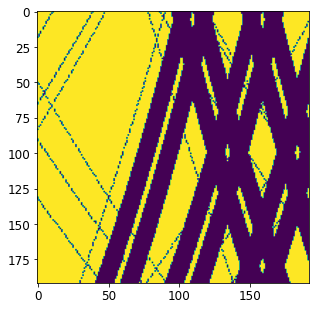

---------- frame 129--------------


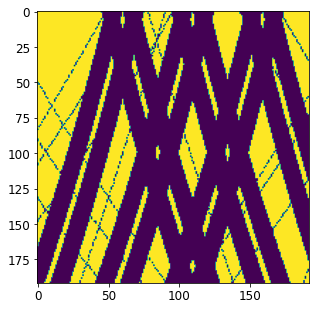

---------- frame 130--------------


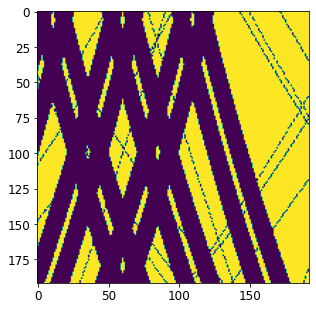

---------- frame 131--------------


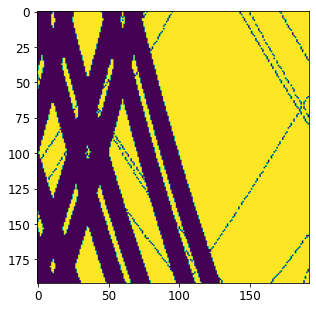

---------- frame 132--------------


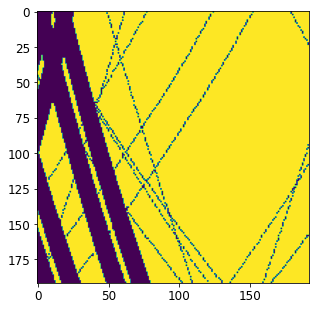

---------- frame 133--------------


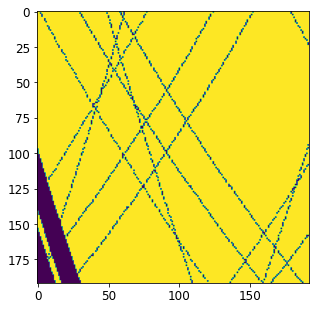

---------- frame 134--------------


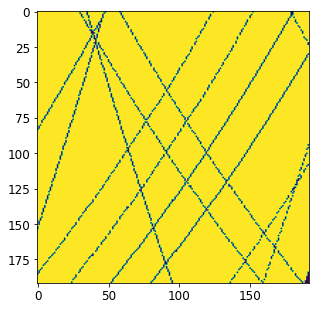

---------- frame 135--------------


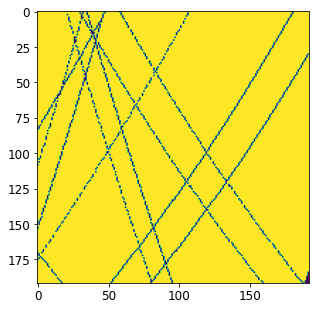

---------- frame 136--------------


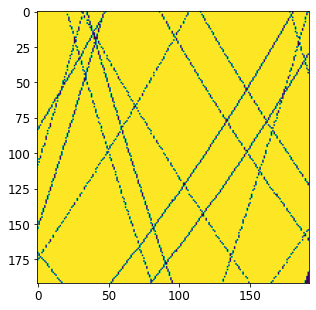

---------- frame 137--------------


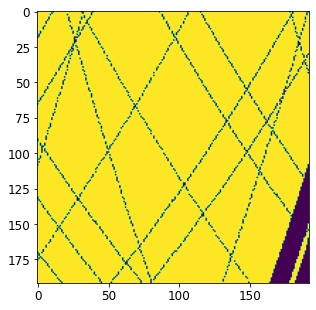

---------- frame 138--------------


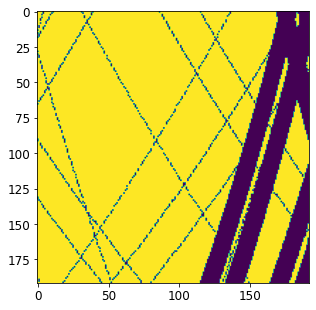

---------- frame 139--------------


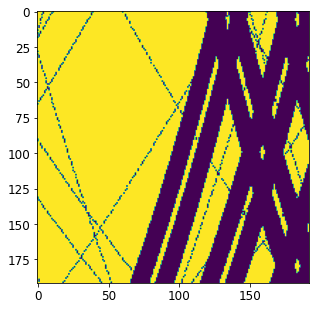

---------- frame 140--------------


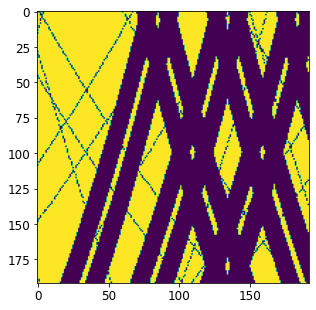

---------- frame 141--------------


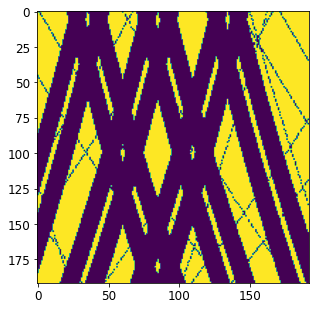

---------- frame 142--------------


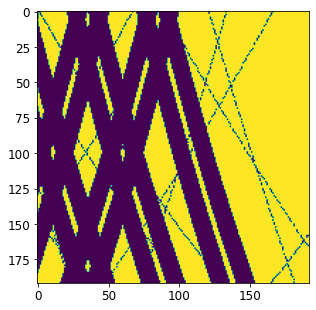

---------- frame 143--------------


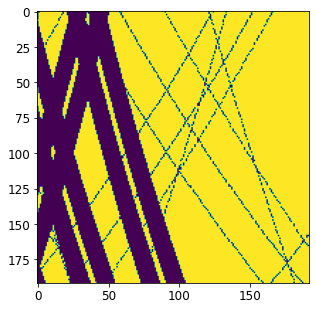

---------- frame 144--------------


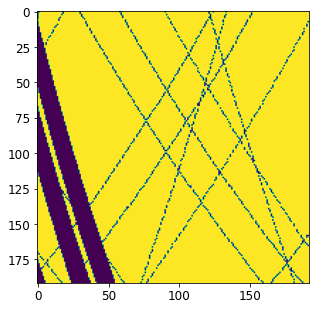

---------- frame 145--------------


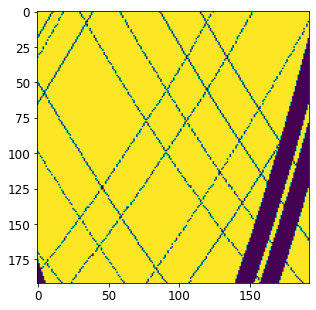

---------- frame 146--------------


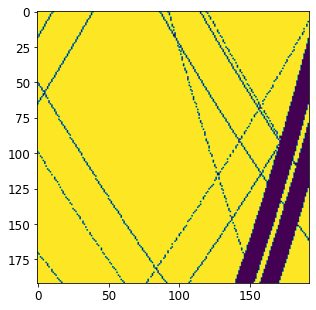

---------- frame 147--------------


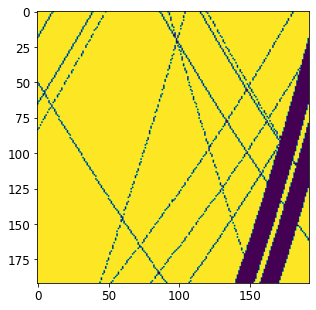

---------- frame 148--------------


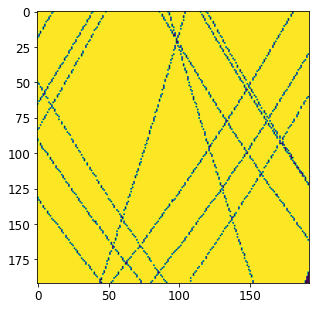

---------- frame 149--------------


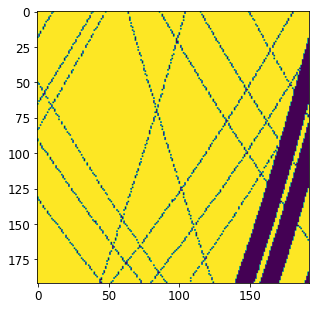

---------- frame 150--------------


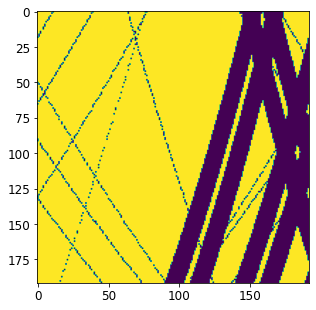

---------- frame 151--------------


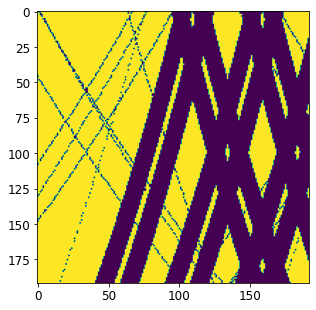

---------- frame 152--------------


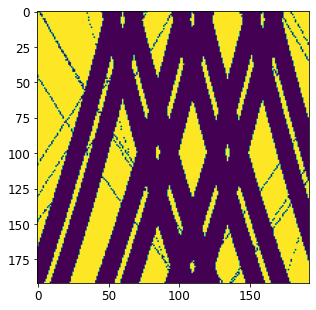

---------- frame 153--------------


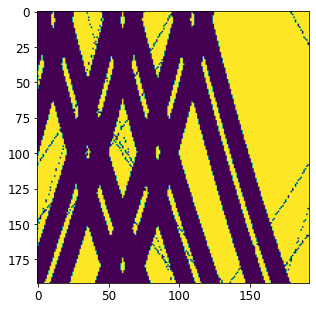

---------- frame 154--------------


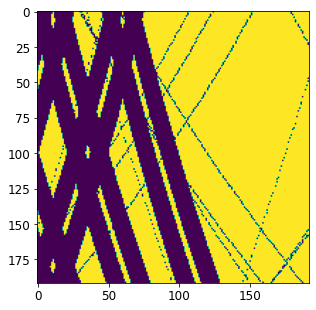

---------- frame 155--------------


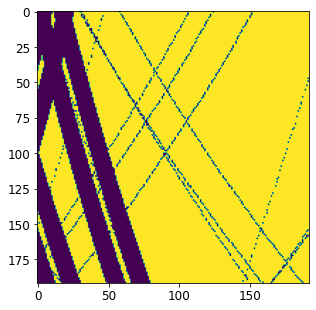

---------- frame 156--------------


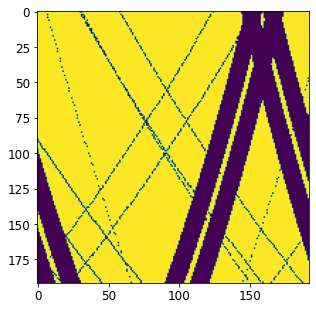

---------- frame 157--------------


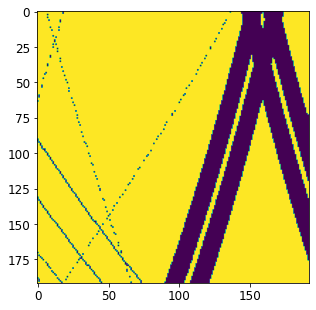

---------- frame 158--------------


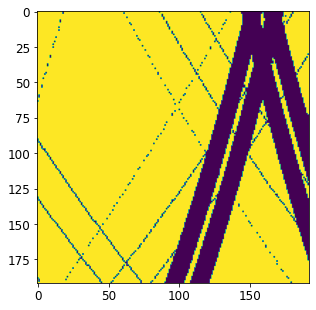

---------- frame 159--------------


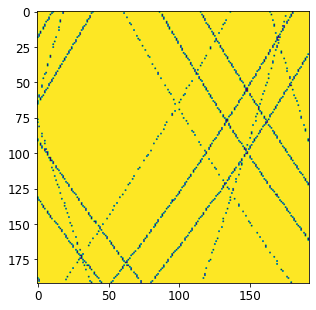

---------- frame 160--------------


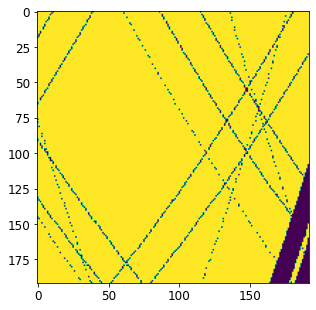

---------- frame 161--------------


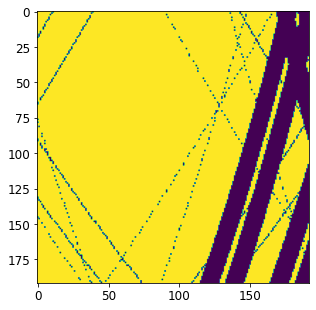

---------- frame 162--------------


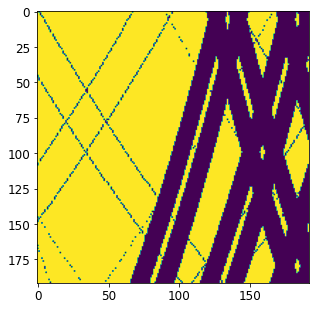

---------- frame 163--------------


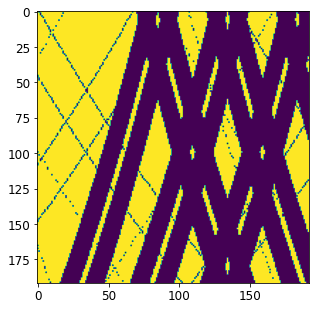

---------- frame 164--------------


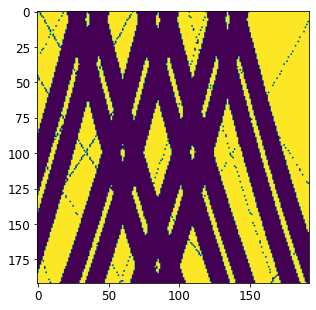

---------- frame 165--------------


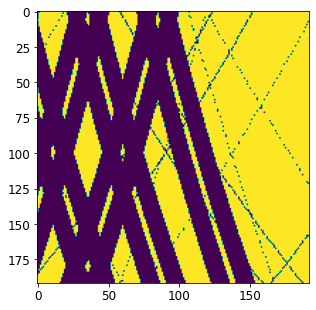

---------- frame 166--------------


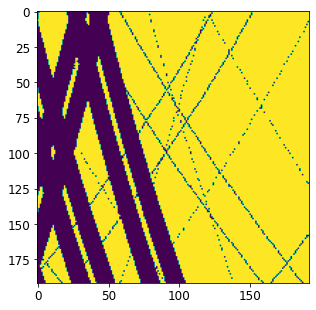

---------- frame 167--------------


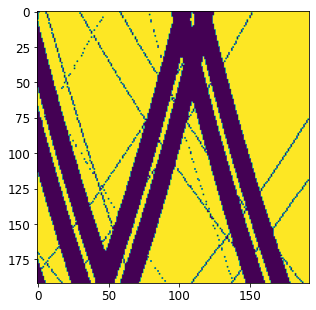

---------- frame 168--------------


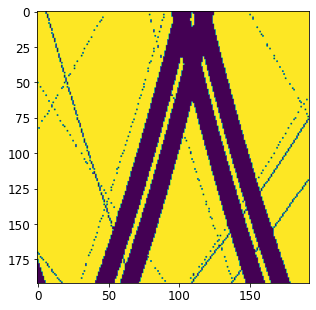

---------- frame 169--------------


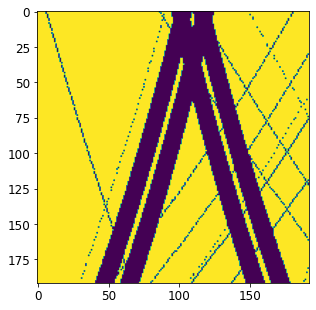

---------- frame 170--------------


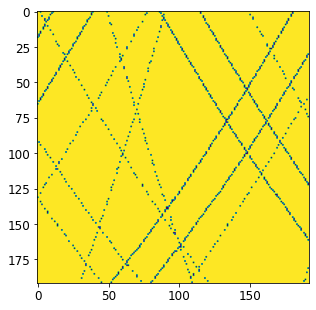

---------- frame 171--------------


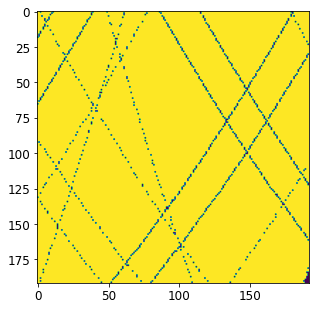

---------- frame 172--------------


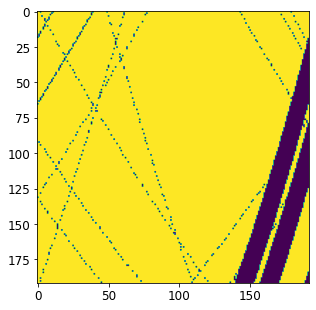

---------- frame 173--------------


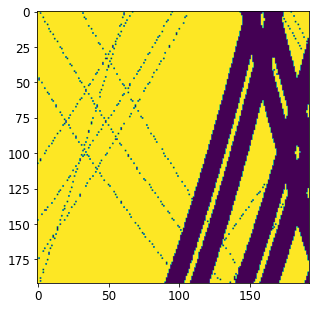

---------- frame 174--------------


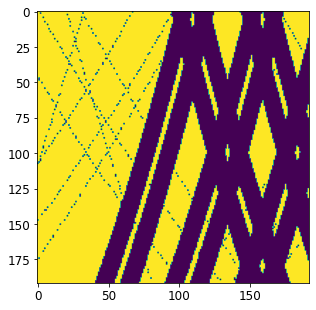

---------- frame 175--------------


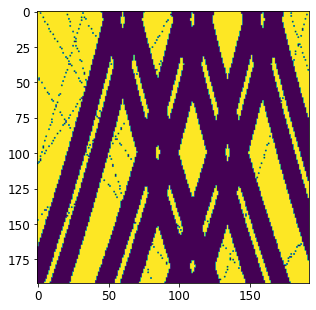

---------- frame 176--------------


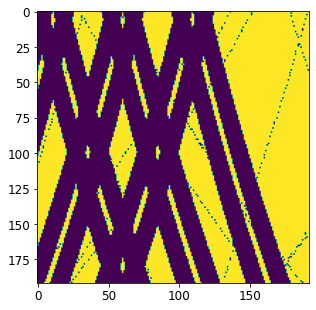

---------- frame 177--------------


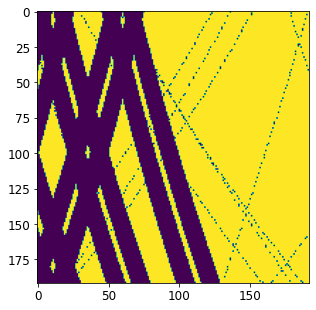

---------- frame 178--------------


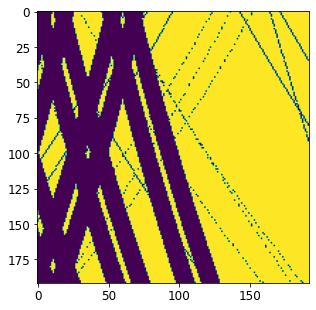

---------- frame 179--------------


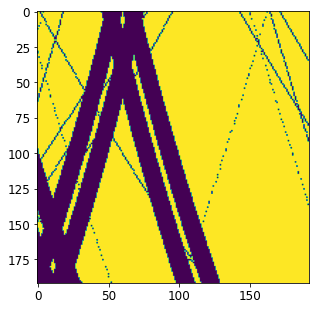

---------- frame 180--------------


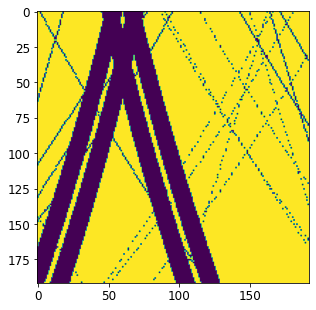

---------- frame 181--------------


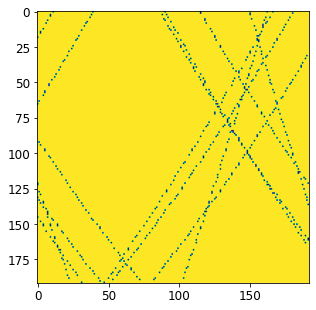

---------- frame 182--------------


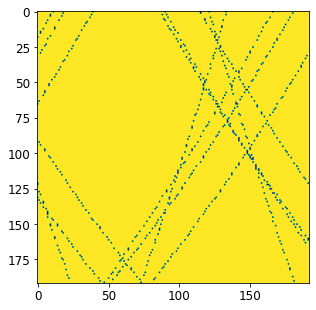

---------- frame 183--------------


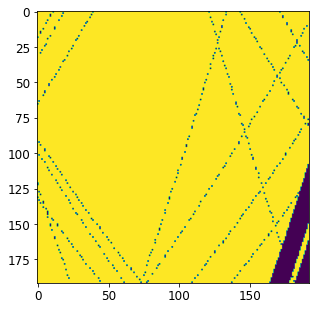

---------- frame 184--------------


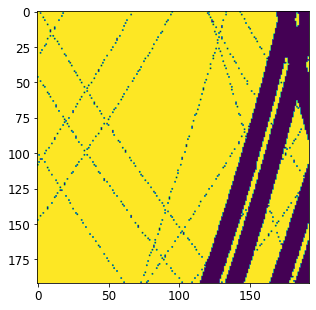

---------- frame 185--------------


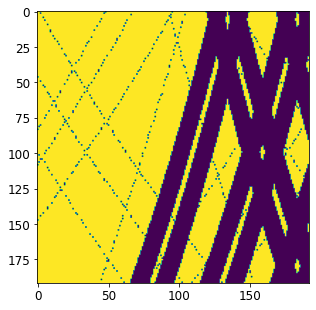

---------- frame 186--------------


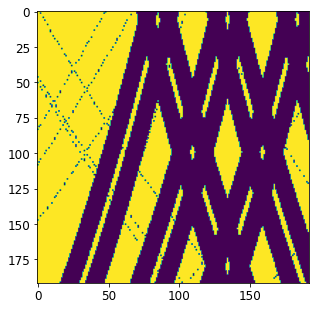

---------- frame 187--------------


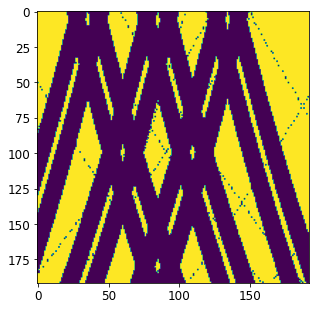

---------- frame 188--------------


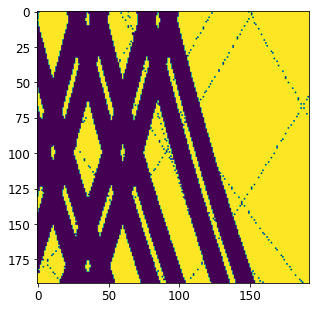

---------- frame 189--------------


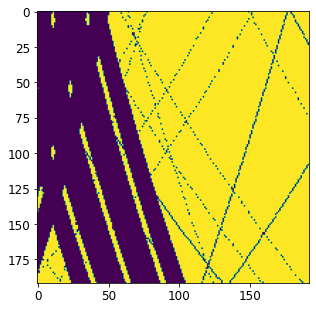

---------- frame 190--------------


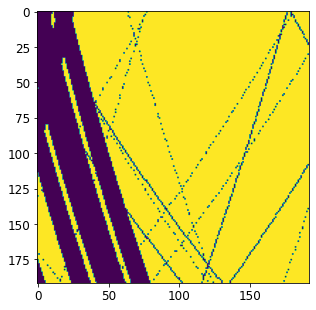

---------- frame 191--------------


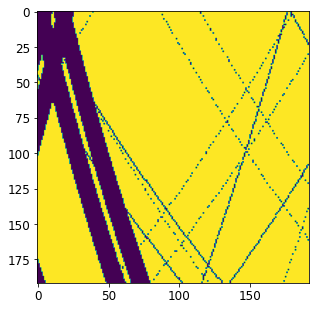

---------- frame 192--------------


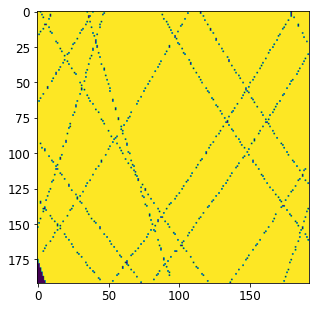

---------- frame 193--------------


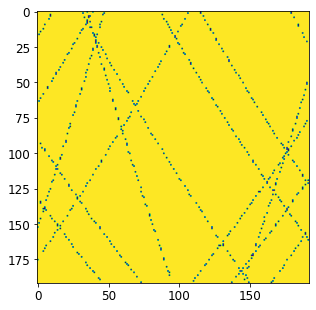

---------- frame 194--------------


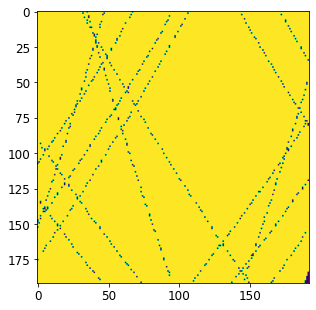

---------- frame 195--------------


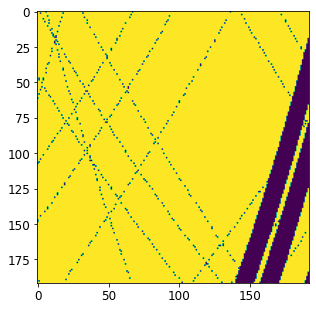

---------- frame 196--------------


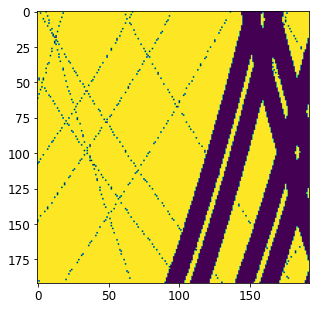

---------- frame 197--------------


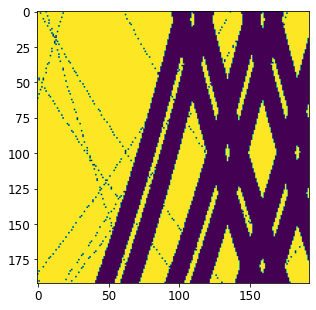

---------- frame 198--------------


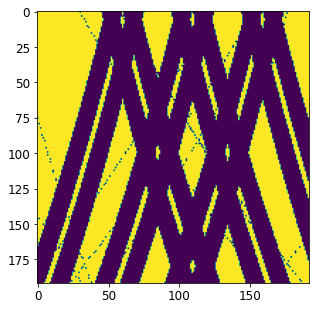

---------- frame 199--------------


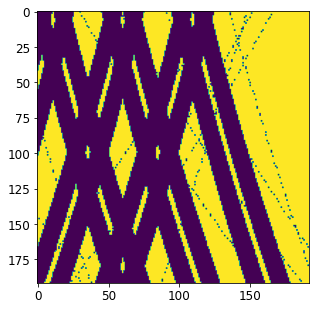

---------- frame 200--------------


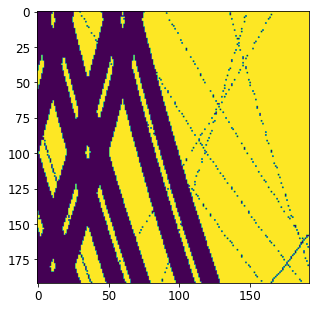

---------- frame 201--------------


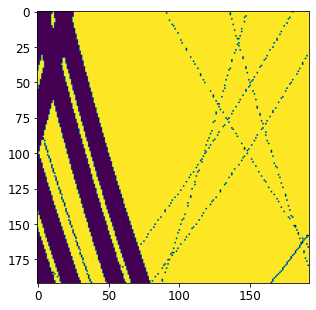

---------- frame 202--------------


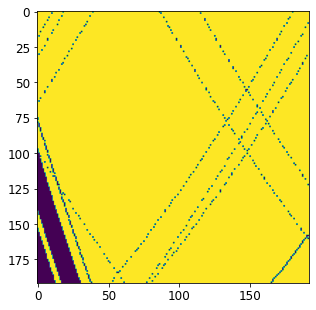

---------- frame 203--------------


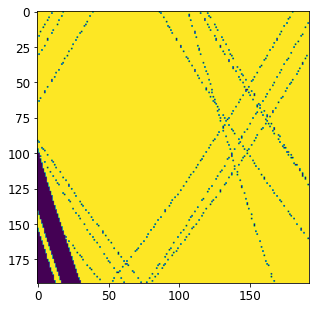

---------- frame 204--------------


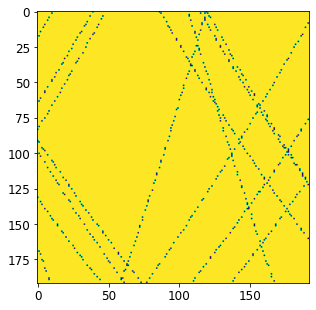

---------- frame 205--------------


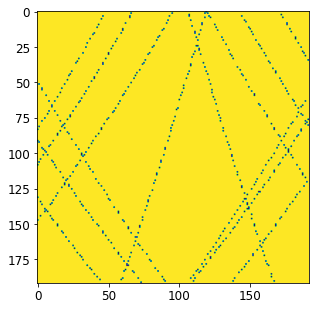

---------- frame 206--------------


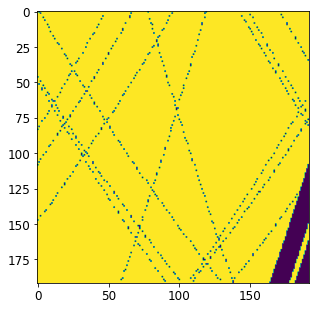

---------- frame 207--------------


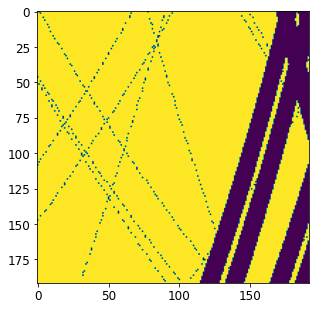

---------- frame 208--------------


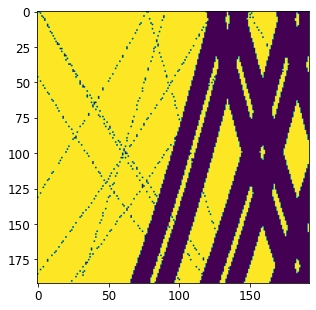

---------- frame 209--------------


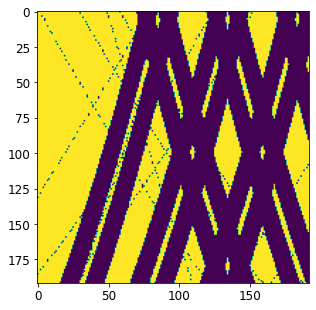

---------- frame 210--------------


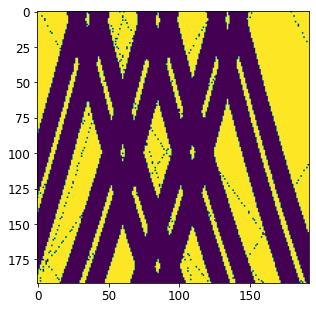

---------- frame 211--------------


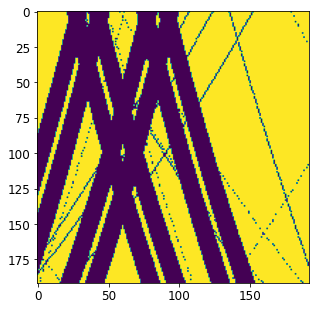

---------- frame 212--------------


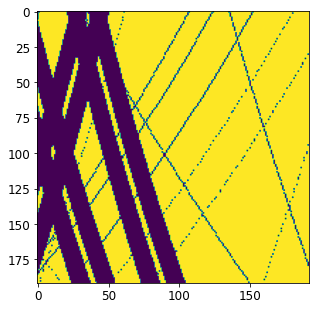

---------- frame 213--------------


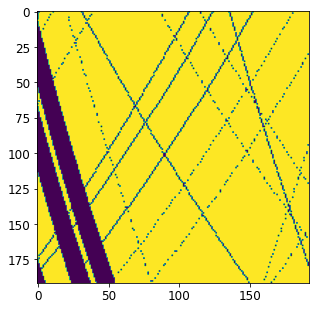

---------- frame 214--------------


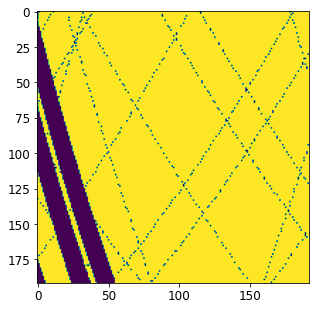

---------- frame 215--------------


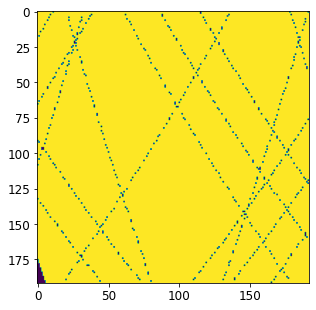

---------- frame 216--------------


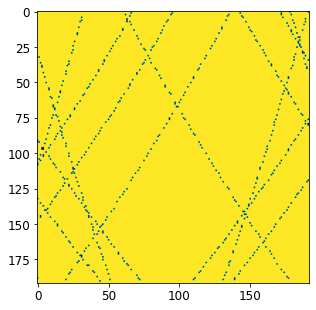

---------- frame 217--------------


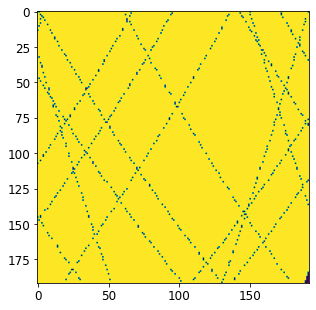

---------- frame 218--------------


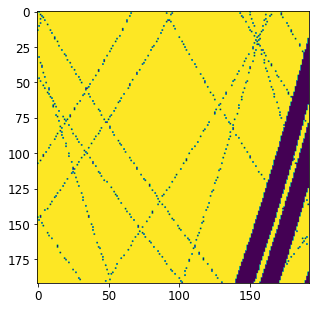

---------- frame 219--------------


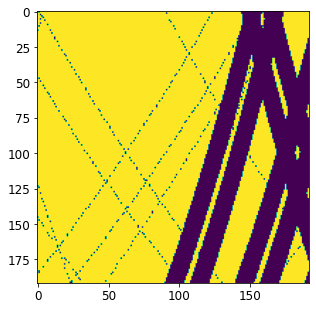

---------- frame 220--------------


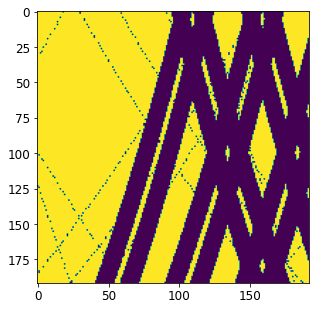

---------- frame 221--------------


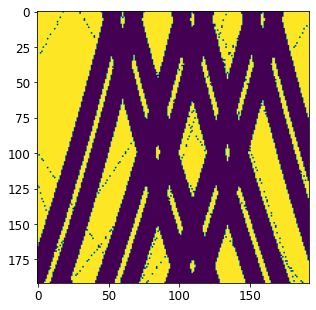

---------- frame 222--------------


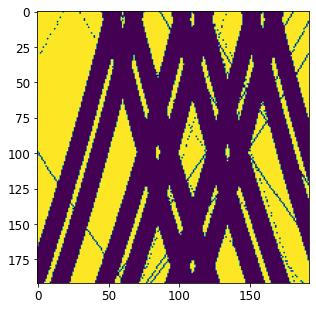

---------- frame 223--------------


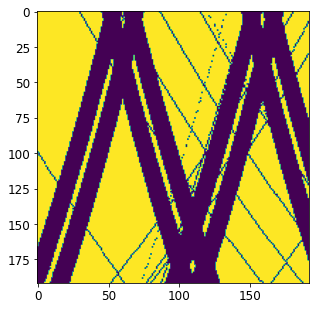

---------- frame 224--------------


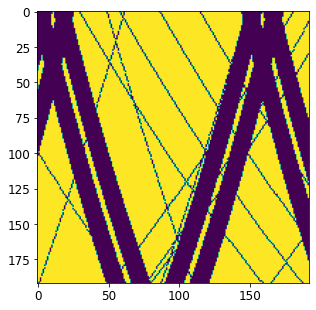

---------- frame 225--------------


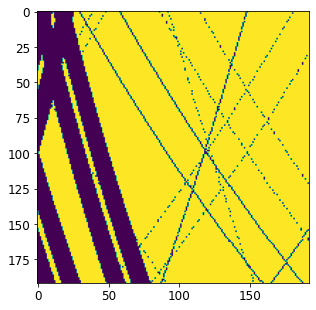

---------- frame 226--------------


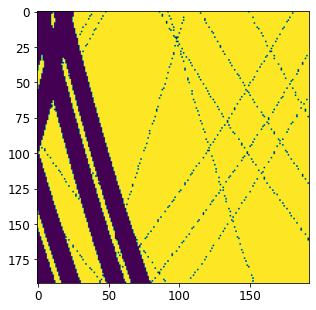

---------- frame 227--------------


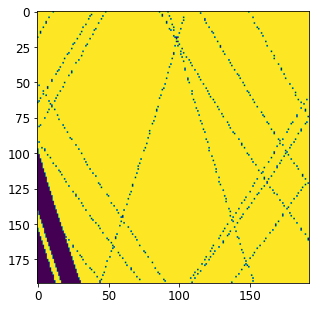

---------- frame 228--------------


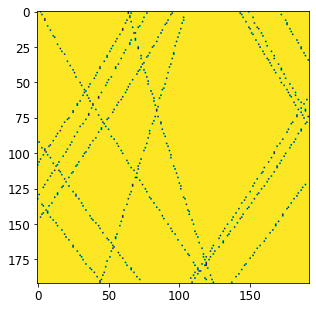

---------- frame 229--------------


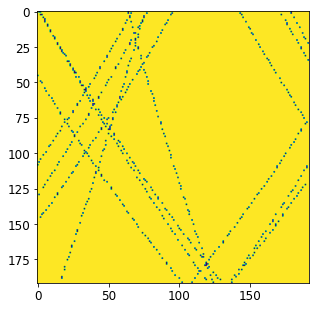

---------- frame 230--------------


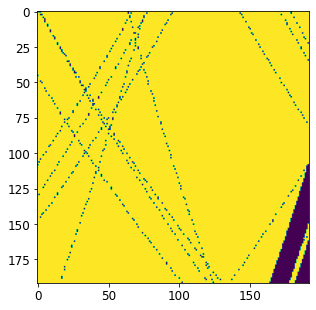

---------- frame 231--------------


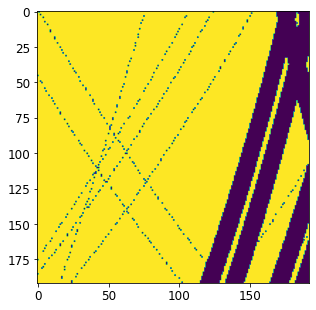

---------- frame 232--------------


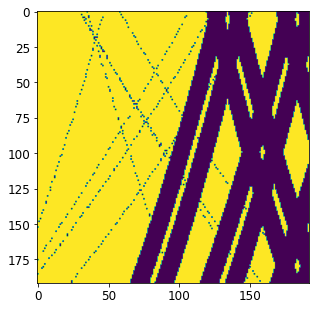

---------- frame 233--------------


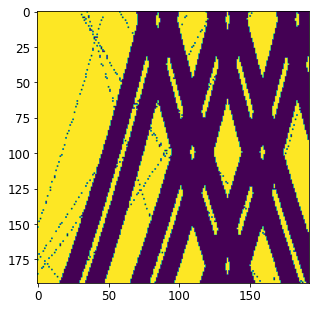

---------- frame 234--------------


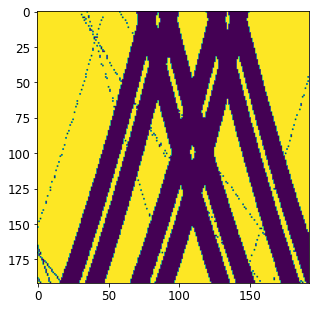

---------- frame 235--------------


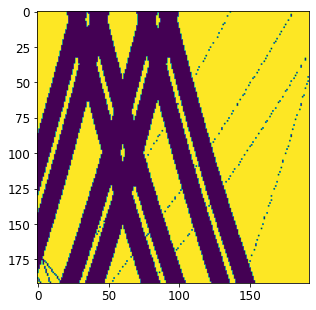

---------- frame 236--------------


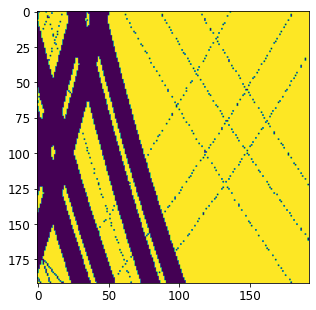

---------- frame 237--------------


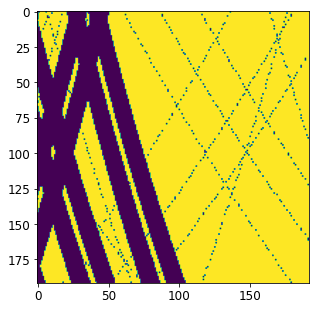

---------- frame 238--------------


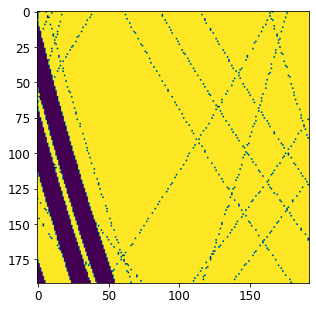

---------- frame 239--------------


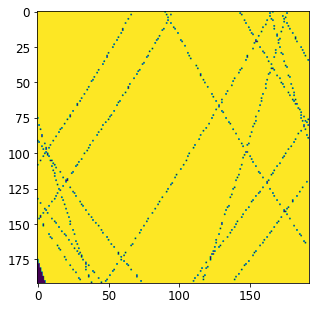

---------- frame 240--------------


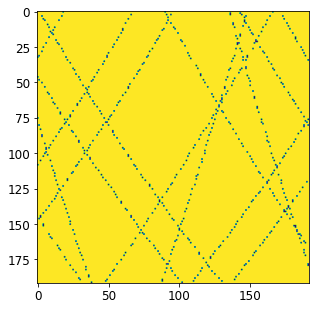

---------- frame 241--------------


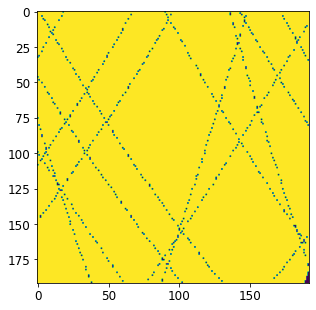

---------- frame 242--------------


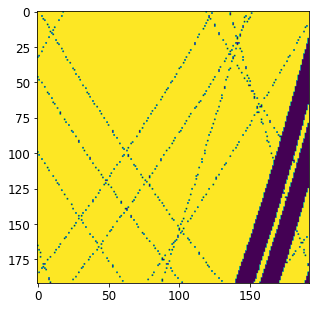

---------- frame 243--------------


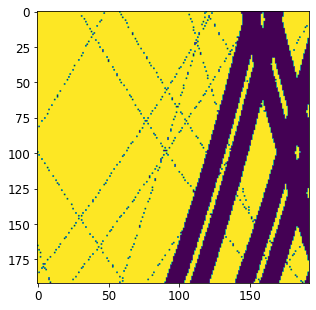

---------- frame 244--------------


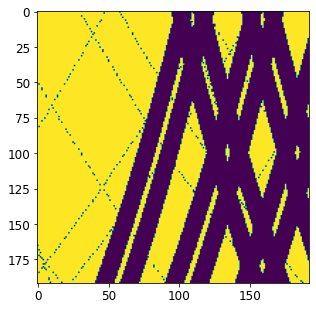

---------- frame 245--------------


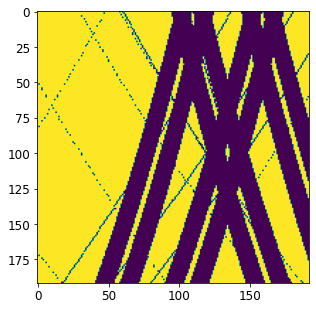

---------- frame 246--------------


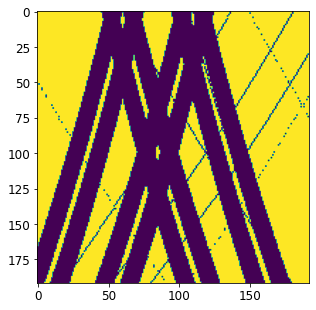

---------- frame 247--------------


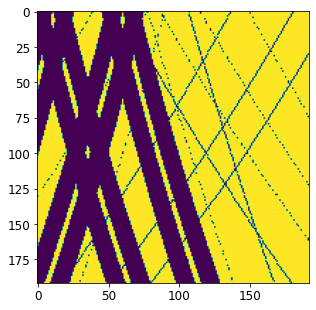

---------- frame 248--------------


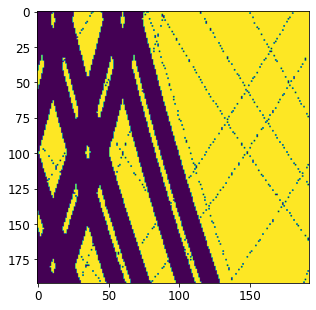

---------- frame 249--------------


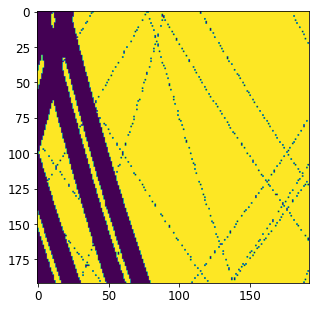

---------- frame 250--------------


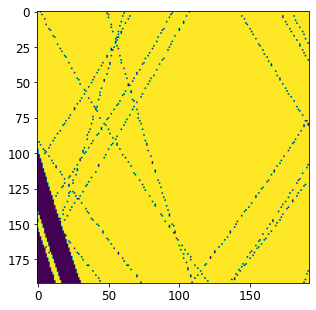

---------- frame 251--------------


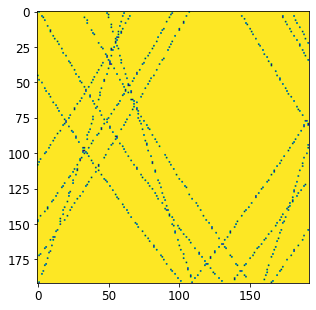

---------- frame 252--------------


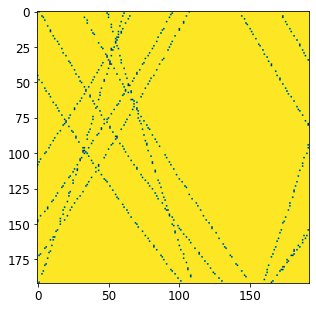

---------- frame 253--------------


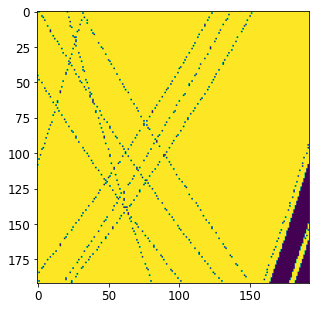

---------- frame 254--------------


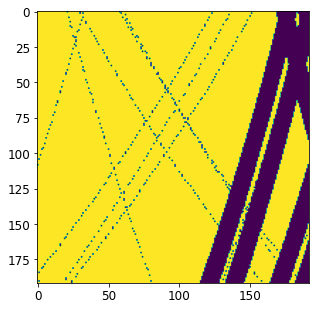

---------- frame 255--------------


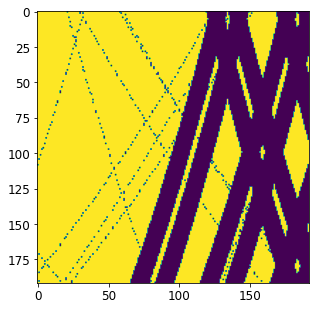

---------- frame 256--------------


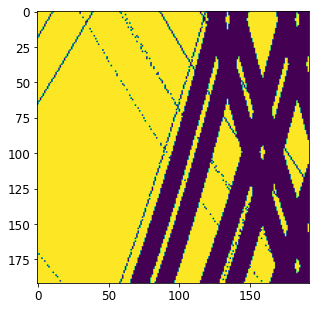

---------- frame 257--------------


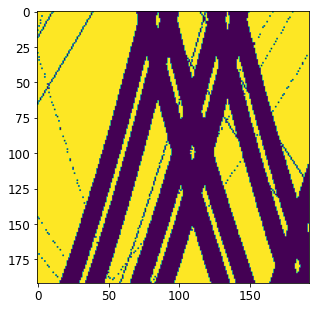

---------- frame 258--------------


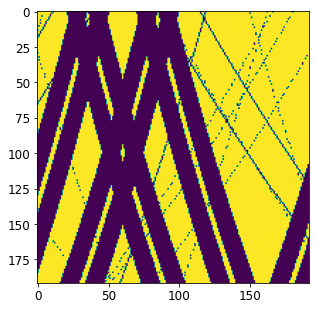

---------- frame 259--------------


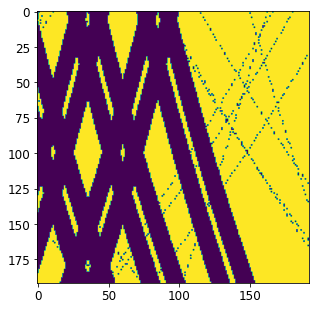

---------- frame 260--------------


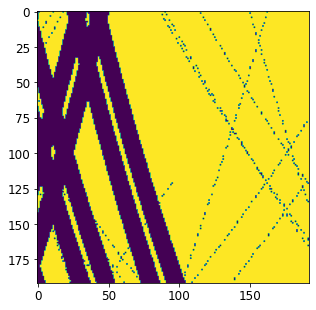

---------- frame 261--------------


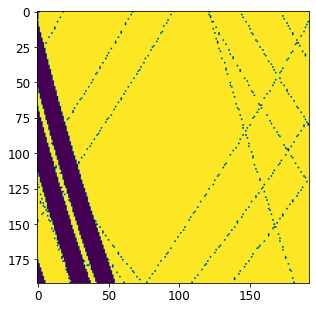

---------- frame 262--------------


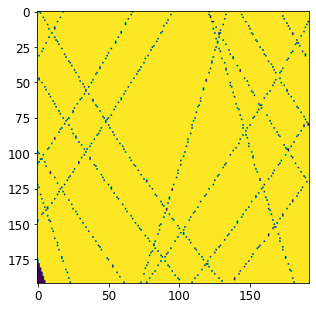

---------- frame 263--------------


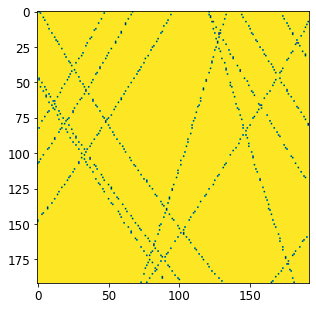

---------- frame 264--------------


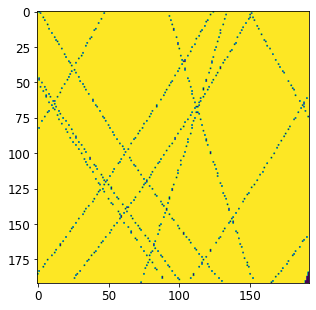

---------- frame 265--------------


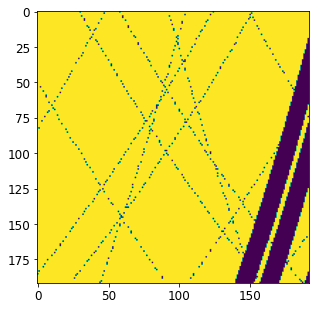

---------- frame 266--------------


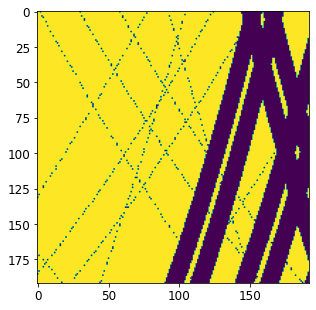

---------- frame 267--------------


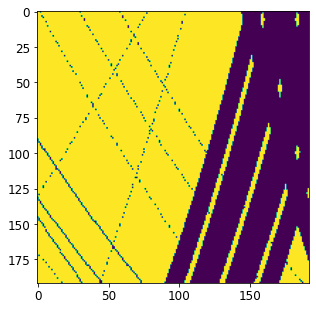

---------- frame 268--------------


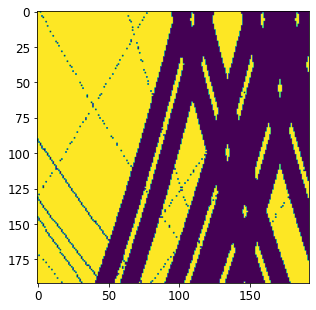

---------- frame 269--------------


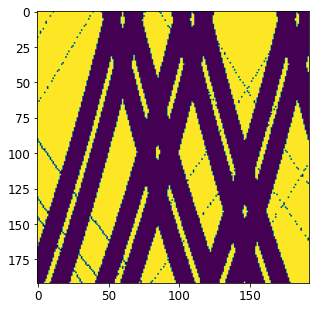

---------- frame 270--------------


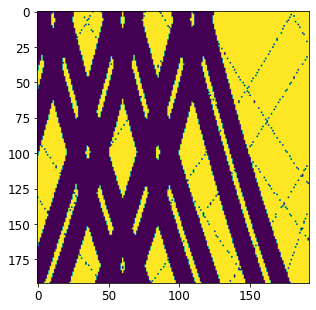

---------- frame 271--------------


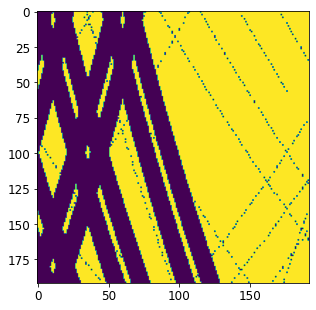

---------- frame 272--------------


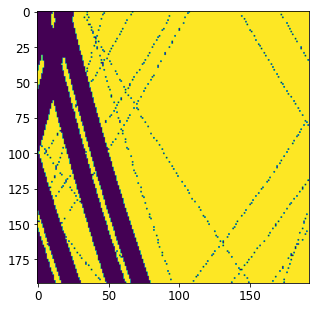

---------- frame 273--------------


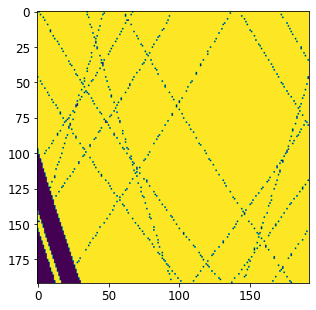

---------- frame 274--------------


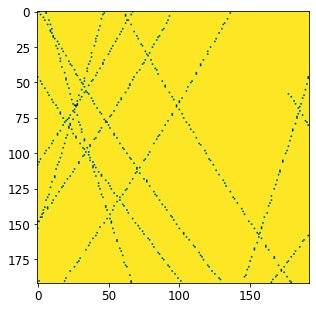

---------- frame 275--------------


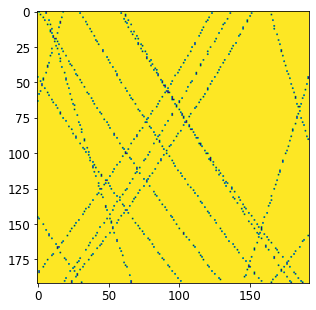

---------- frame 276--------------


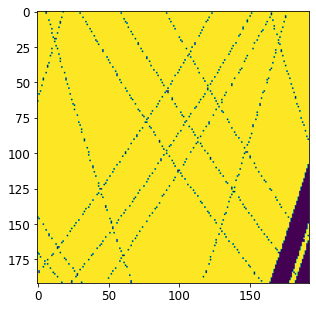

---------- frame 277--------------


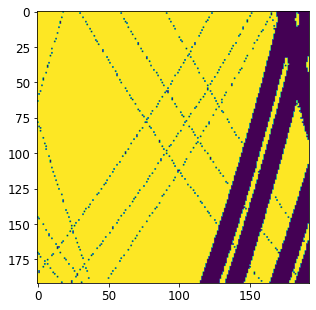

---------- frame 278--------------


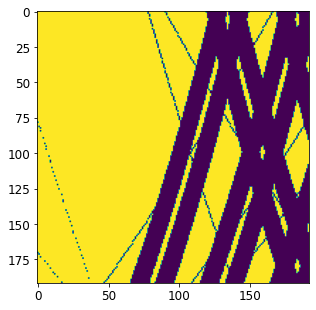

---------- frame 279--------------


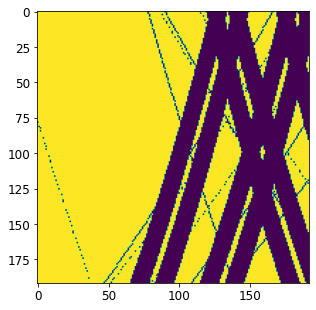

---------- frame 280--------------


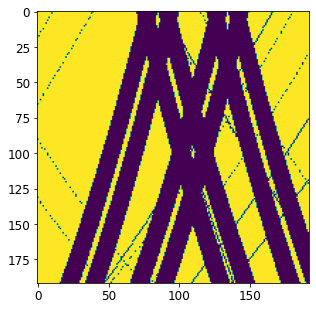

---------- frame 281--------------


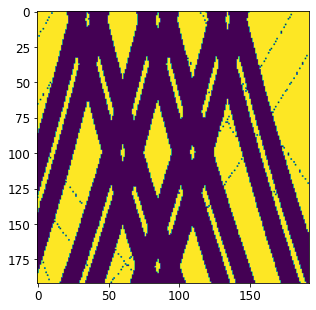

---------- frame 282--------------


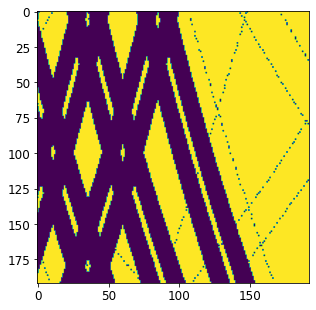

---------- frame 283--------------


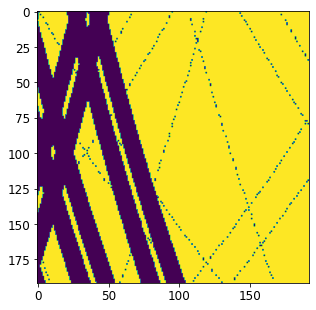

---------- frame 284--------------


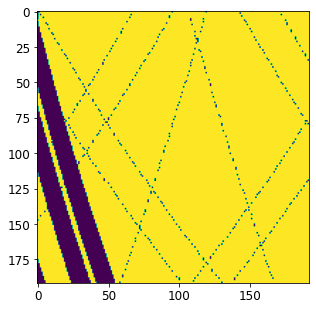

---------- frame 285--------------


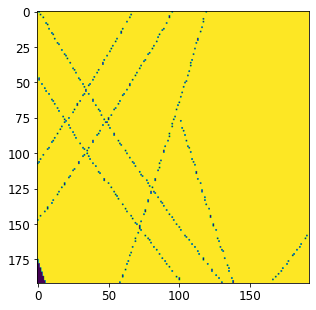

---------- frame 286--------------


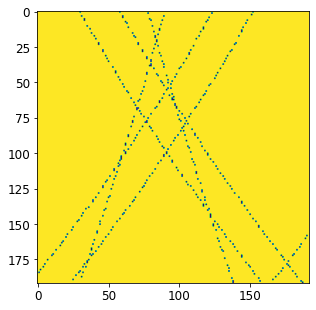

---------- frame 287--------------


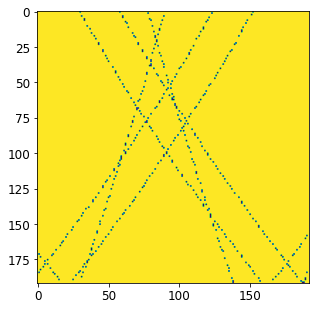

---------- frame 288--------------


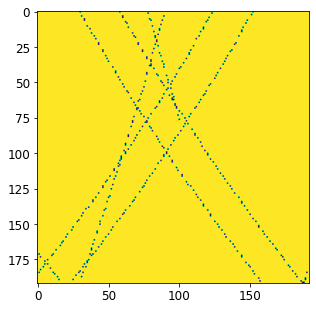

---------- frame 289--------------


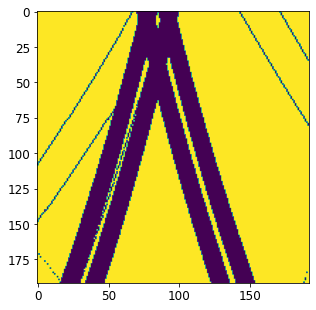

---------- frame 290--------------


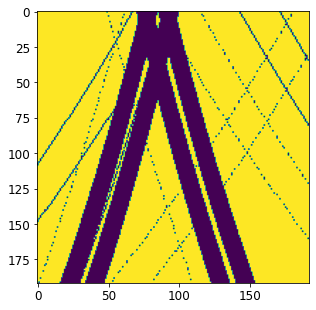

---------- frame 291--------------


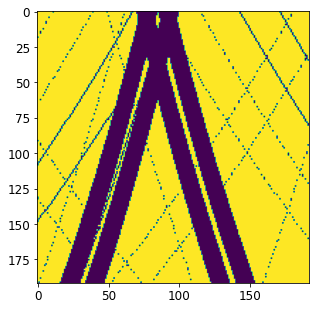

---------- frame 292--------------


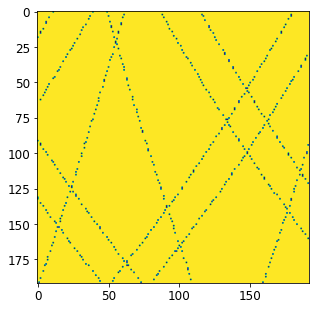

---------- frame 293--------------


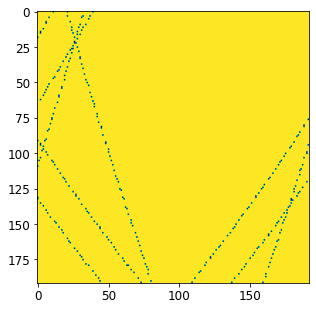

---------- frame 294--------------


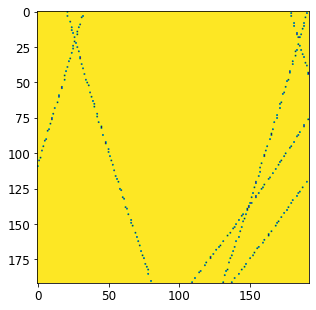

---------- frame 295--------------


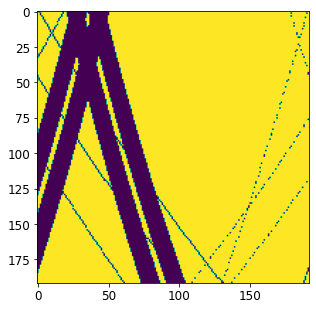

---------- frame 296--------------


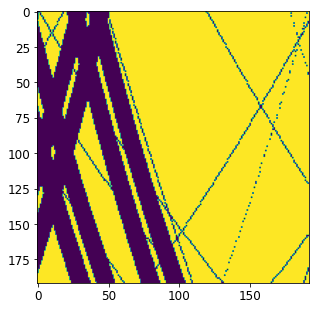

---------- frame 297--------------


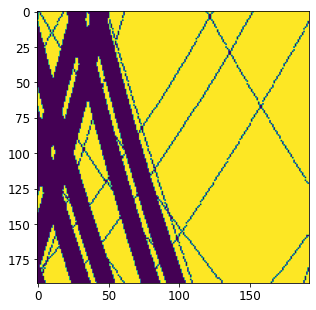

---------- frame 298--------------


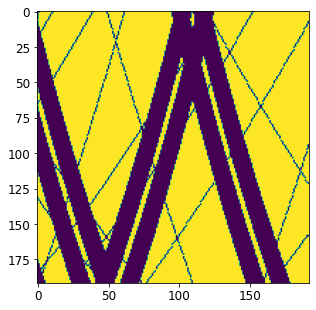

---------- frame 299--------------


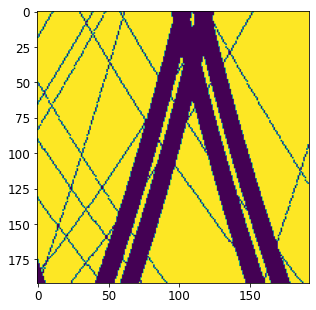

---------- frame 300--------------


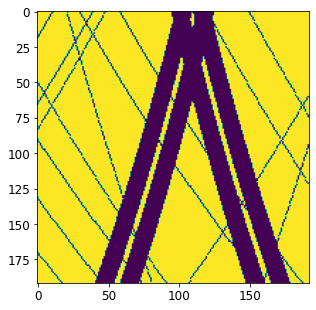

---------- frame 301--------------


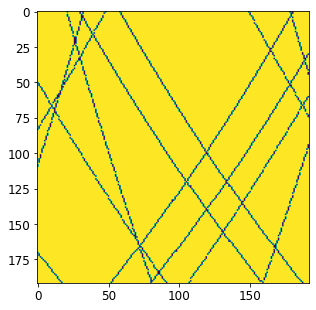

---------- frame 302--------------


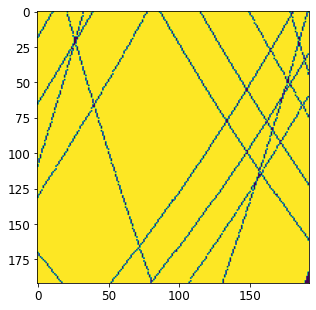

---------- frame 303--------------


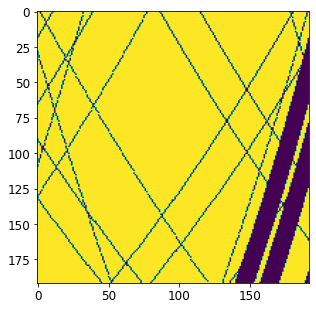

---------- frame 304--------------


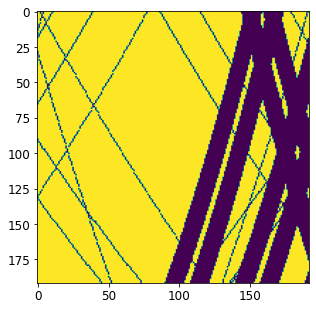

---------- frame 305--------------


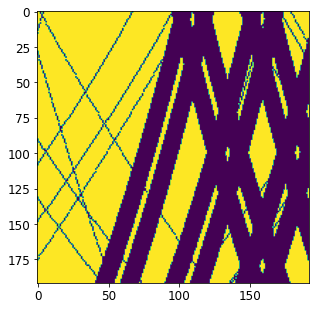

---------- frame 306--------------


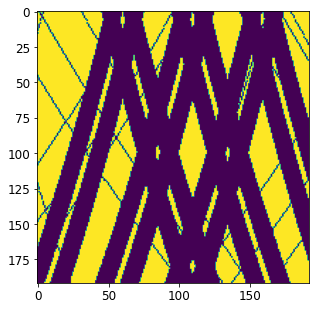

---------- frame 307--------------


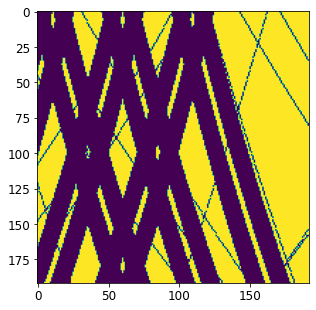

---------- frame 308--------------


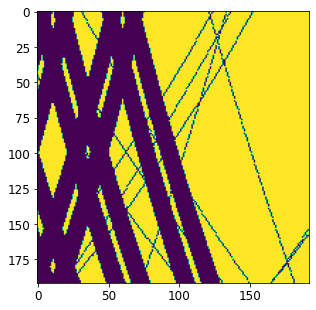

---------- frame 309--------------


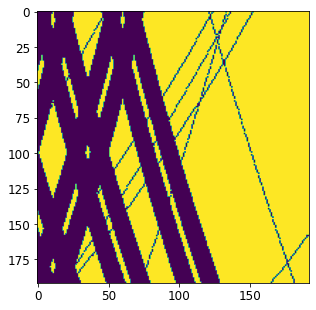

---------- frame 310--------------


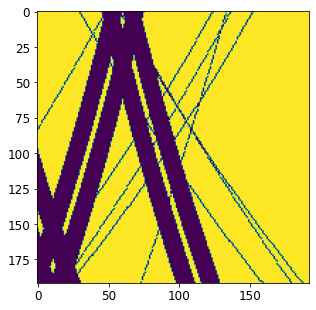

---------- frame 311--------------


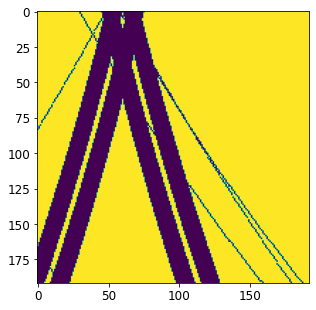

---------- frame 312--------------


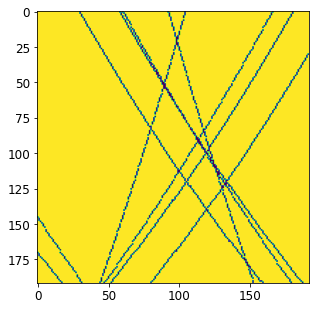

---------- frame 313--------------


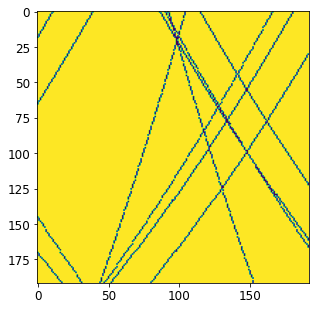

---------- frame 314--------------


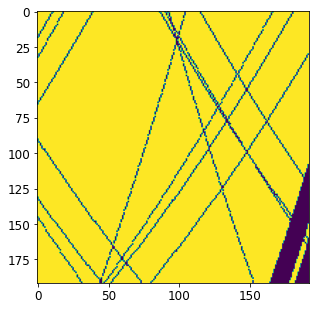

---------- frame 315--------------


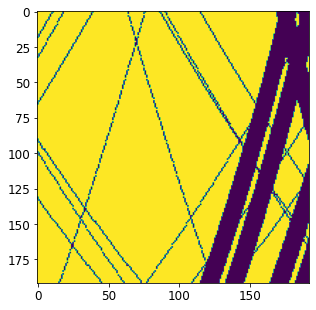

---------- frame 316--------------


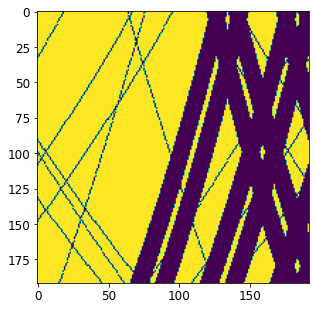

---------- frame 317--------------


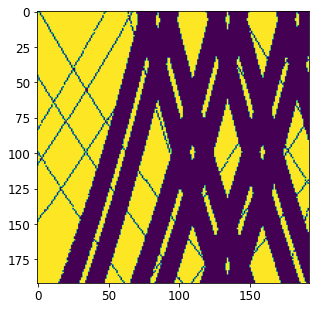

---------- frame 318--------------


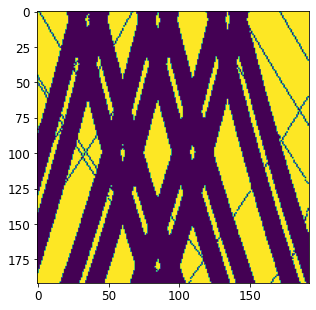

---------- frame 319--------------


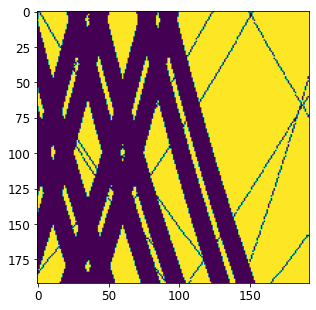

---------- frame 320--------------


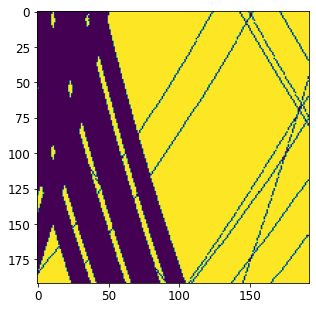

---------- frame 321--------------


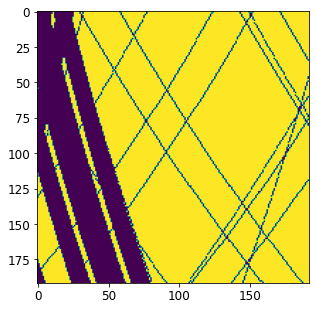

---------- frame 322--------------


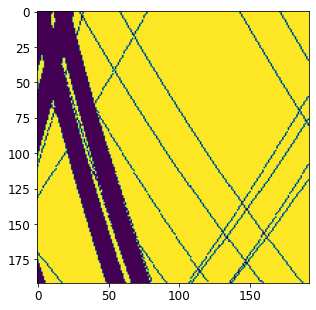

---------- frame 323--------------


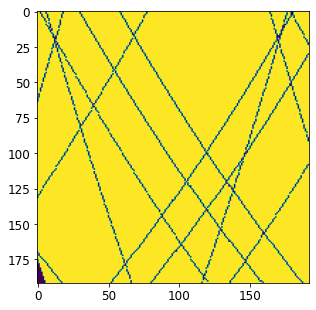

---------- frame 324--------------


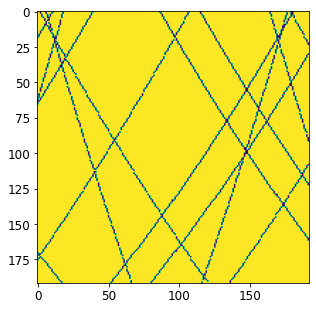

---------- frame 325--------------


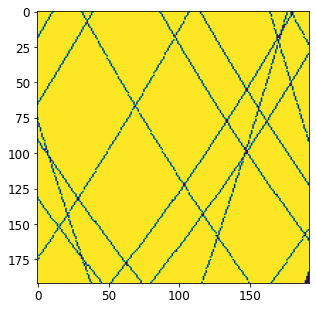

---------- frame 326--------------


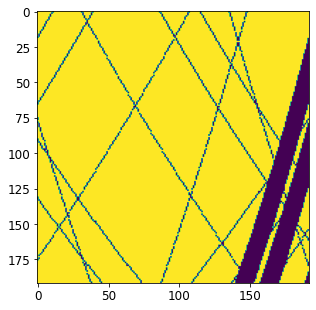

---------- frame 327--------------


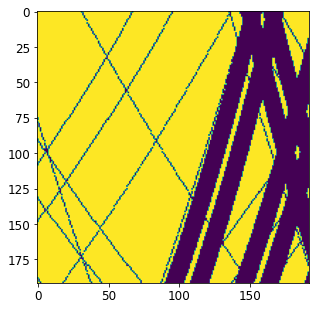

---------- frame 328--------------


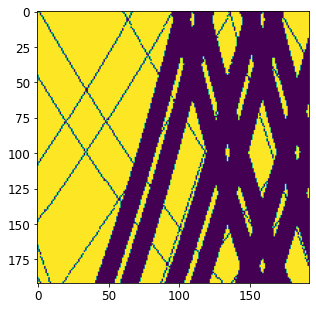

---------- frame 329--------------


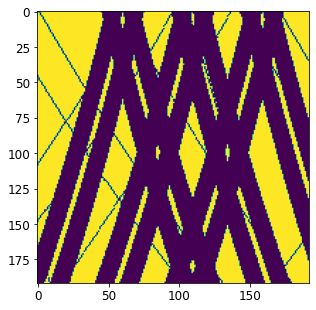

---------- frame 330--------------


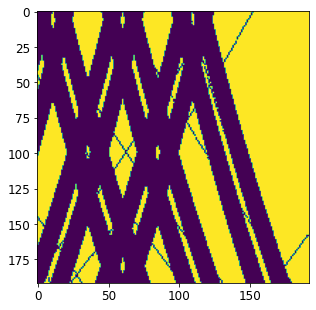

---------- frame 331--------------


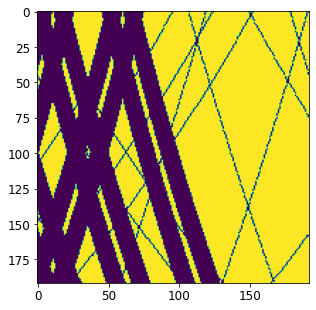

---------- frame 332--------------


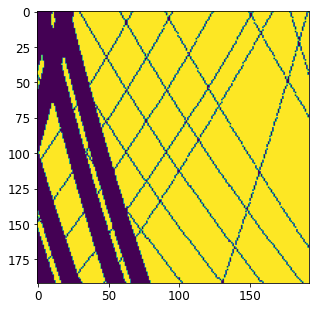

---------- frame 333--------------


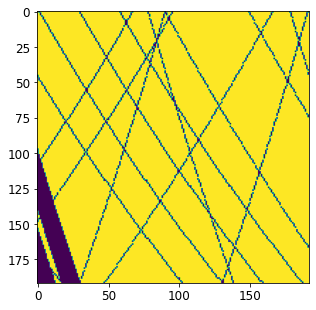

---------- frame 334--------------


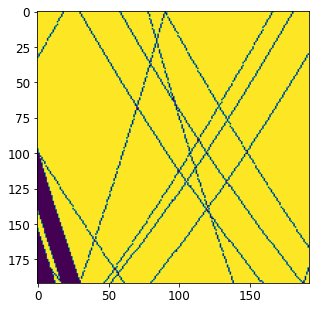

---------- frame 335--------------


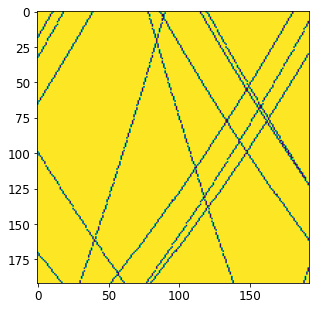

---------- frame 336--------------


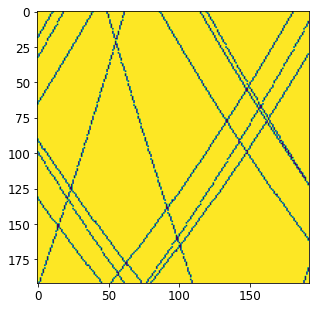

---------- frame 337--------------


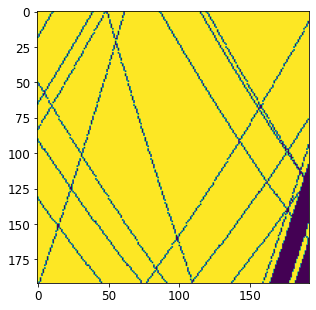

---------- frame 338--------------


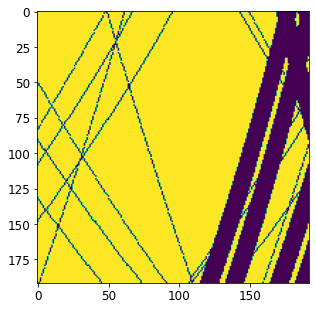

---------- frame 339--------------


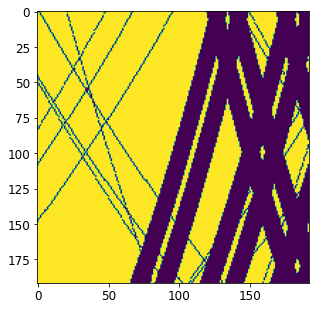

---------- frame 340--------------


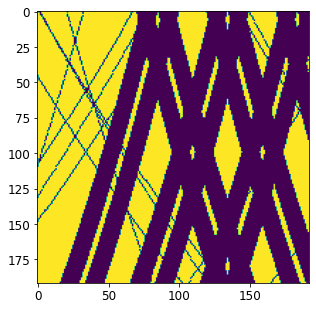

---------- frame 341--------------


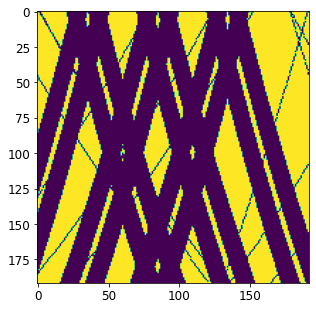

---------- frame 342--------------


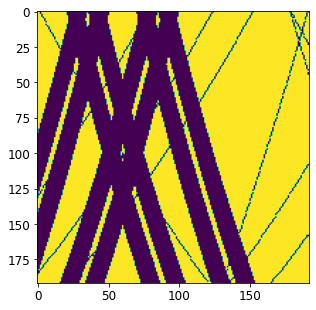

---------- frame 343--------------


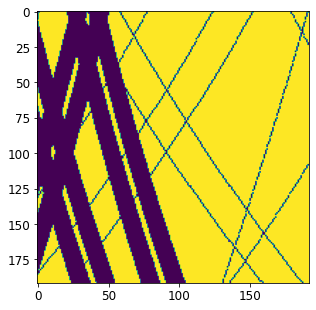

---------- frame 344--------------


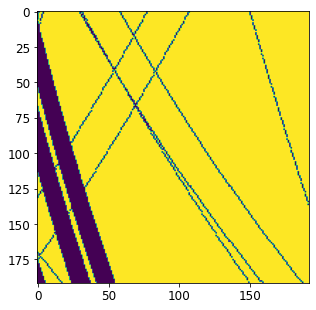

---------- frame 345--------------


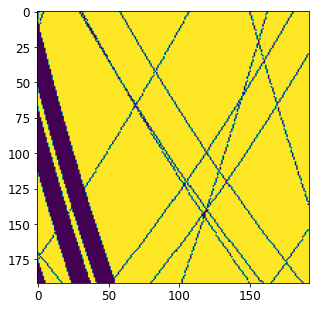

---------- frame 346--------------


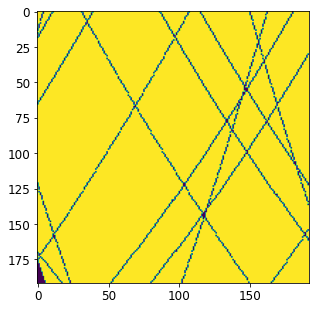

---------- frame 347--------------


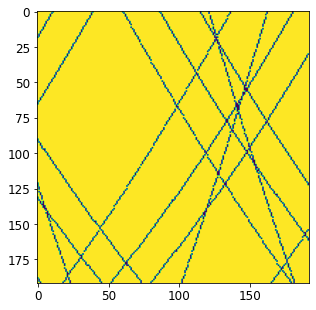

---------- frame 348--------------


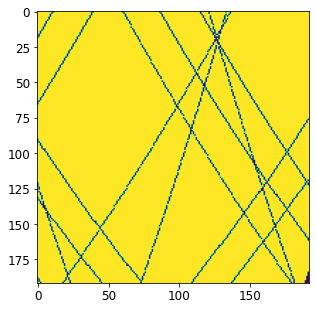

---------- frame 349--------------


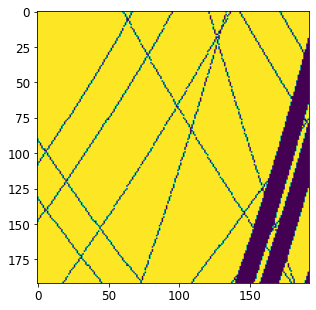

---------- frame 350--------------


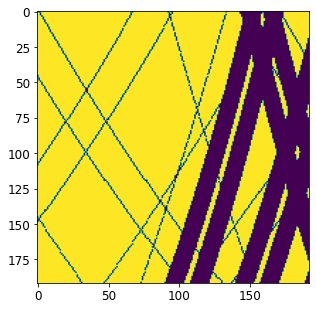

---------- frame 351--------------


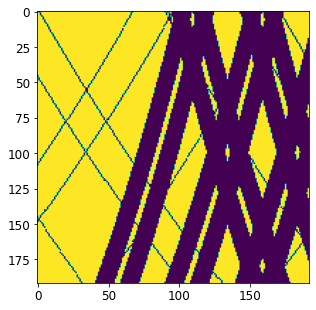

---------- frame 352--------------


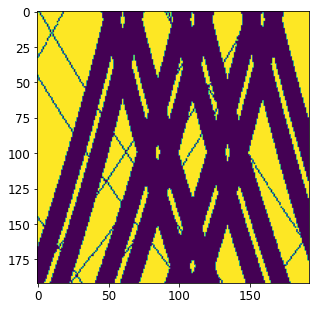

---------- frame 353--------------


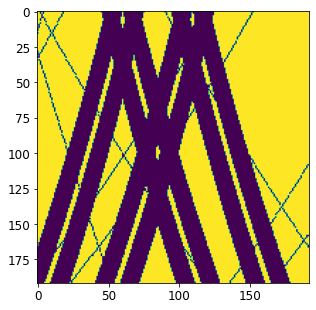

---------- frame 354--------------


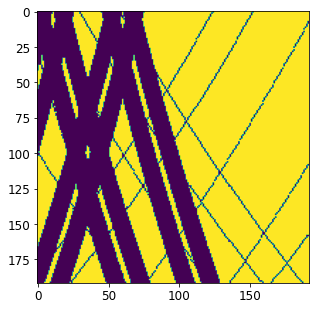

---------- frame 355--------------


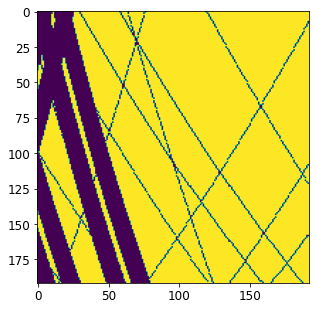

---------- frame 356--------------


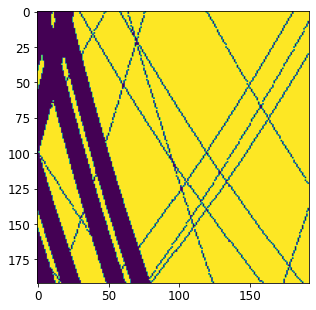

---------- frame 357--------------


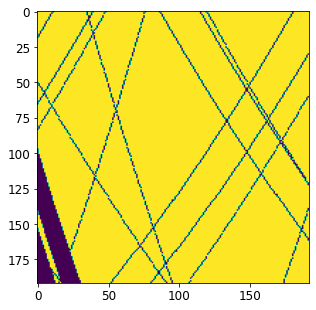

---------- frame 358--------------


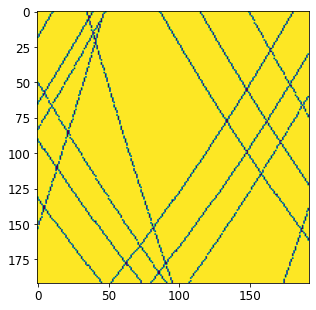

---------- frame 359--------------


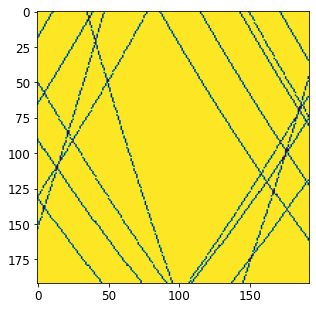

---------- frame 360--------------


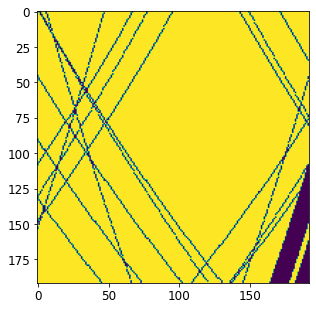

---------- frame 361--------------


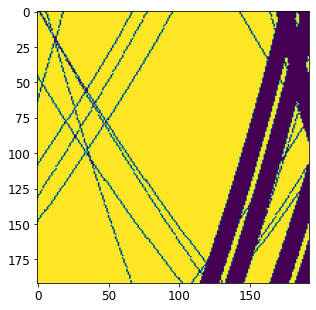

---------- frame 362--------------


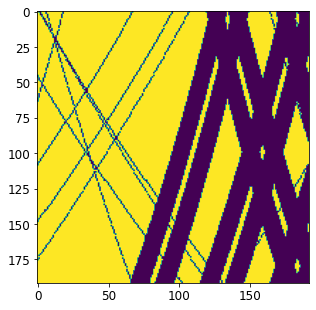

---------- frame 363--------------


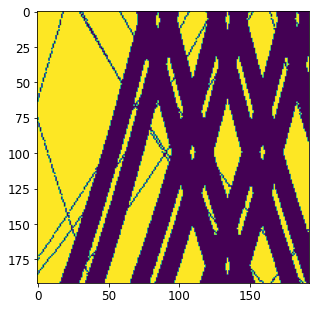

---------- frame 364--------------


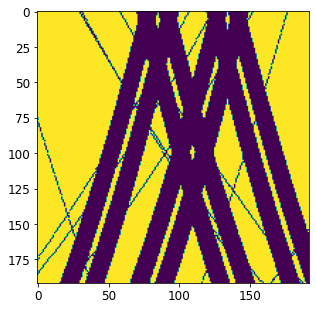

In [44]:
for f in range(len_video):
    print(f'---------- frame {f}--------------')

    plt.figure(figsize=(5,5))

    plt.imshow(masks[0][f][0].cpu())
    plt.show()

---------- frame 193--------------
NRMSE : 0.42284764200559755


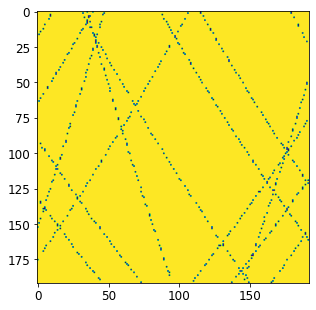

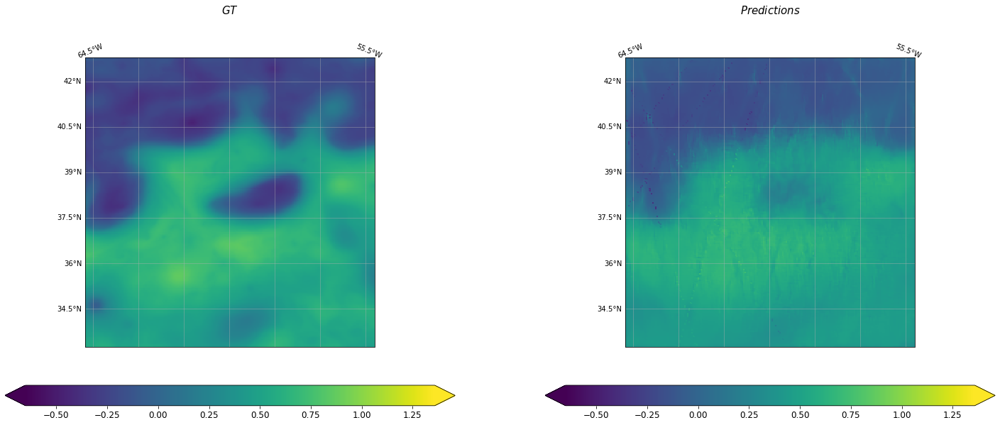

---------- frame 194--------------
NRMSE : 0.42486649510153096


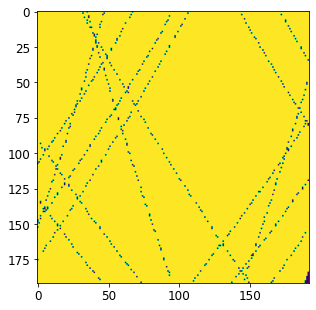

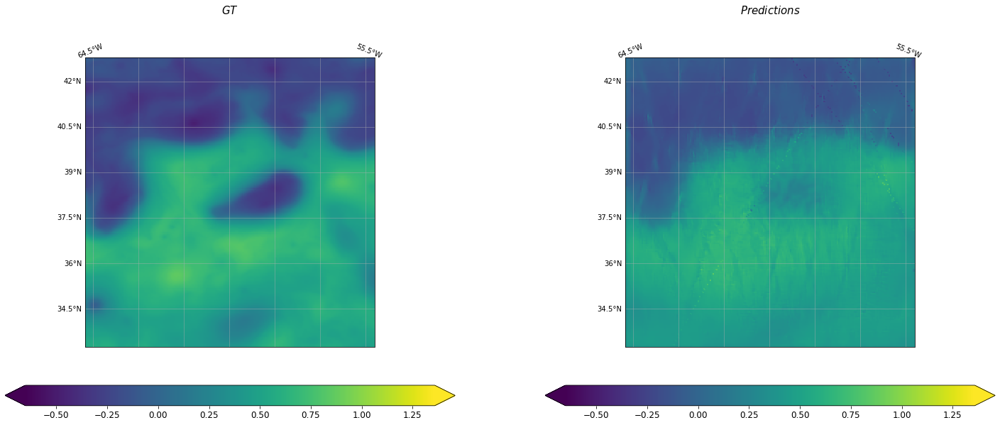

---------- frame 203--------------
NRMSE : 0.400216106853254


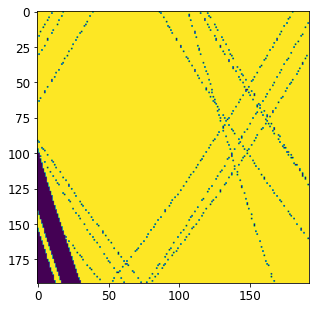

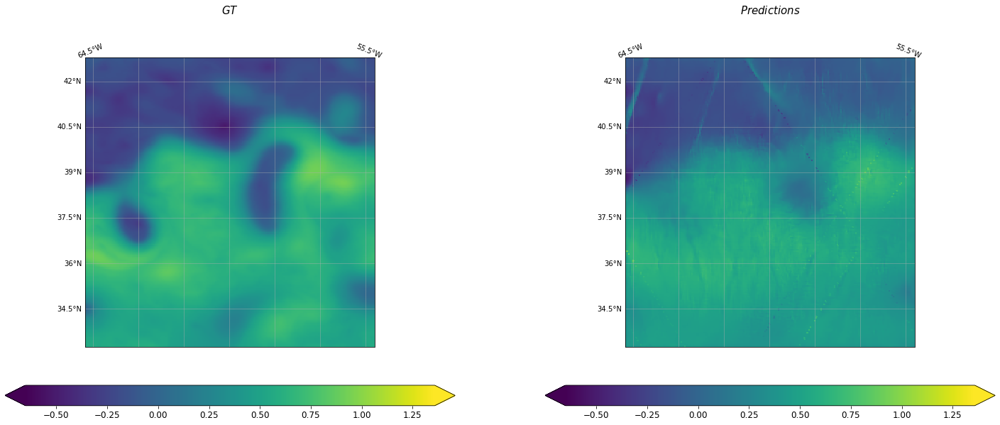

---------- frame 204--------------
NRMSE : 0.4414122078979433


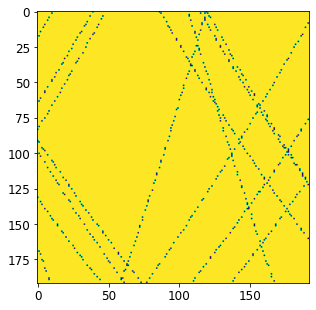

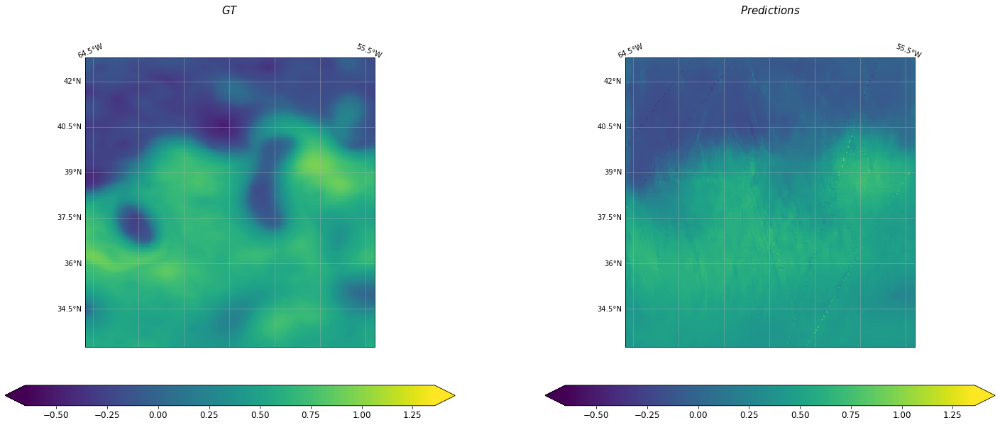

---------- frame 205--------------
NRMSE : 0.4092062814793008


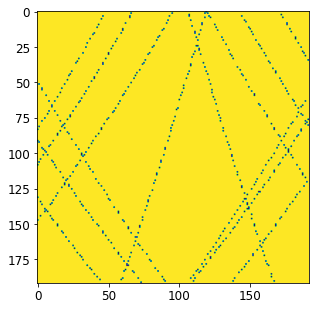

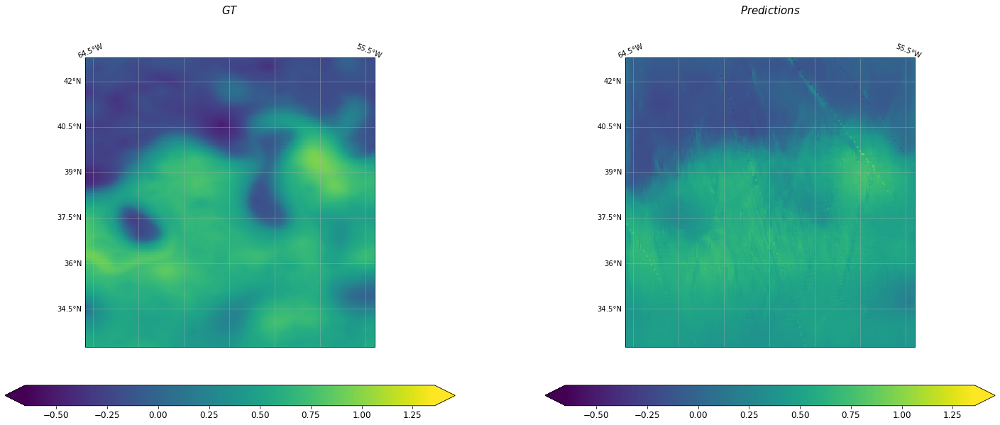

---------- frame 227--------------
NRMSE : 0.4218973558056989


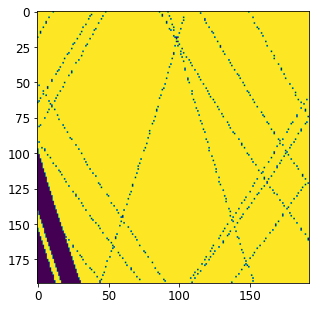

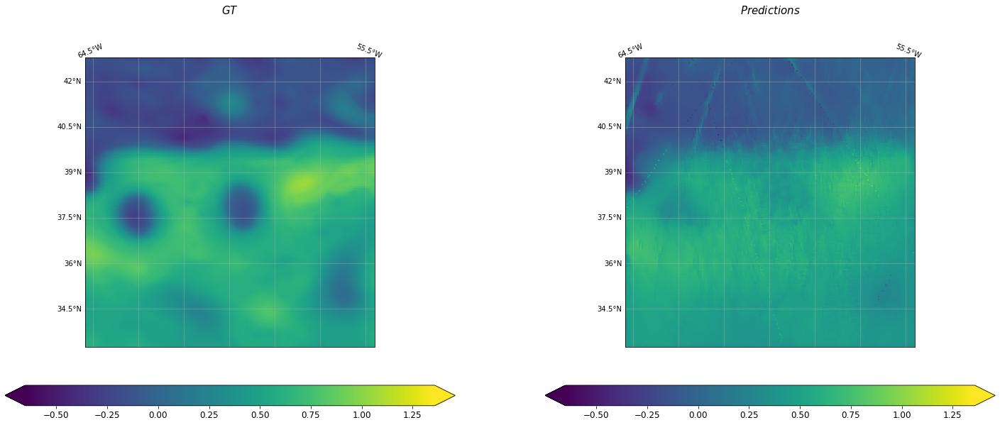

---------- frame 239--------------
NRMSE : 0.40972060456006865


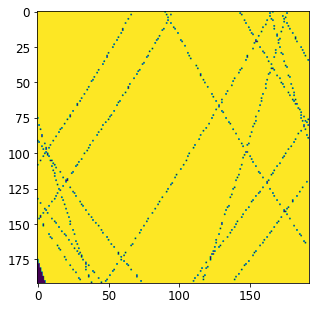

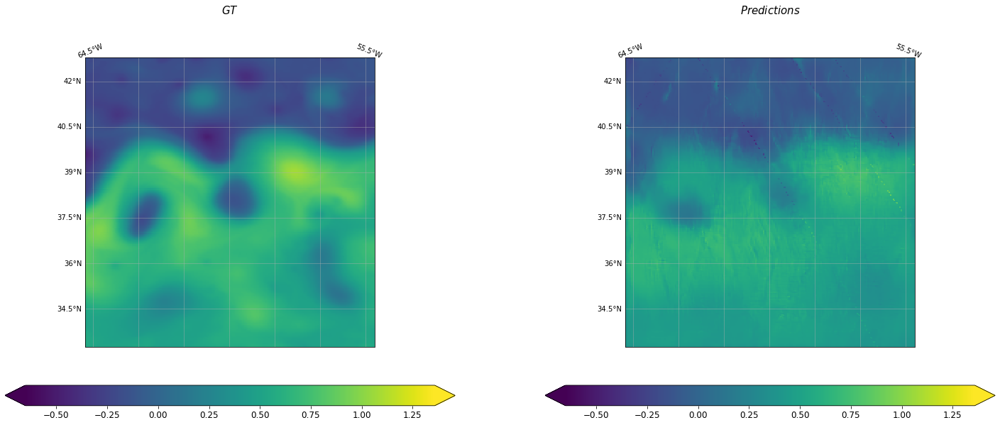

---------- frame 240--------------
NRMSE : 0.4018207632803844


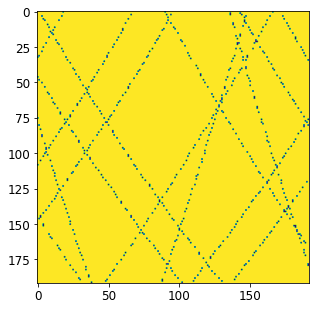

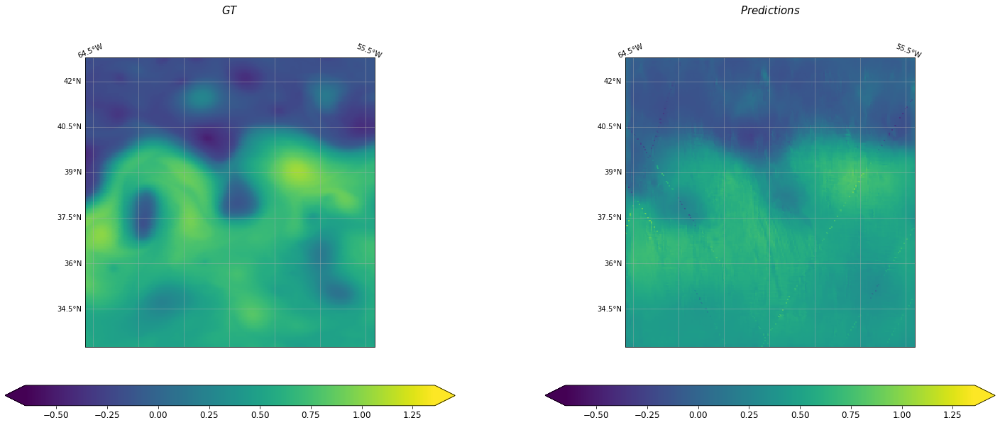

---------- frame 241--------------
NRMSE : 0.4175169789596345


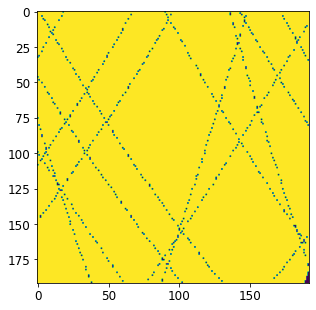

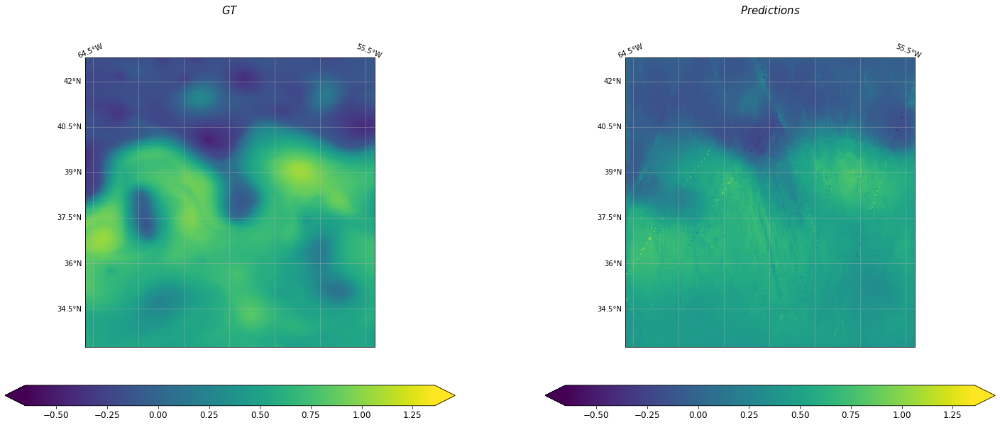

---------- frame 250--------------
NRMSE : 0.4462697587633683


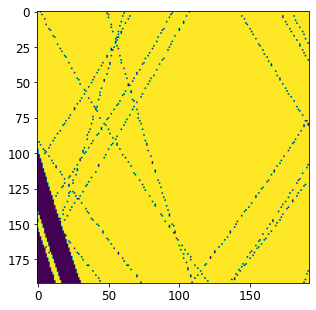

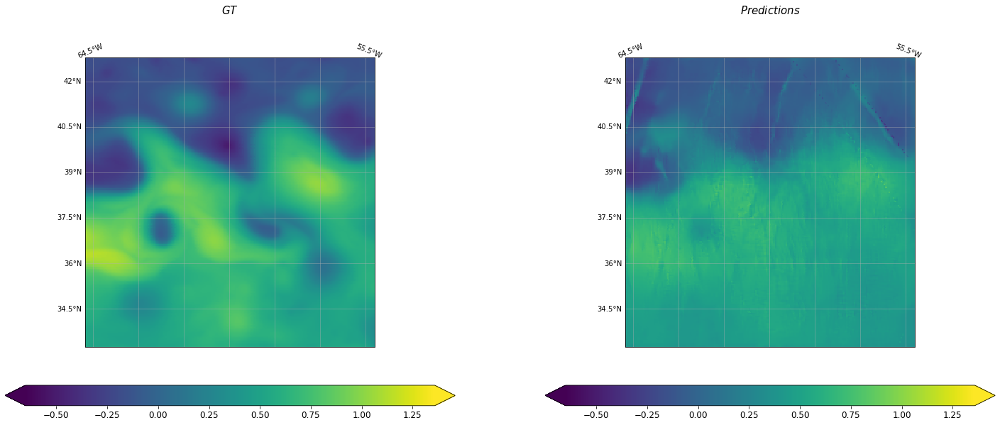

---------- frame 251--------------
NRMSE : 0.4254818227299717


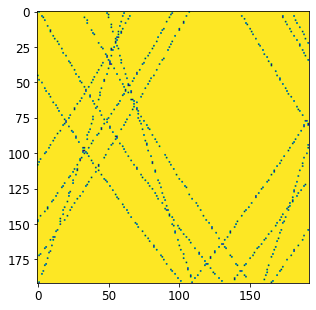

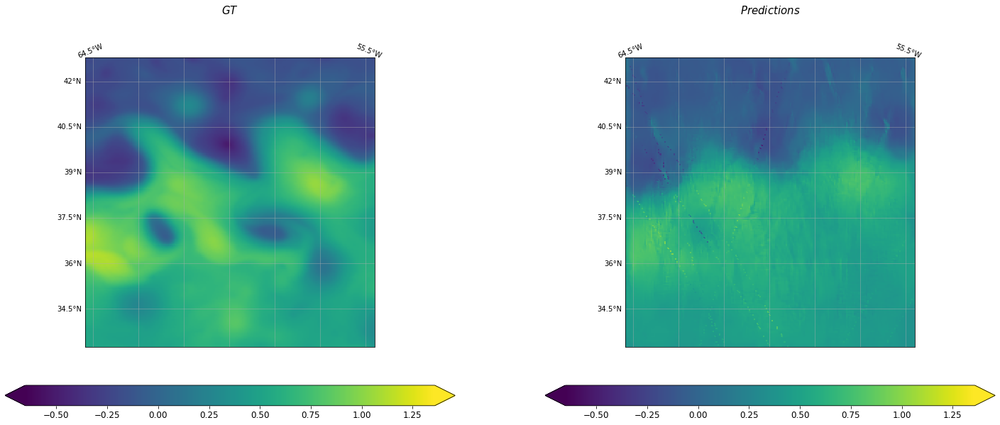

---------- frame 252--------------
NRMSE : 0.42673558836502423


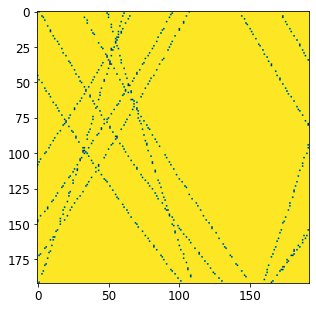

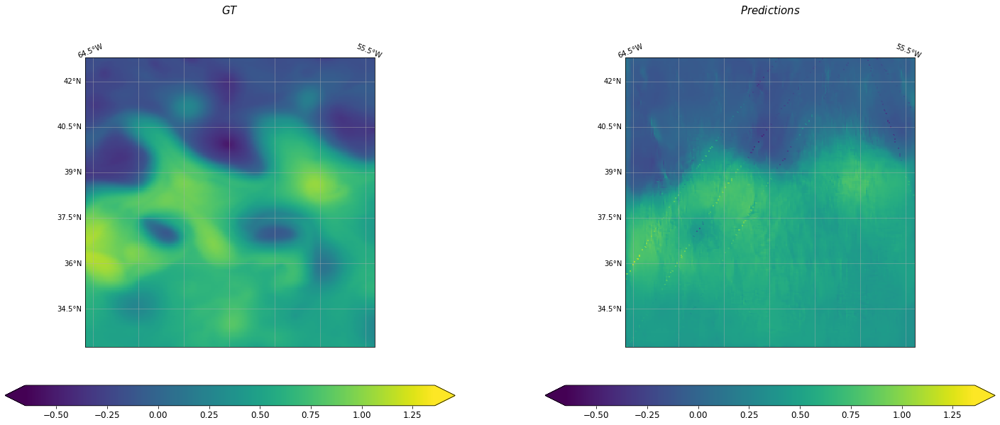

---------- frame 253--------------
NRMSE : 0.4132899607257619


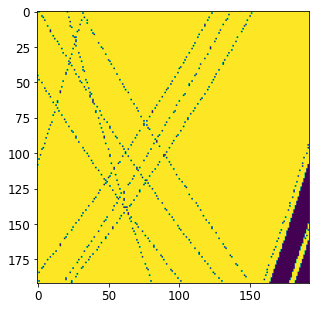

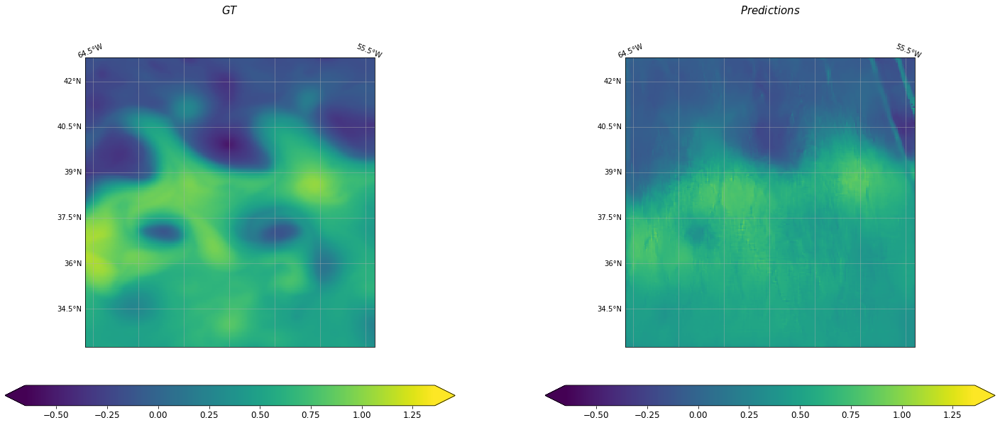

---------- frame 261--------------
NRMSE : 0.4098528681324754


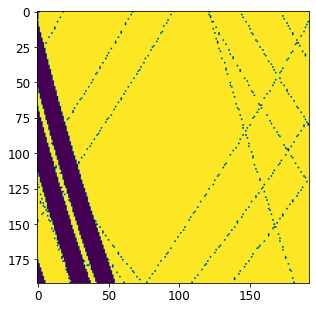

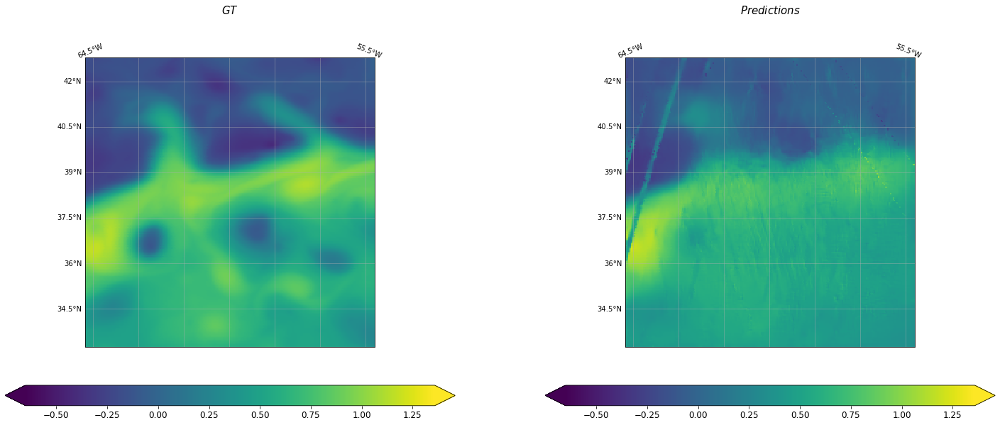

---------- frame 263--------------
NRMSE : 0.42752933105264496


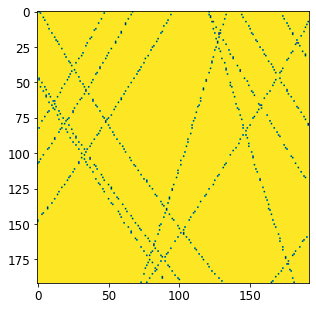

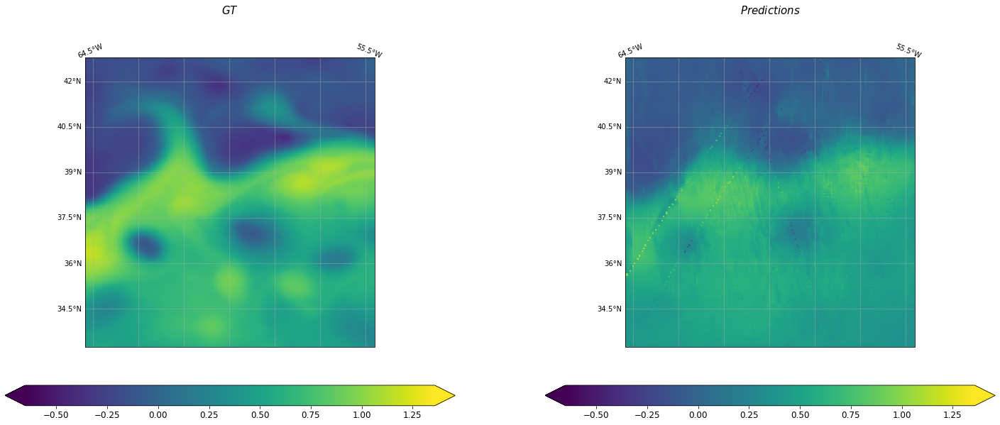

---------- frame 264--------------
NRMSE : 0.4406132895938505


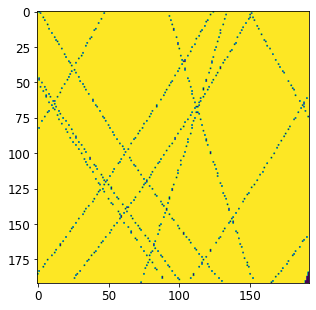

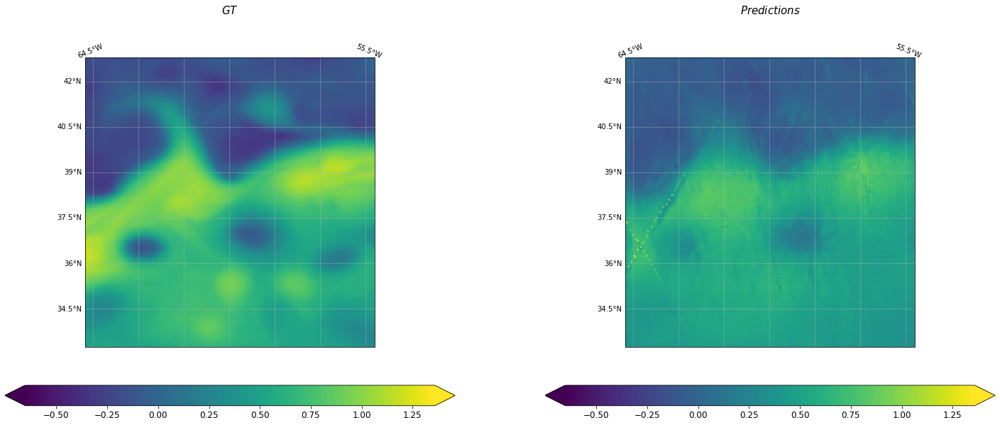

---------- frame 273--------------
NRMSE : 0.42186447905516566


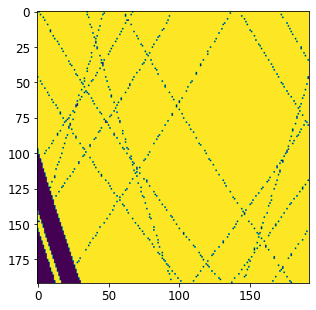

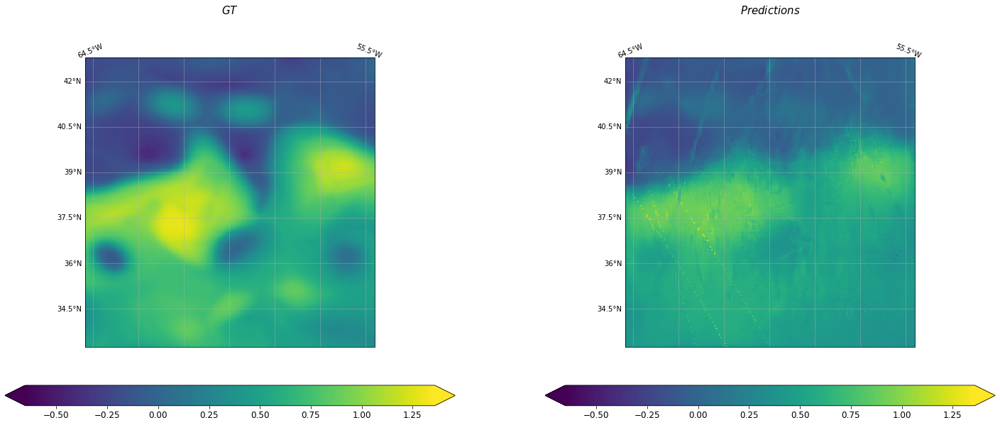

---------- frame 274--------------
NRMSE : 0.4214191080851376


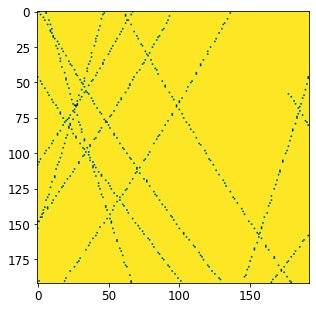

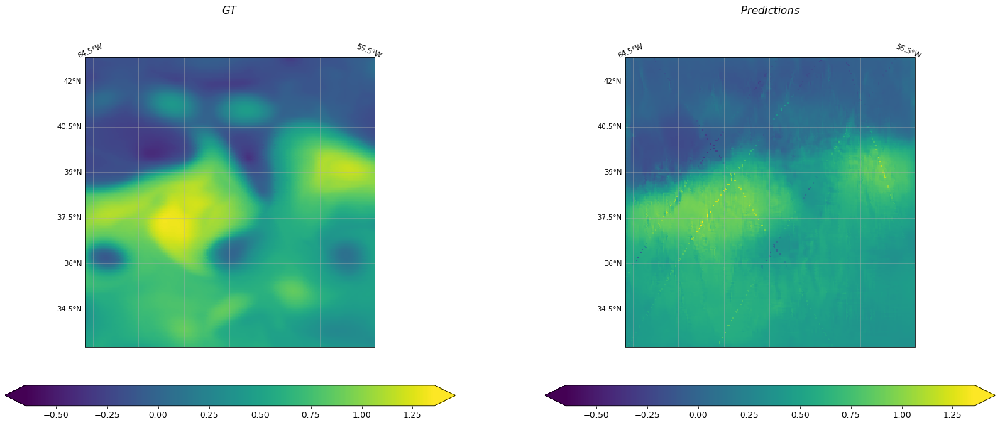

---------- frame 275--------------
NRMSE : 0.42402920308415953


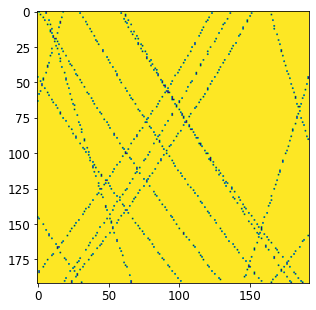

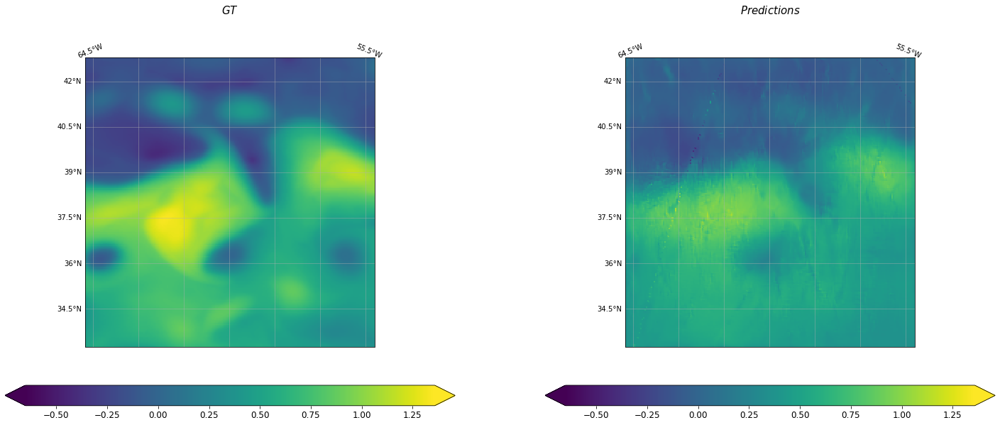

---------- frame 276--------------
NRMSE : 0.4089109928179925


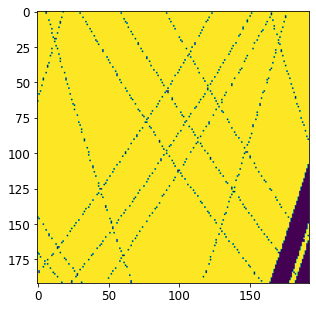

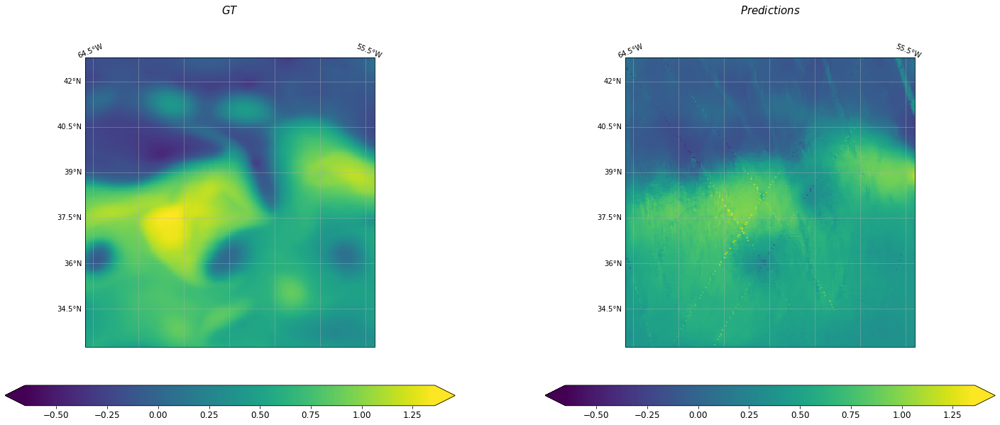

In [41]:
for frame in np.where(nrmse>0.40)[0][:20]:
    print(f'---------- frame {frame}--------------')
    print(f'NRMSE : {nrmse[frame]}')
    plt.figure(figsize=(5,5))
    plt.imshow(masks[0][frame][0].cpu())

    fig, ax = plt.subplots(1,2,squeeze=False,
                            subplot_kw=dict(projection=ccrs.PlateCarree(central_longitude=0.0)))

    plot(ax,0,0,lon,lat,gt[frame], r"$GT$",\
                 extent=extent,cmap='viridis',vmin=minn,vmax=maxx)

    plot(ax,0,1,lon,lat,prediction_ssh[frame], r"$Predictions$",\
                 extent=extent,cmap='viridis',vmin=minn,vmax=maxx)
    plt.show()

---------- frame 0--------------
Performance : 0.26619676986113994


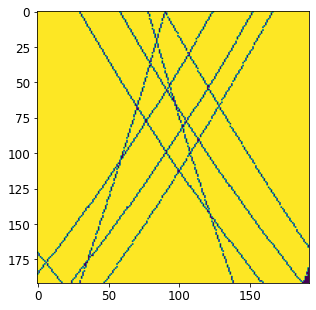

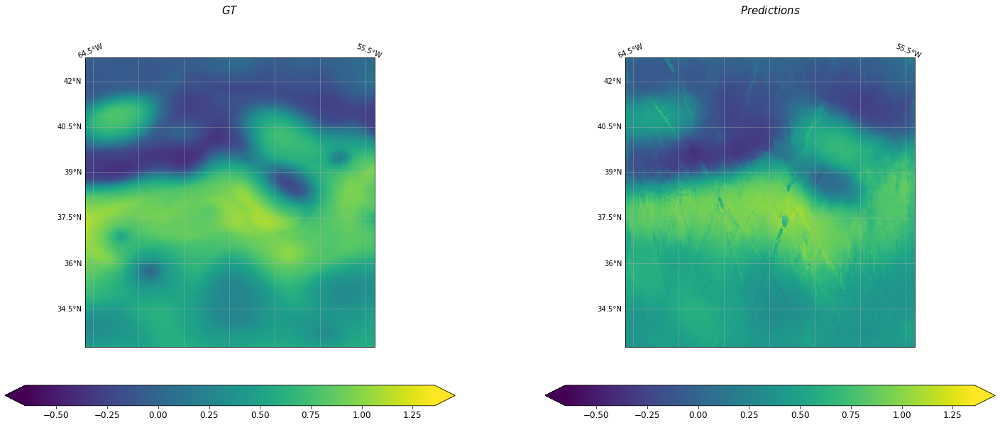

---------- frame 1--------------
Performance : 0.24200372953229374


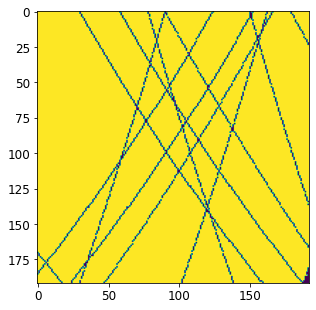

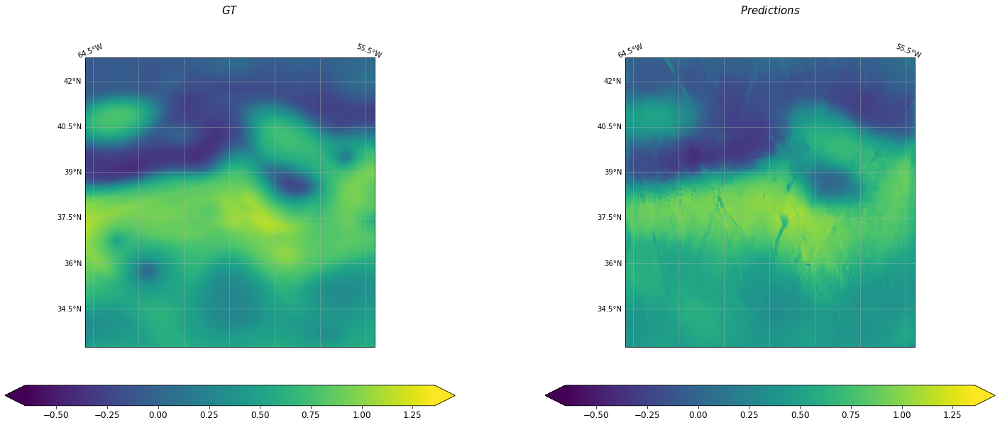

---------- frame 2--------------
Performance : 0.19423126734432983


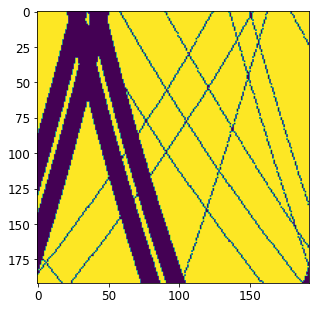

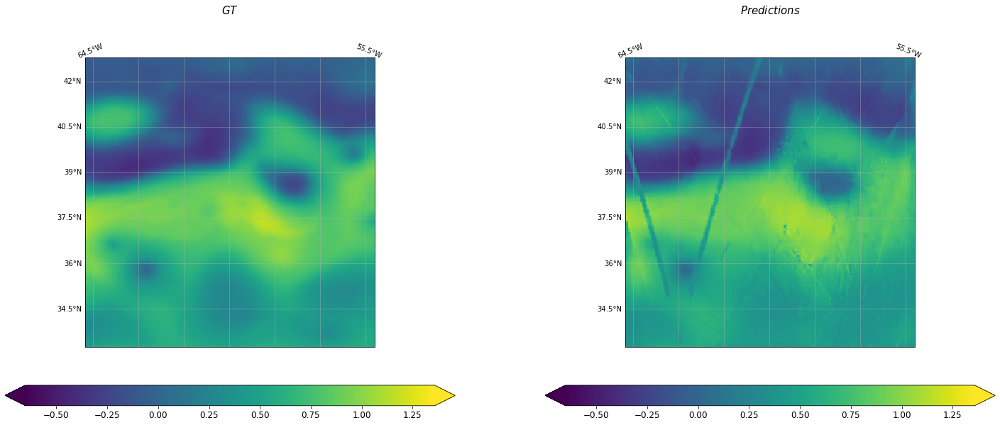

---------- frame 3--------------
Performance : 0.18381305206533613


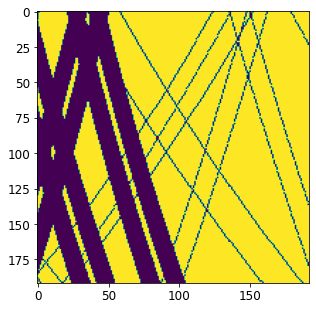

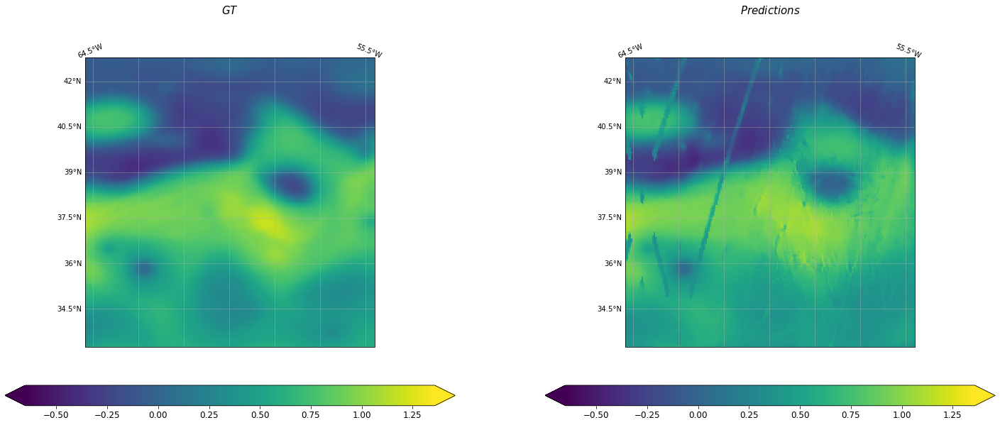

---------- frame 4--------------
Performance : 0.19186865734197583


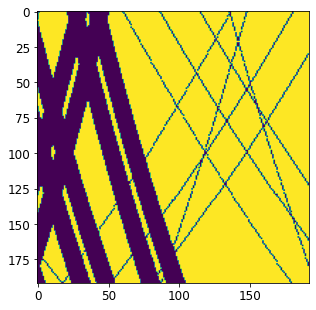

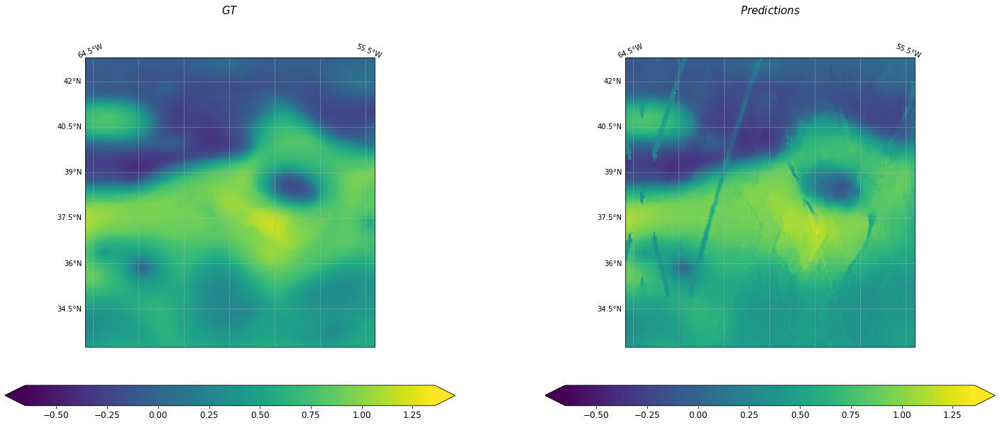

---------- frame 5--------------
Performance : 0.18889320143658173


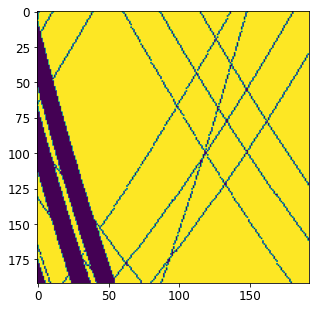

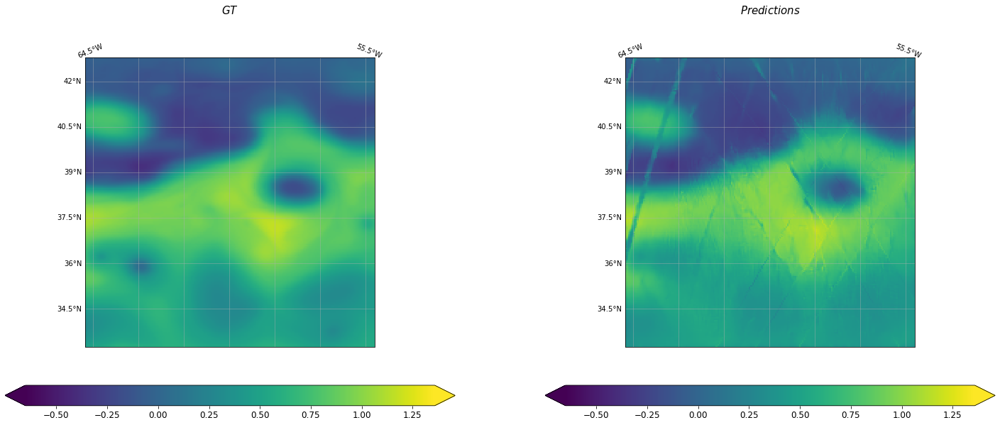

---------- frame 6--------------
Performance : 0.22755221765293773


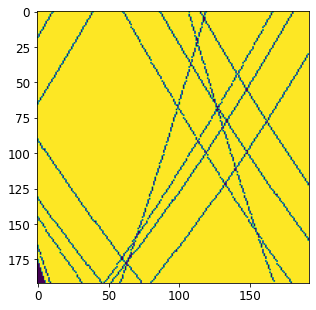

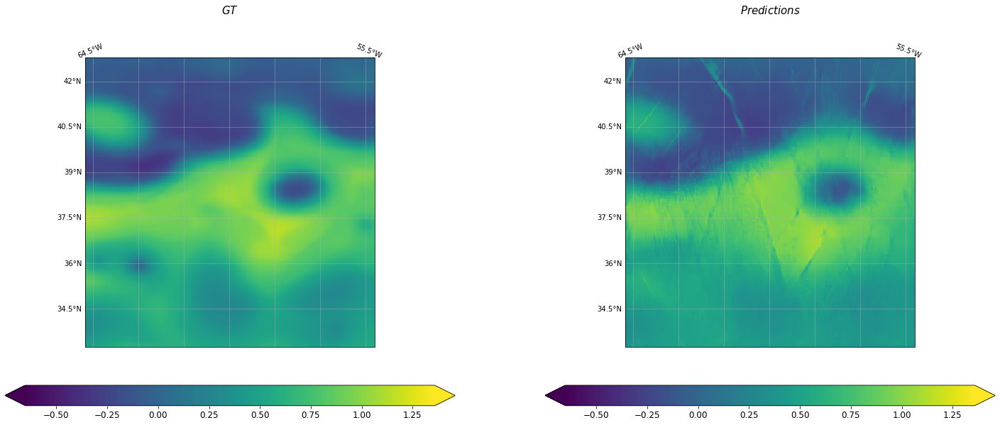

---------- frame 7--------------
Performance : 0.23884741579277588


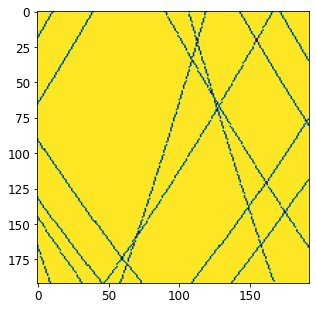

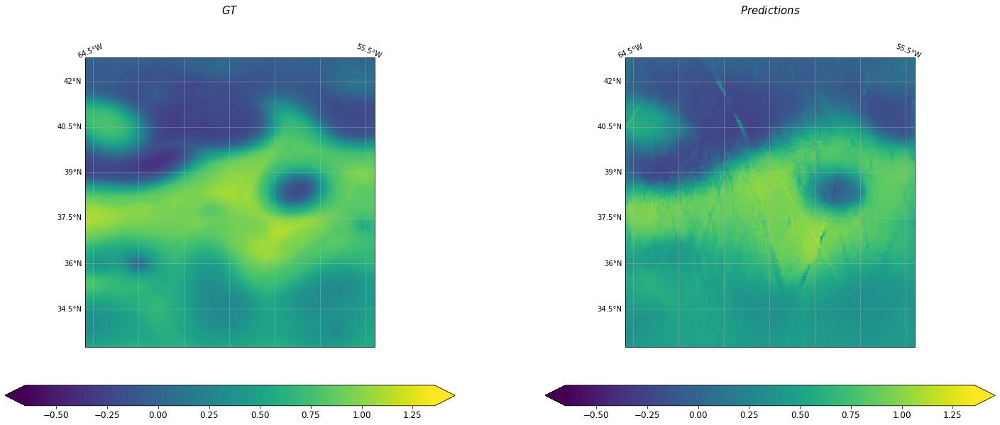

---------- frame 8--------------
Performance : 0.2147206800896755


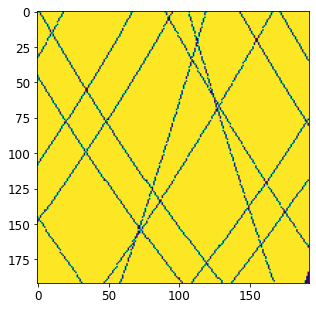

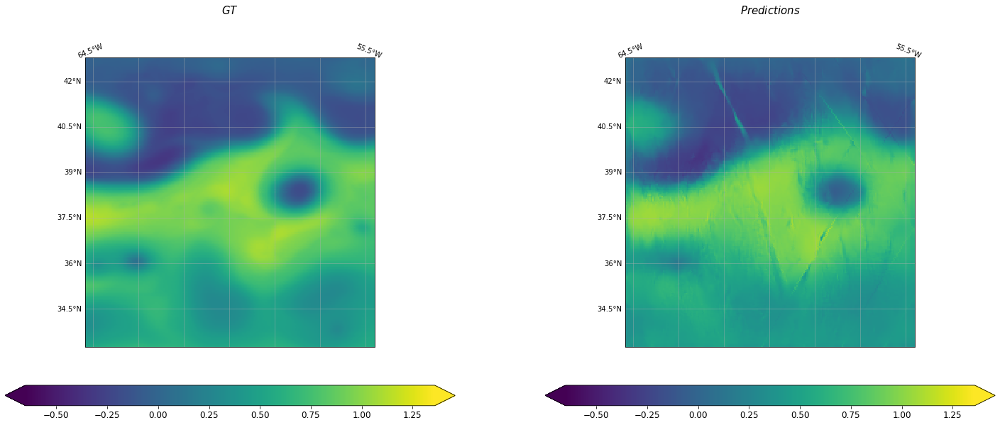

---------- frame 9--------------
Performance : 0.20806054038419963


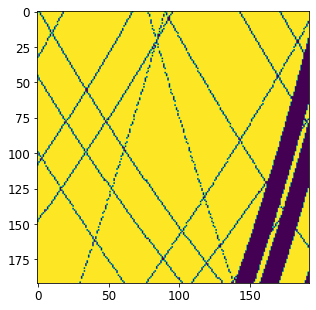

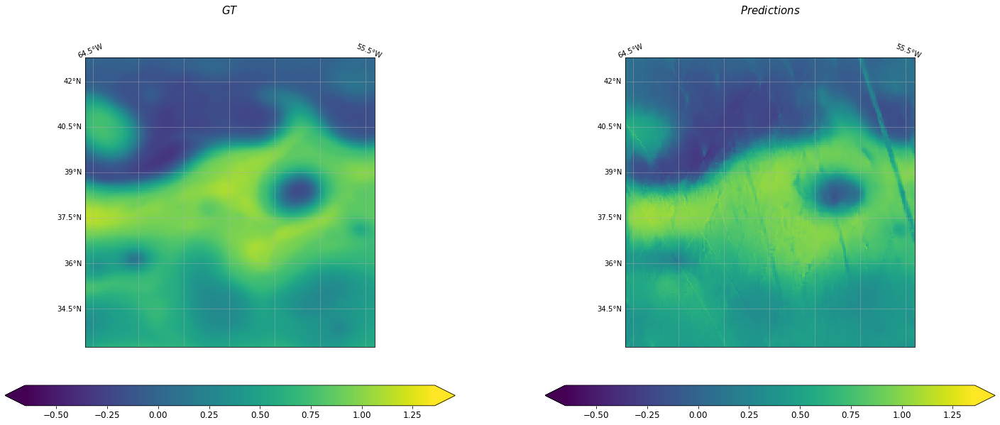

---------- frame 10--------------
Performance : 0.19832673888105526


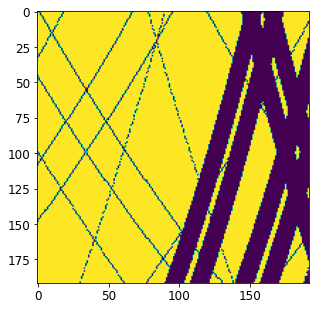

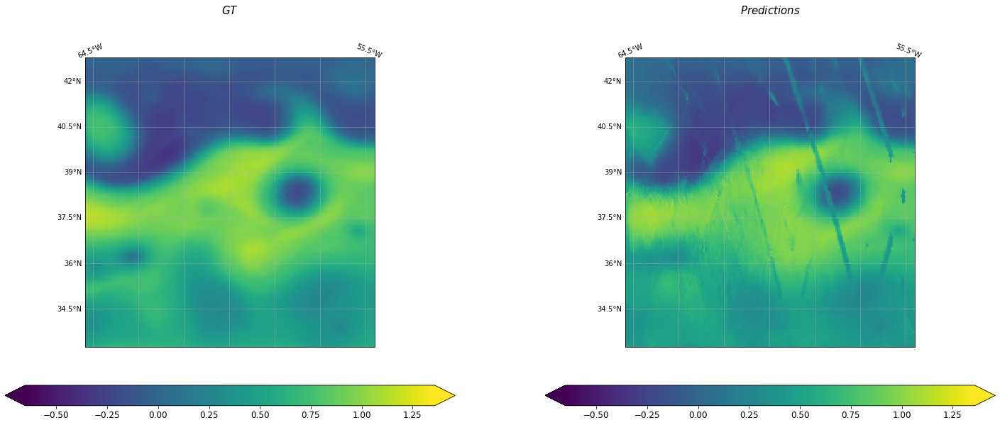

---------- frame 11--------------
Performance : 0.23286750805435671


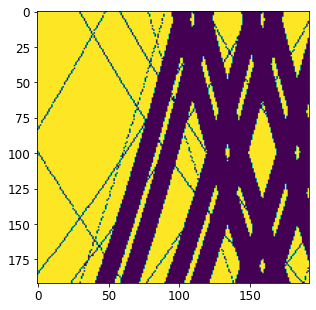

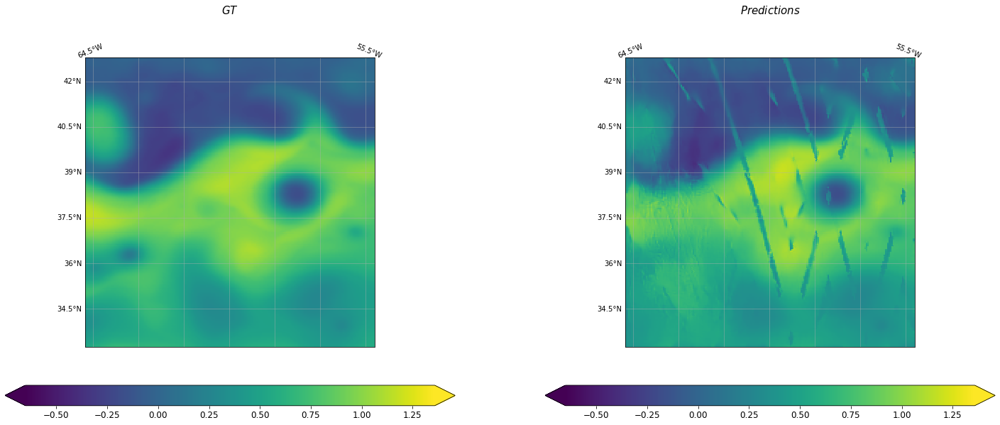

---------- frame 12--------------
Performance : 0.22145492496231836


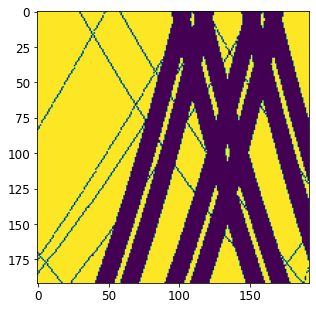

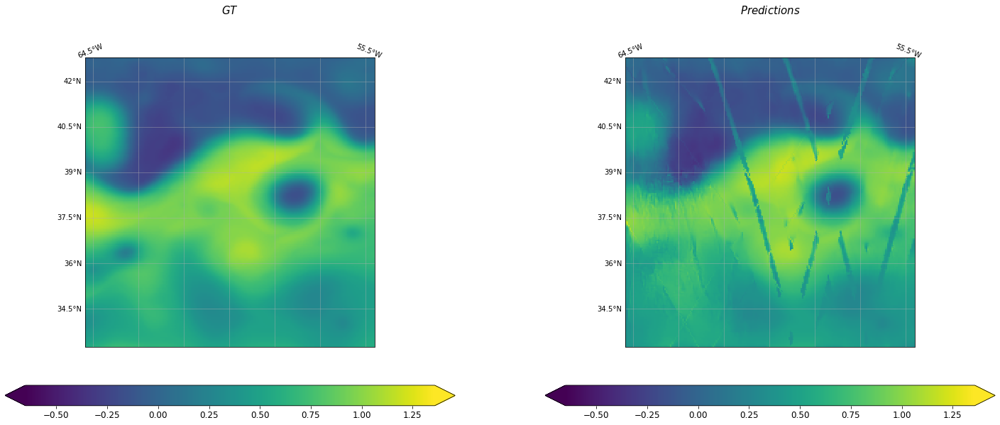

---------- frame 13--------------
Performance : 0.2084499702965952


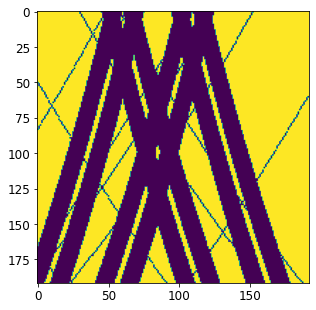

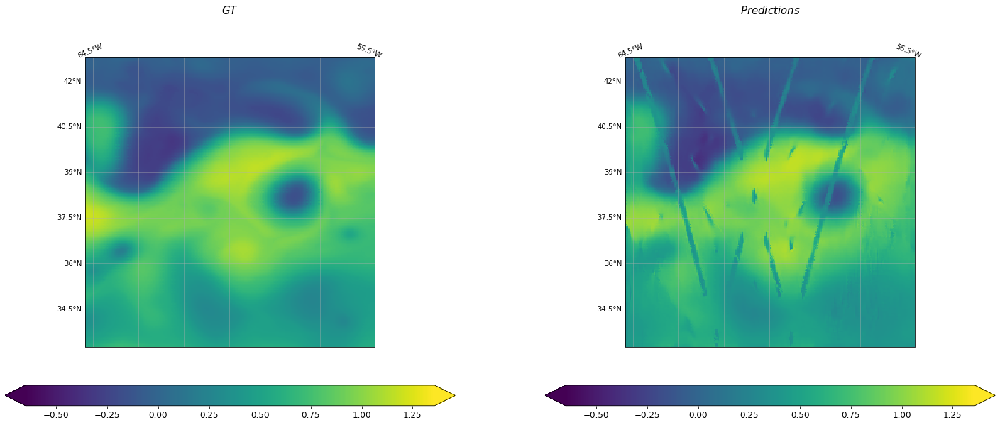

---------- frame 14--------------
Performance : 0.22397664041876286


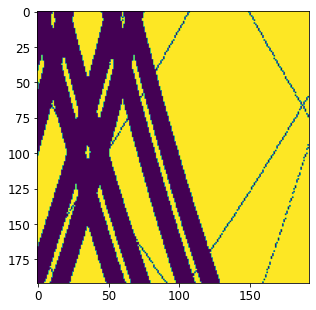

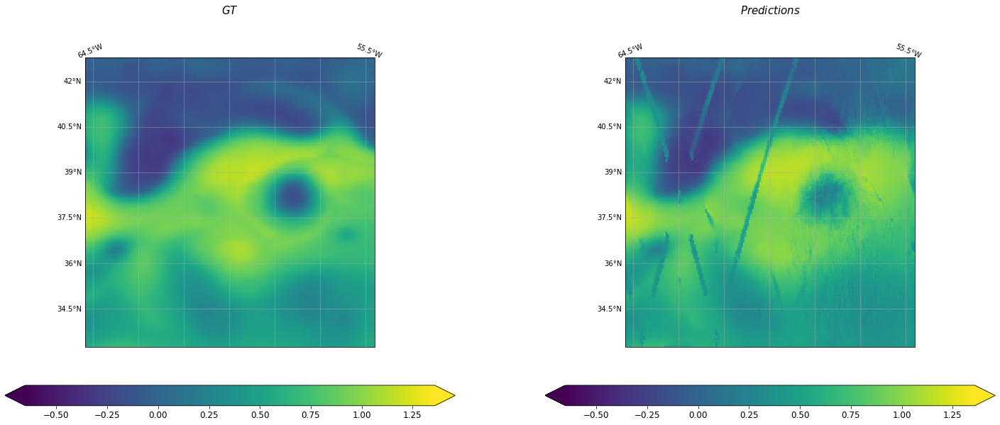

---------- frame 15--------------
Performance : 0.18940989177000472


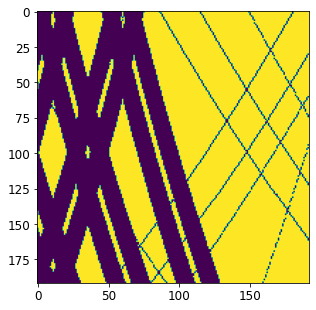

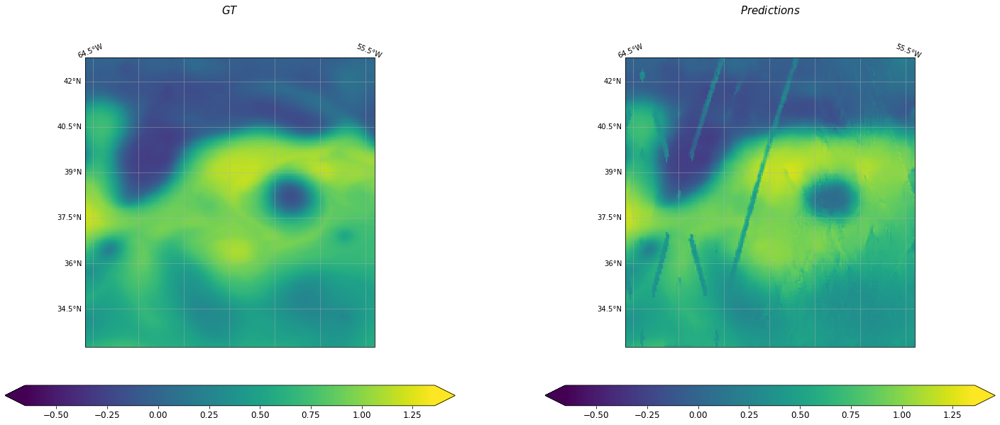

---------- frame 16--------------
Performance : 0.21928973187554499


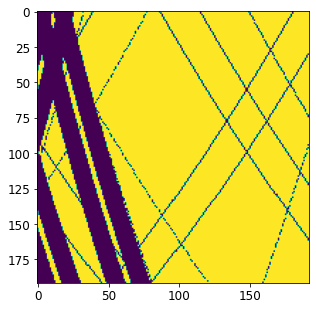

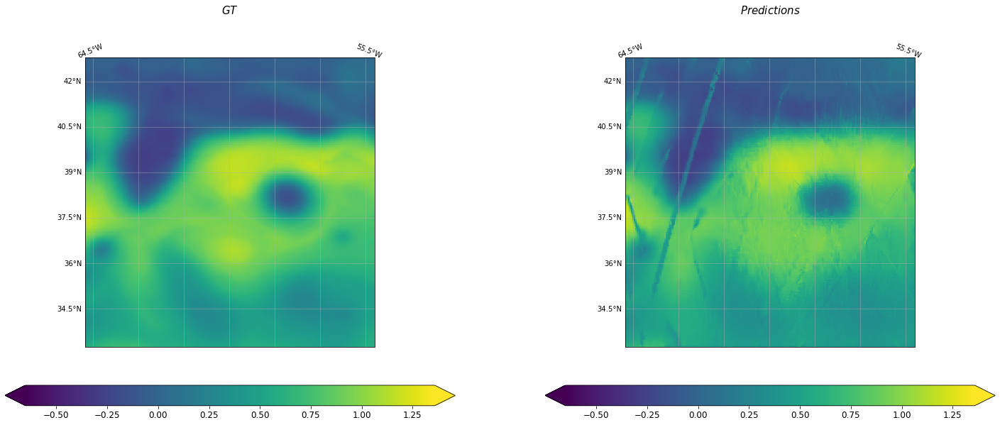

---------- frame 17--------------
Performance : 0.2368698506140206


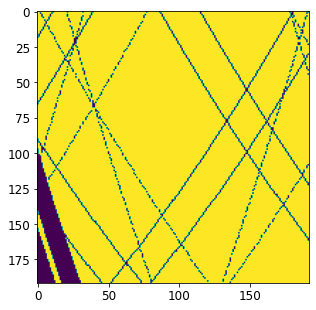

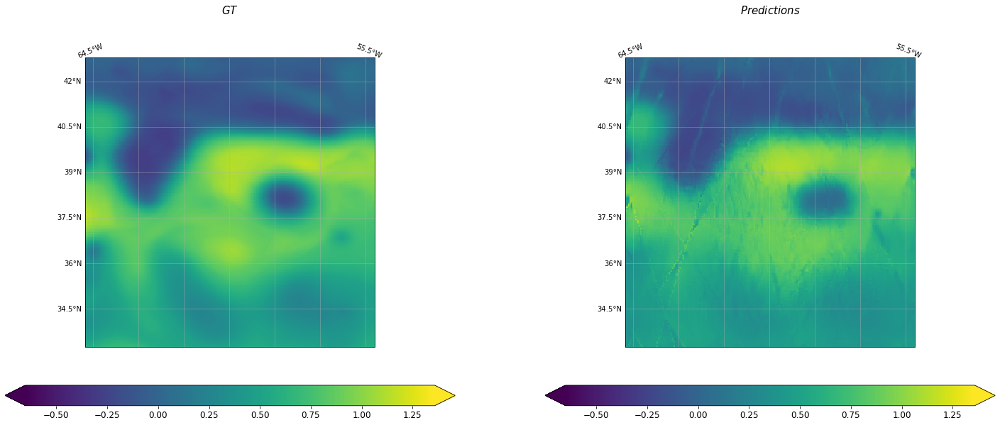

---------- frame 18--------------
Performance : 0.3245770151732249


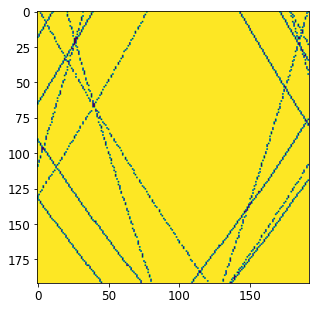

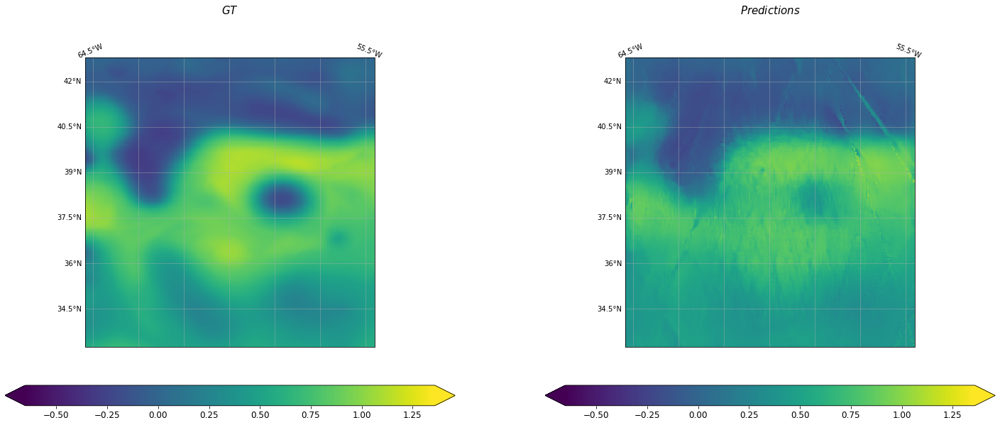

---------- frame 19--------------
Performance : 0.2767090662812416


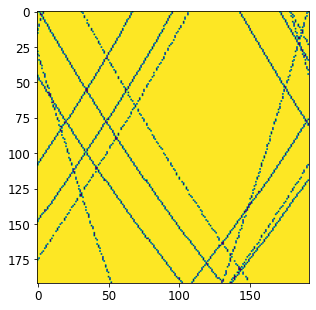

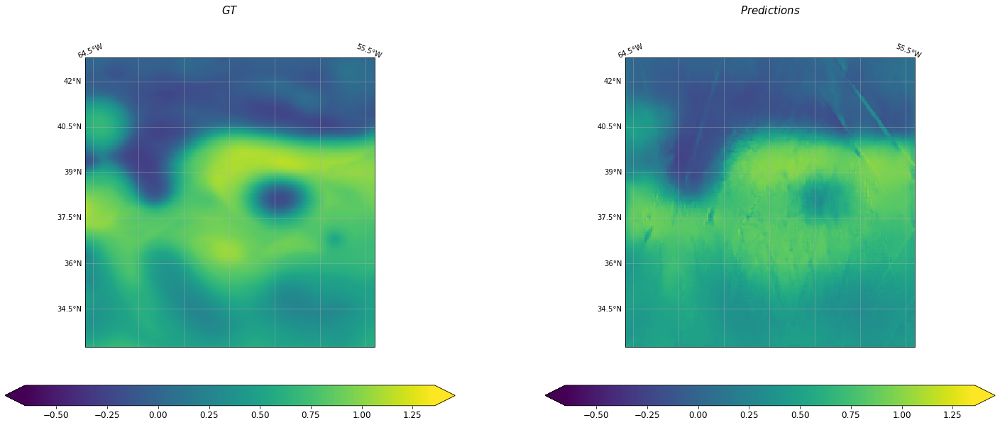

In [40]:
for frame in np.where(nrmse>0.05)[0][:20]:
    print(f'---------- frame {frame}--------------')
    print(f'Performance : {nrmse[frame]}')

    plt.figure(figsize=(5,5))
    plt.imshow(masks[0][frame][0].cpu())

    fig, ax = plt.subplots(1,2,squeeze=False,
                            subplot_kw=dict(projection=ccrs.PlateCarree(central_longitude=0.0)))

    plot(ax,0,0,lon,lat,gt[frame], r"$GT$",\
                 extent=extent,cmap='viridis',vmin=minn,vmax=maxx)

    plot(ax,0,1,lon,lat,prediction_ssh[frame], r"$Predictions$",\
                 extent=extent,cmap='viridis',vmin=minn,vmax=maxx)
    plt.show()